# Imports

In [1]:
import numpy as np
import pandas as pd
from matplotlib.patches import Patch
import itertools
import pickle
from matplotlib import pyplot as plt
import datetime
from scipy import optimize
import sys
sys.path.append('../SEIR_full/')
sys.path.append('..')
import SEIR_full as mdl
import SEIR_full.model_class as mdl
import SEIR_full.calibration as mdl
import datetime as dt
from scipy.stats import poisson
from scipy.stats import binom
import copy

In [2]:
plt.style.use('dean_style.conf')

In [3]:
with (open('../Data/parameters/indices.pickle', 'rb')) as openfile:
    ind = pickle.load(openfile)

# Big Loop for total calibration:

In [4]:
def load_data(ind, region_250_to_30, region_age_250_to_30):
    first = pd.Timestamp('2020-03-03')
    last = pd.Timestamp('2020-05-01')
    tot = pd.read_csv('../Data/sick/all_tests_by_age_county.csv')
    pos = pd.read_csv('../Data/sick/smooth_sick_by_age_calibration_county.csv')
    pos.set_index('Unnamed: 1', inplace=True)
    pos.columns = ['county'] + list(pos.columns)[1:]
    pos.sort_values(by='county', inplace=True)
    pos = pos.pivot(columns='county')
    pos.columns = pos.columns.swaplevel(0, 1)
    pos = pos.reindex(
        pd.MultiIndex.from_product([region_250_to_30.keys(), ind.A.values()]),
        axis=1)
    pos.index = pd.to_datetime(pos.index)
    pos = pos.reindex(
        pd.date_range(pos.index.values.min(), pos.index.values.max(),
                      freq='d'), fill_value=0)
    pos.fillna(0, inplace=True)

    begining = pos.index.values.min()
    ending = pos.index.values.max()
    pos = pos.reindex(pd.date_range(begining, ending, freq='d'), fill_value=0)

    # Shifting data by 5 days for fit
    pos_0303 = pos.loc[
               '2020-03-03':].copy()  # starting the fit from March 3rd 2020

    shift_date_list = pd.date_range('2020-02-27', freq='d',
                                    periods=pos_0303.shape[0])

    pos_0303['shift_date'] = shift_date_list

    pos_0303.set_index('shift_date', inplace=True)
    data = np.ndarray((2, len(pos_0303), len(region_age_250_to_30.keys())))
    data[0] = np.zeros(
        pos_0303.shape)  # insert the tested positive specimens only for relevant calibration period
    data[1] = pos_0303

    return (data, pos_0303)


def show_calibration_param(
        data_color,
        model_color,
        ind,
        scen_idxs=[1],
        phases=['-'],
        save_name='',
        start_sim='2020-02-20',
        no_mobility=False,
        no_haredim=False,
    ):
    print('Results for ', scen_idxs, ' and for seasonality ', phases, ':')
    # parameters:
    # load mapper:
    # loads mapping 250 to 20:
    with open(
            '../Data/division_choice/250_to_30/250_to_30_region_mapper.pickle',
            'rb') as pickle_in:
        region_250_to_30 = pickle.load(pickle_in)
    with open(
            '../Data/division_choice/250_to_30/250_to_30_region_age_mapper.pickle',
            'rb') as pickle_in:
        region_age_250_to_30 = pickle.load(pickle_in)
    with open(
            '../Data/division_choice/250_to_30/250_to_30_region_ga_mapper.pickle',
            'rb') as pickle_in:
        region_ga_250_to_30 = pickle.load(pickle_in)

    # get the sick data:
    data, pos = load_data(ind, region_250_to_30, region_age_250_to_30)

    start_data = pos.index[0]
    end_data = pos.index[-1]
    # fit params
    date_lst = pd.date_range(start_sim, end_data)
    res_mdl_ml = {}
    for scen_idx, phase in itertools.product(scen_idxs, phases):
        if (phase is None) or (phase == '-'):
            seasonality = False
            phi = 0
        else:
            seasonality = True
            phi = phase

        cal_parameters = pd.read_pickle(
            '../Data/calibration/calibration_dict.pickle')
        if no_haredim:
            cal_tpl = (scen_idx, phase, 'no_haredim')
        elif no_mobility:
            cal_tpl = (scen_idx, phase, 'no_mobility')
        else:
            cal_tpl = (scen_idx, phase)
        model = mdl.Model_behave(
            ind=ind,
            beta_j=cal_parameters[ind.cell_name][cal_tpl]['beta_j'],
            theta=cal_parameters[ind.cell_name][cal_tpl]['theta'],
            beta_behave=cal_parameters[ind.cell_name][cal_tpl][
                'beta_behave'],
            scen=mdl.num2scen(scen_idx),
            seasonality=seasonality,
            phi=phi,
        )
        if no_mobility:
            C = mdl.C_const
            sh = {}
            for key in mdl.stay_home_idx.keys():
                sh[key] = [np.ones_like(mdl.stay_home_idx[key][0])] * len(
                    mdl.stay_home_idx[key])
        else:
            C = mdl.C_calibration
            sh = mdl.stay_home_idx
        loss = model.calc_loss(
            (model.beta_j[0],
             model.beta_j[3],
             model.beta_j[5],
             model.beta_j[7],
             model.theta,
             model.beta_behave,),
            data,
            C,
            sh,
            mdl.not_routine,
            date_lst,
            start_data,
            end_data,
            'MSE',
            factor=1,
            mapper=region_age_250_to_30,
        )

        # generate fitting graph:
        res_mdl_ml[(scen_idx, phase)] = model.predict(
            C=C,
            days_in_season=len(date_lst),
            stay_home_idx=sh,
            not_routine=mdl.not_routine,
        )
#     fig, axs = plt.subplots(ncols=2, nrows=2)
    fig = plt.figure(constrained_layout=True, figsize=(15,15))
    widths = [1, 2]
    heights = [2, 1]
    gs = fig.add_gridspec(
        ncols=2, 
        nrows=2, 
        width_ratios=widths,
        height_ratios=heights,
    )
    gs.update(wspace=0.2, hspace=0.18)
    axbig = fig.add_subplot(gs[0, :])
    
    
    fig, axbig = plot_country_cal(
        data_color,
        model_color,
        pd.DataFrame(data[1]),
        res_mdl_ml,
        scen_idxs,
        phases,
        {
#             3: '69',
            1: '85',
            4: '89',
            2: '93',
        },
        [
            '-',
            '*',
            ':',
        ],
        date_lst,
        mdl.pop_israel,
        start=start_data,
        end=end_data,
        ax=axbig,
        fig=fig,
    )

    fig, ax = plot_age_cal(
        data_color,
        model_color,
        ind,
        pos,
        res_mdl_ml,
        scen_idxs,
        phases,
        {
#             3: '69',
            1: '85',
            4: '89',
            2: '93',
        },
        [
            '',
            '*',
            '.',
        ],
        fig.add_subplot(gs[1, 0]),
        fig,
    )
    
    fig, ax = plot_calibrated_model_region(
        data_color,
        model_color,
        ind,
        pos,
        res_mdl_ml,
        date_lst,
        {k: k for k in
                     region_250_to_30.keys()},
        scen_idxs,
        phases,
        {
#             3: '69',
            1: '85',
            4: '89',
            2: '93',
        },
        [
            '',
            '*',
            '.',
        ],
        start_data,
        end_data,
        region_250_to_30,
        region_ga_250_to_30,
        fig.add_subplot(gs[1, 1]),
        fig,
    )
    plt.tight_layout()
    plt.show()
    fig.savefig('../Data/figs/SIfig3_'+ save_name+ '.png', dpi=300, bbox_inches='tight', transparent=True)

In [5]:
import matplotlib.dates as mdates

def plot_country_cal(
        data_color,
        model_color,
        data,
        mdl_data,
        scen_idxs,
        phases,
        scen_names,
        line_styles,
        date_list,
        isr_pop,
        start='2020-03-20',
        end='2020-04-13',
        ax=None,
        fig=None,
    ):

    """ The function gets the results of the model and plot the model results and the data,
    on country level.
    Data format is of region-age
    :param data:
    :param mdl_data:
    :param date_list:
    :param start:
    :param end:
    :return:
    """

    #index to cut model's data
    start_idx = int(np.where(date_list == start)[0])
    end_idx = int(np.where(date_list == end)[0])

    # creating DF
    data_tot = data.sum(axis=1).to_frame()
    data_tot.columns = ['Data']
    model_data_cal = data_tot
    if len(phases)==1:
        for scen_idx in scen_idxs:
            model_data_cal['Model'+scen_names[scen_idx]] = mdl_data[(scen_idx, phases[0])]['new_Is'][start_idx:end_idx + 1,:].sum(axis=1)*isr_pop

    #Plot
    if ax is None:
        fig, ax = plt.subplots()
    ax.scatter(date_list[start_idx: end_idx + 1], data_tot['Data'], label = 'Data', c=data_color, s=40, marker='o')
    if len(phases)==1:
        for i, scen_idx in enumerate(scen_idxs):
            ax.plot(
                date_list[start_idx: end_idx + 1], 
                data_tot['Model'+scen_names[scen_idx]], 
#                 line_styles[i],
                label = 'Calibration for unreported cases: '+scen_names[scen_idx]+'%', 
                c=model_color[i], 
                linewidth=4,
            )
    ax.axis('on')
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.set_xlim(date_list[start_idx], date_list[end_idx])
    plt.gcf().autofmt_xdate()
    myFmt = mdates.DateFormatter('%d.%m')
    plt.gca().xaxis.set_major_formatter(myFmt)
    plt.xticks(rotation=0)
    plt.setp(ax.get_xticklabels(), fontsize=15)   
    plt.setp(ax.get_yticklabels(), fontsize=15) 
    plt.xlabel('Date', fontsize=20)
    plt.ylabel('Daily reported cases [#]', fontsize=20)
    ax.text(date_list[start_idx]-pd.Timedelta(6, unit='d'), 600, 'A', fontsize=25, weight = 'bold')
    ax.legend(frameon=False, fontsize=15, numpoints=4)
    if ax is None:
        fig.savefig('../Data/figs/fig3B.png', dpi=300, bbox_inches='tight', transparent=True)
        plt.show()
    return fig, ax

In [22]:
def plot_age_cal(
    data_color,
    model_color,
    ind,
    pos,
    res_mdl_ml,
    scen_idxs,
    phases,
    scen_names,
    line_styles,
    ax=None,
    fig=None,
    ):
    
    # plot age fit:
    age_cal = [
        ['0-4', '5-9', '10-19'],
        ['20-29', '30-39'],
        ['40-49', '50-59'],
        ['60-69', '70+'],
    ]
    age_name = [
        '0-19',
        '20-39',
        '40-59',
        '60+',
    ]
    age_pct = {}
    age_pct_data = []
    age_model = []
    data_age = (pos.sum(axis=0).unstack(level=0).sum(axis=1)) / (
        pos.sum(axis=0).unstack(level=0).sum(axis=1).sum())
    for age_list in age_cal:
        idx = []
        for age in age_list:
            idx += list(ind.age_dict[age])
        age_pct_data.append(
            100*data_age.loc[age_list].sum())
    if len(phases)==1:
        for scen_idx in scen_idxs: 
            age_pct['Model'+scen_names[scen_idx]] = []
            for age_list in age_cal:
                idx = []
                for age in age_list:
                    idx += list(ind.age_dict[age])
                age_pct['Model'+scen_names[scen_idx]].append(
                    100*res_mdl_ml[(scen_idx, phases[0])]['new_Is'][:, idx].sum()/
                    (res_mdl_ml[(scen_idx, phases[0])]['new_Is'][:, :].sum()))

    # set width of bar
    barWidth = 0.2
    # Set position of bar on X axis
    indexs = np.arange(len(age_pct_data))

    #Plot
    if ax is None:
        fig, ax = plt.subplots()
#     markerline, stemlines, baseline = ax.stem(
#         indexs-1.5*barWidth, 
#         age_pct_data, 
#         '-',
#         label = 'Data', 
#     )
#     plt.setp(baseline, 'alpha', 0, 'linewidth', 0)
#     plt.setp(stemlines, 'color', 'tab:red', 'linewidth', 20, 'linestyle', '-')
#     plt.setp(markerline, 'alpha', 0)
    
    ax.bar(indexs-1.5*barWidth, age_pct_data, color=data_color, width=barWidth,
            edgecolor='white', label='Data')
    if len(phases)==1:
        for i, scen_idx in enumerate(scen_idxs):
#             markerline, stemlines, baseline = ax.stem(
#                 indexs+barWidth*(i-0.5), 
#                 age_pct['Model'+scen_names[scen_idx]],
#                 line_styles[i],
#                 label = 'Calibration for unreported cases: '+scen_names[scen_idx]+'%', 
#             )
#             plt.setp(baseline, 'alpha', 0, 'linewidth', 0)
#             plt.setp(stemlines, 'color', 'tab:blue', 'linewidth', 20, 'linestyle', line_styles[i])
#             plt.setp(markerline, 'alpha', 0)
            
            ax.bar(
                indexs+barWidth*(i-0.5),
                age_pct['Model'+scen_names[scen_idx]],
                color=model_color[i],
                width=barWidth,
                edgecolor='white',
#                 hatch=line_styles[i],
                label = 'Calibration for unreported cases: '+scen_names[scen_idx]+'%', 
            )
    
    ax.set_xticks(indexs)
    ax.set_xticklabels(age_name)
    ax.axis('on')
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    # Add xticks on the middle of the group bars
    plt.xlabel('Age [y]', fontsize=20)
    plt.ylabel('Reported cases [%]', fontsize=20)
    plt.setp(ax.get_xticklabels(), fontsize=15)   
    plt.setp(ax.get_yticklabels(), fontsize=15) 
    ax.text(-1.9, 40, 'B', fontsize=25, weight = 'bold')

    # Create legend & Show graphic
#     ax.legend(frameon=False, fontsize=15, numpoints=4)
    #Plot
    if ax is None:
        fig.savefig('../Data/figs/fig3C.png', dpi=300, bbox_inches='tight', transparent=True)
        plt.show()
    return fig, ax

In [23]:
def plot_calibrated_model_region(
        data_color,
        model_color,
        ind,
        pos,
        res_mdl,
        date_list,
        region_name,
        scen_idxs,
        phases,
        scen_names,
        line_styles,
        start='2020-03-20',
        end='2020-04-13',
        mdl_mapper=None,
        data_mapper=None,
        ax=None,
        fig=None,
        ):
    """ The function gets the results of the model and plot for each region
     the model results and the data normalized by region population. Data format is of region-age
    :param data:
    :param mdl_data:
    :param date_list:
    :param start:
    :param end:
    :param region_name:
    :param loss_func:
    :param mdl_mapper:
    :param data_mapper:
    :return:
    """
    if mdl_mapper is not None:
        region_dict = mdl_mapper
    else:
        region_dict = ind.region_dict

    if data_mapper:
        region_dict_data = data_mapper
    else:
        region_dict_data = ind.region_ga_dict

    #index to cut model's data
    start_idx = int(np.where(date_list == start)[0])
    end_idx = int(np.where(date_list == end)[0])
    mdl_proj = {}
    data = (pos.sum(axis=0).unstack(level=1).sum(axis=1)) / (
        pos.sum(axis=0).unstack(level=1).sum(axis=1).sum())
    if len(phases)==1:
        for scen_idx in scen_idxs:
            mdl_proj['Model'+scen_names[scen_idx]] = []
            for key in region_dict.keys():
                mdl_proj['Model'+scen_names[scen_idx]].append(
                    res_mdl[(scen_idx, phases[0])]['new_Is'][start_idx:end_idx+1, region_dict[key]].sum()/
                        res_mdl[(scen_idx, phases[0])]['new_Is'][start_idx:end_idx+1, :].sum()
                )
    sorted_index = np.argsort(data)[::-1]
    
    # set width of bar
    barWidth = 0.2
    # Set position of bar on X axis
    indexs = np.arange(len(region_name))

    # Make the plot
    if ax is None:
        fig, ax = plt.subplots(figsize=(20,7))
#     markerline, stemlines, baseline = ax.stem(
#         indexs-1.5*barWidth, 
#         data, 
#         '-',
#         label = 'Data', 
#     )
#     plt.setp(baseline, 'alpha', 0, 'linewidth', 0)
#     plt.setp(stemlines, 'color', 'tab:red', 'linewidth', 4, 'linestyle', '-')
#     plt.setp(markerline, 'alpha', 0)
    if len(phases)==1:
        for i, scen_idx in enumerate(scen_idxs):
#             markerline, stemlines, baseline = ax.stem(
#                 indexs+barWidth*(i-0.5), 
#                 mdl_proj['Model'+scen_names[scen_idx]], 
#                 line_styles[i],
#                 label = 'Calibration for unreported cases: '+scen_names[scen_idx]+'%', 
#             )
#             plt.setp(baseline, 'alpha', 0, 'linewidth', 0)
#             plt.setp(stemlines, 'color', 'tab:blue', 'linewidth', 4, 'linestyle', line_styles[i])
#             plt.setp(markerline, 'alpha', 0)
             ax.bar(
                indexs+barWidth*(i-0.5),
                100*np.array(mdl_proj['Model'+scen_names[scen_idx]])[sorted_index],
                color=model_color[i],
                width=barWidth,
                edgecolor='white',
#                 hatch=line_styles[i],
                label = 'Calibration for unreported cases: '+scen_names[scen_idx]+'%', 
            )
    ax.bar(indexs-1.5*barWidth, 100*np.array(data)[sorted_index], color=data_color, width=barWidth,
            edgecolor='white', label='Data')
    ax.set_xticks(np.array(indexs)+1)
#     ax.set_xticklabels(list(region_name.values()))
    
    plt.xlabel('Districts', fontsize=20)
    plt.ylabel('Reported cases [%]', fontsize=20)
    ax.set_xlim(0.5, len(indexs)+0.5)
    plt.setp(ax.get_xticklabels(), fontsize=10)   
    plt.setp(ax.get_yticklabels(), fontsize=15)
    ax.text(-4, 16.8, 'C', fontsize=25, weight = 'bold')
    ax.axis('on')
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.legend(frameon=False, fontsize=15, numpoints=4)
    if ax is None:
        fig.savefig('../Data/figs/fig3D.png', dpi=300, bbox_inches='tight', transparent=True)
        plt.show()
    return fig, ax

Results for  [1, 4, 2]  and for seasonality  [60] :


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:61: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:231: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


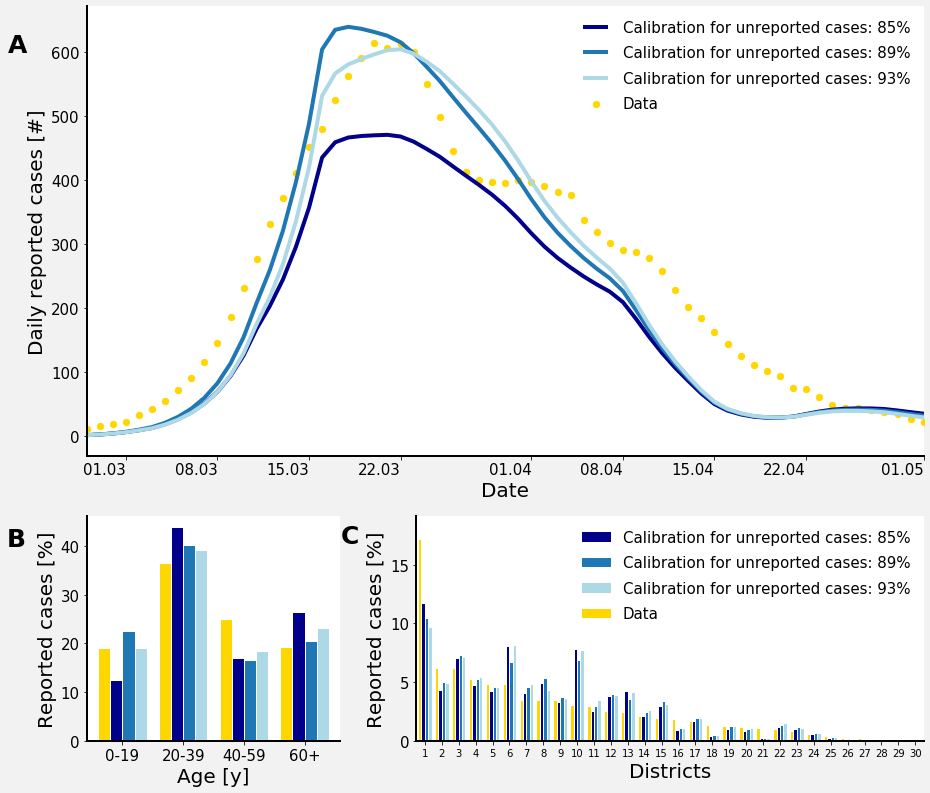

In [26]:
show_calibration_param(
    'gold',
    [
        'darkblue',
        'tab:blue',
        'lightblue',
    ],
    ind=ind,
    scen_idxs=[1, 4, 2],
    phases=[60],
    save_name='60',
)

Results for  1  and for seasonality  - :
Fit Loss: -25.743617060897613
Fitted parameters:
 Beta=[0.11993301 0.05348881 0.05213089 0.16625005]
 Theta=2.1394305795245376,
,Beta_behave=0.2323639516415803, 


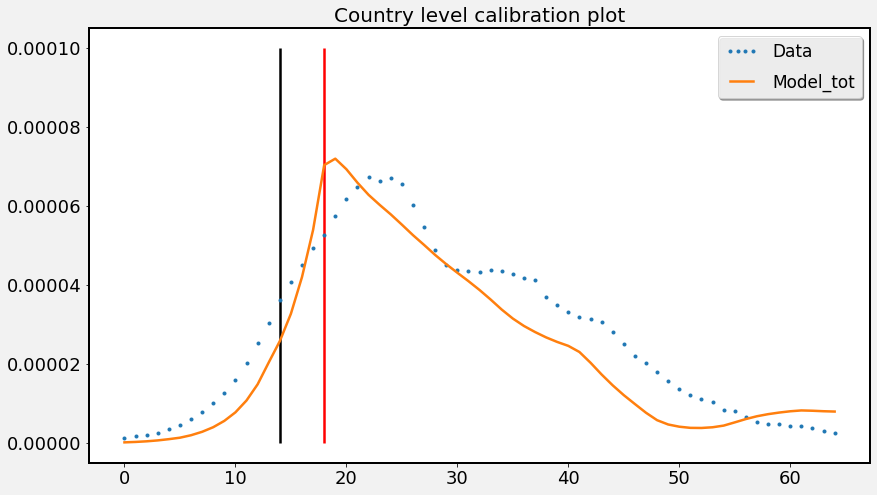

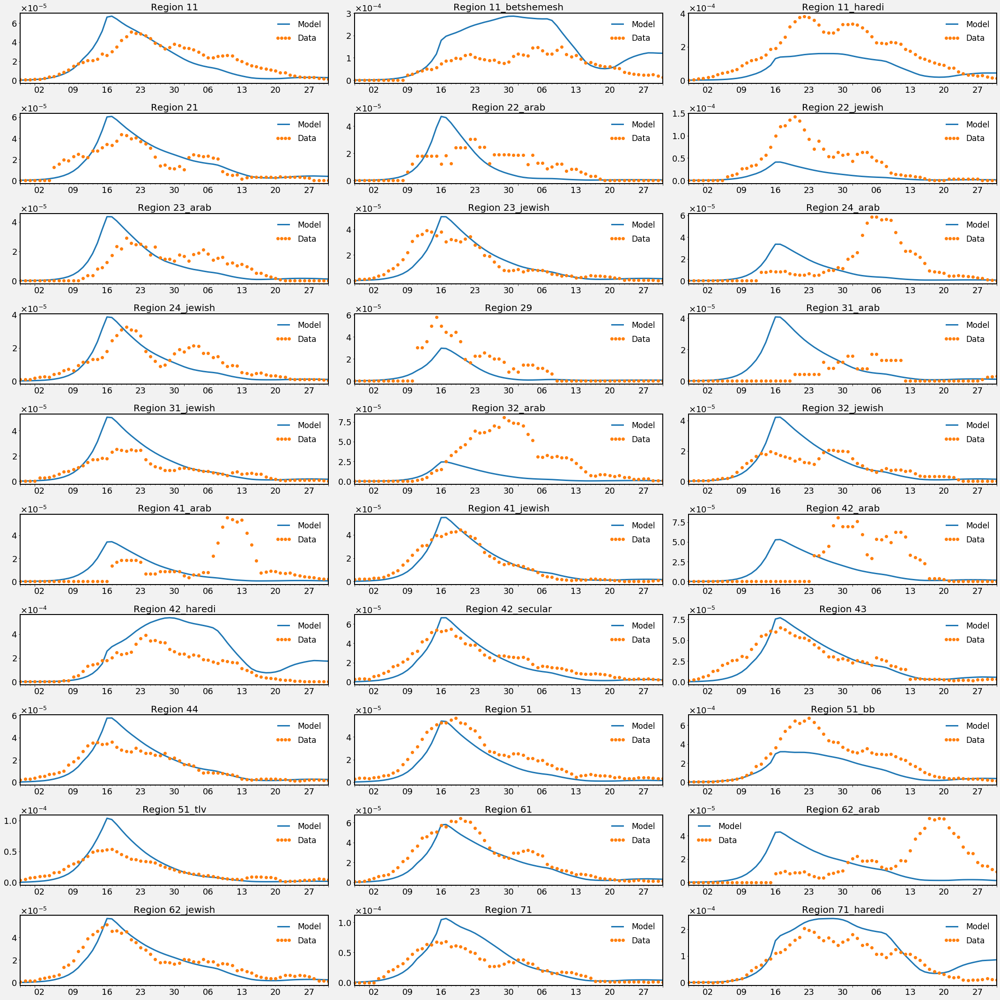

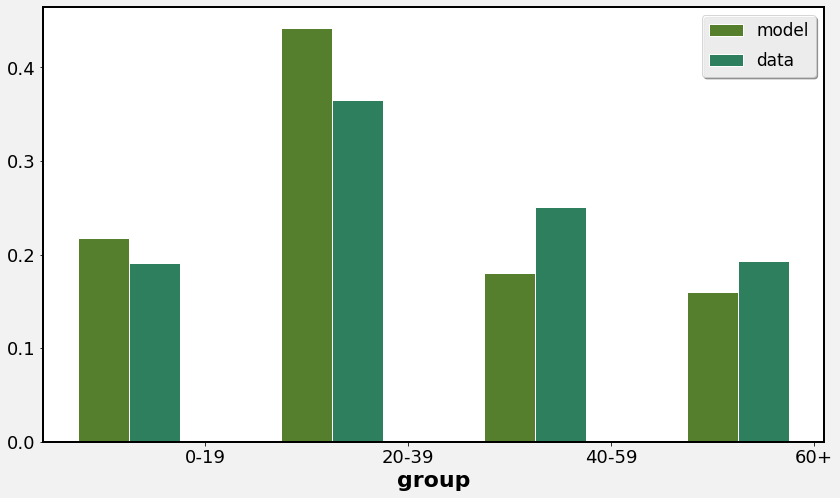

Results for  1  and for seasonality  -1 :
Fit Loss: -25.862780967677235
Fitted parameters:
 Beta=[0.04492147 0.02194342 0.02407521 0.10925305]
 Theta=2.4154995091702927,
,Beta_behave=0.3061126431013918, 


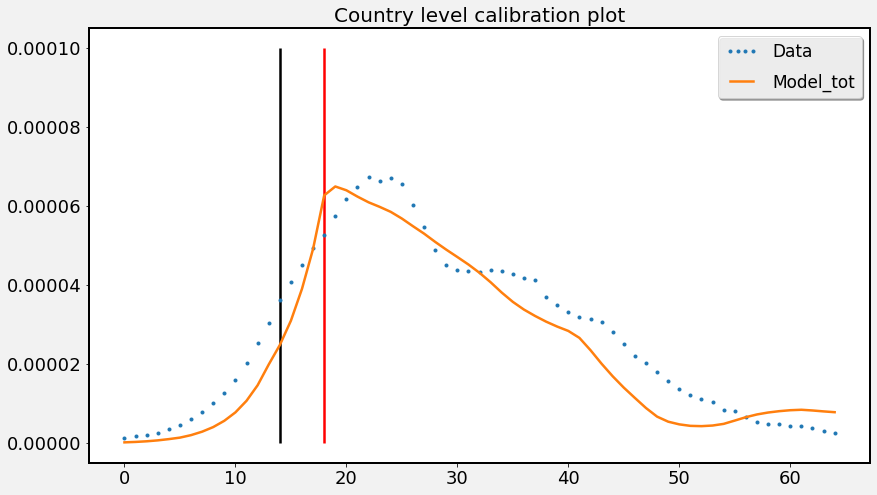

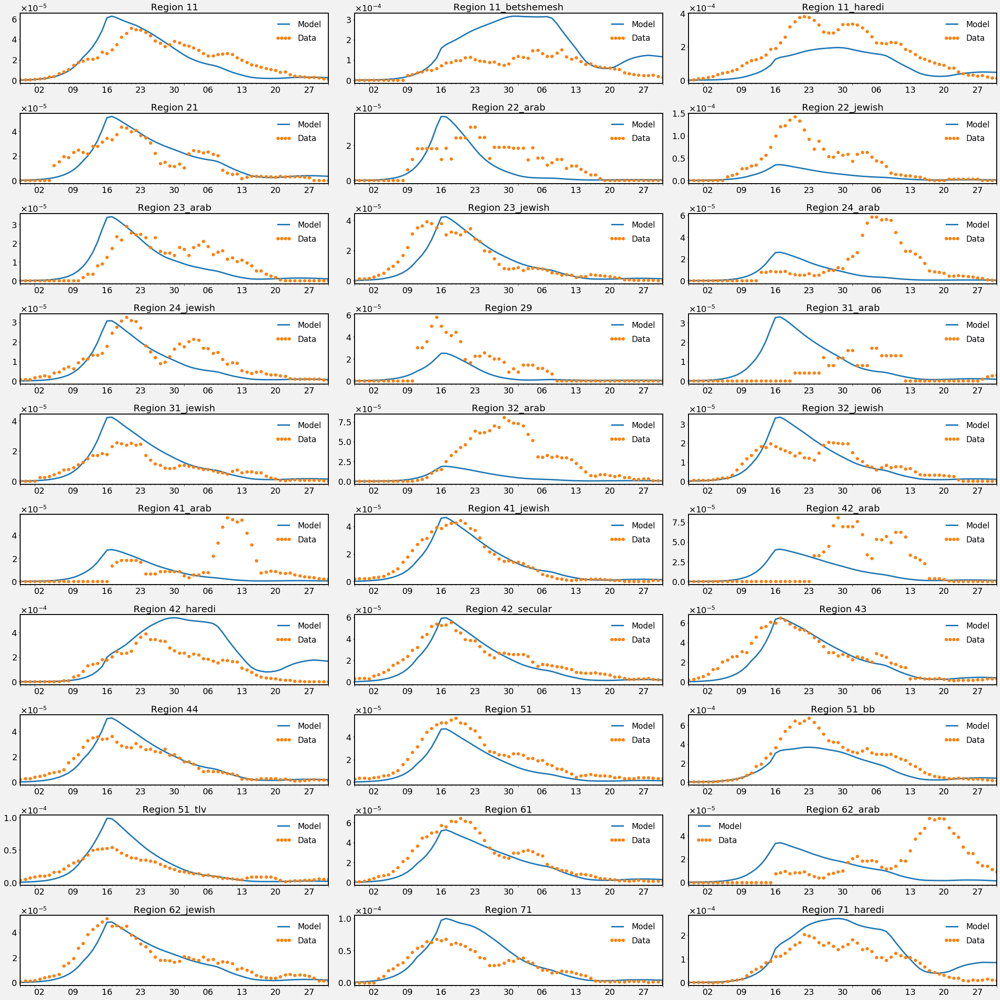

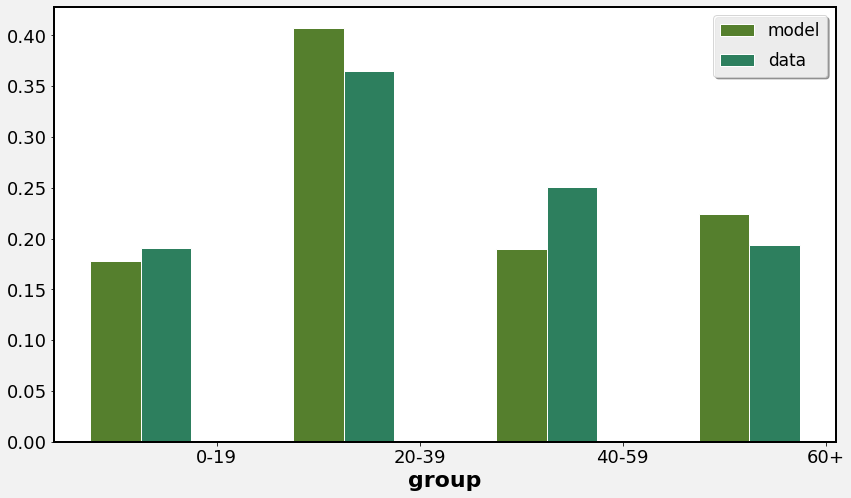

Results for  1  and for seasonality  29 :
Fit Loss: -25.787234563850898
Fitted parameters:
 Beta=[0.04938563 0.02756776 0.02458383 0.14897177]
 Theta=2.040768948899246,
,Beta_behave=0.42015513335274013, 


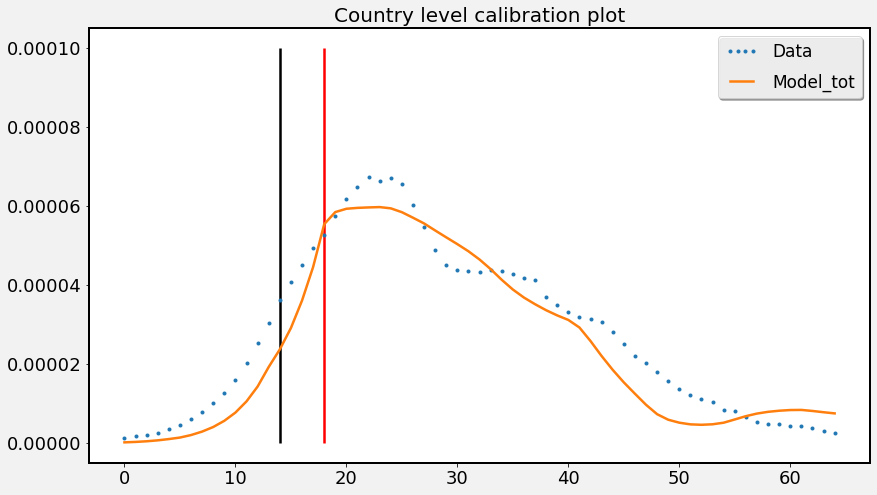

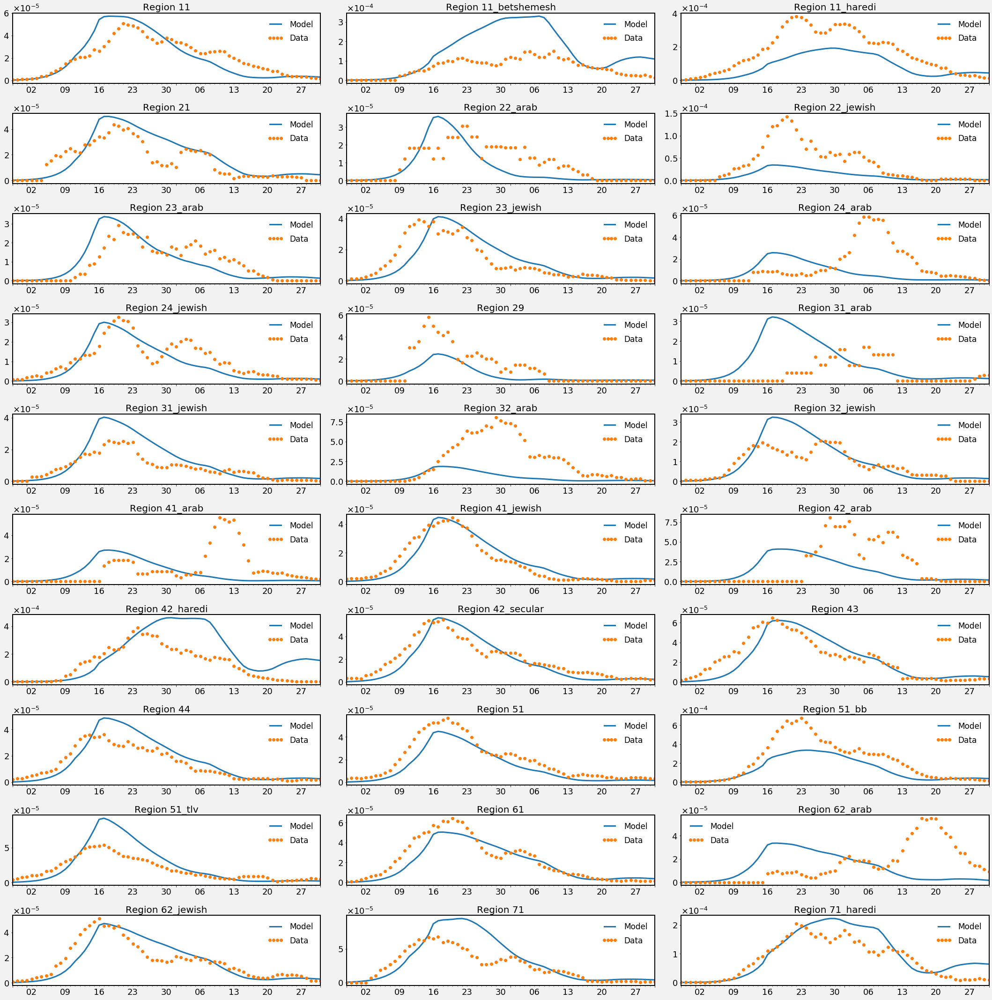

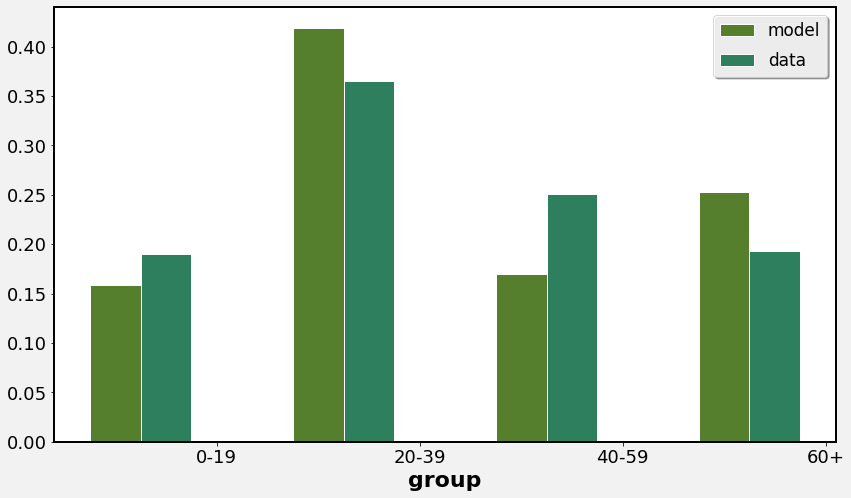

Results for  1  and for seasonality  60 :
Fit Loss: -25.813507423927906
Fitted parameters:
 Beta=[0.05170276 0.03696174 0.03438475 0.19929331]
 Theta=2.6150268410890773,
,Beta_behave=0.4641949538148384, 


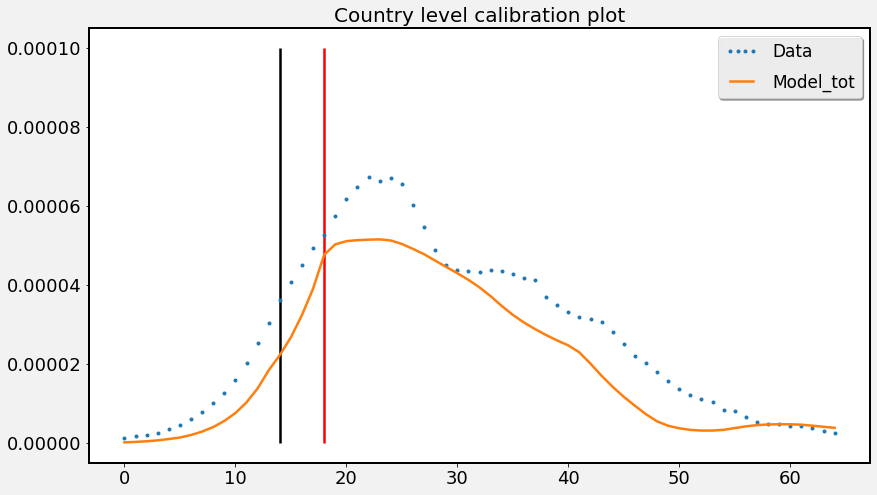

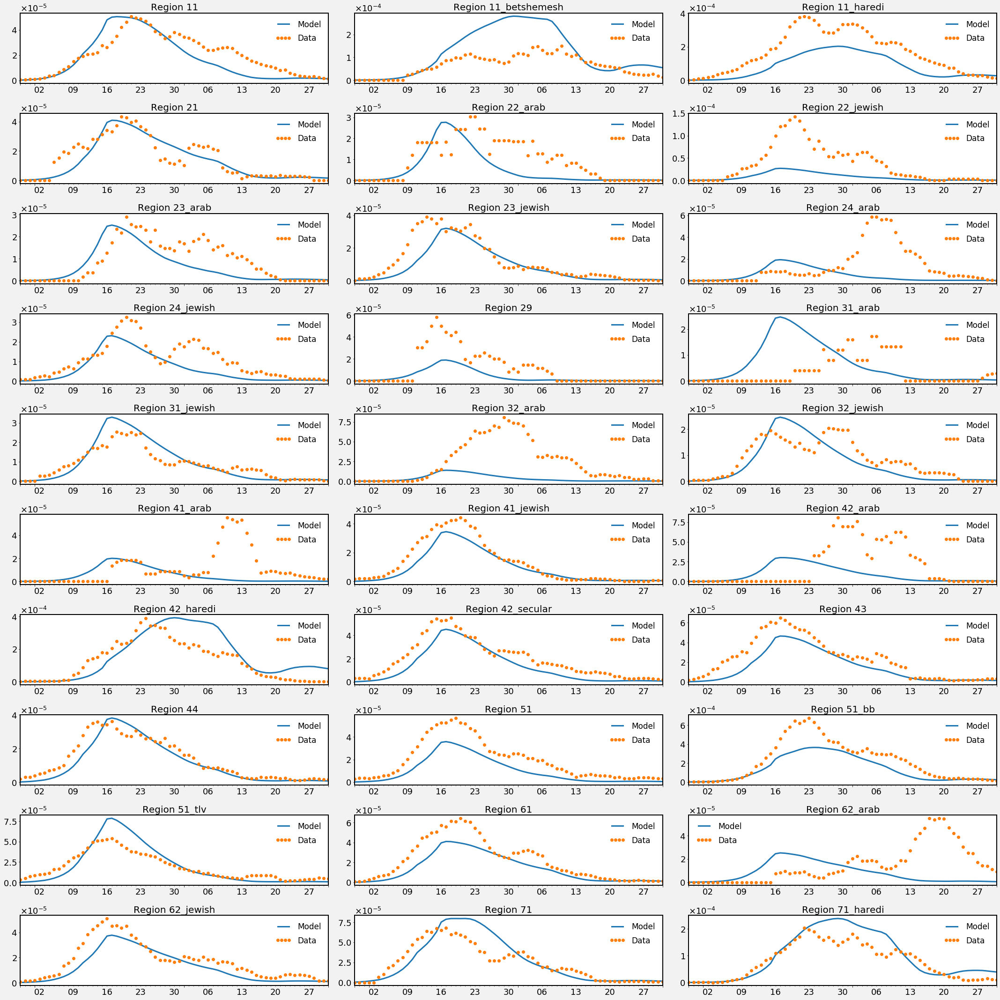

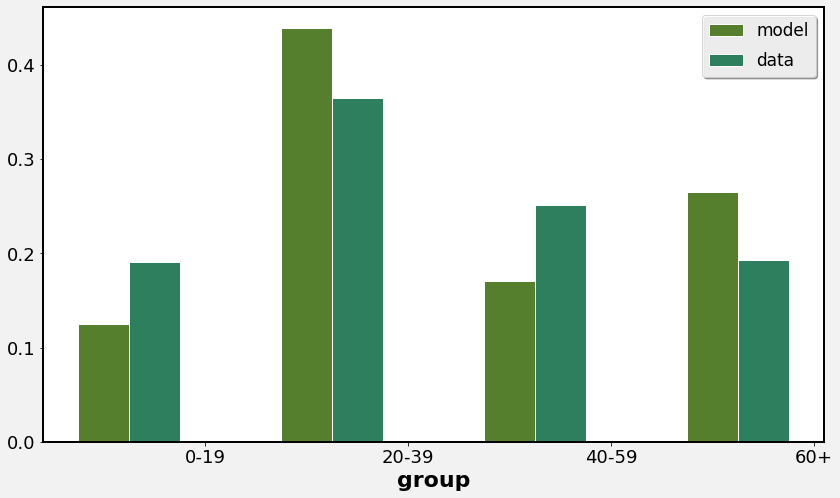

Results for  2  and for seasonality  - :
Fit Loss: -25.876598421343523
Fitted parameters:
 Beta=[0.11951491 0.03607917 0.05448627 0.18473229]
 Theta=2.7897013390633827,
,Beta_behave=0.246193403409607, 


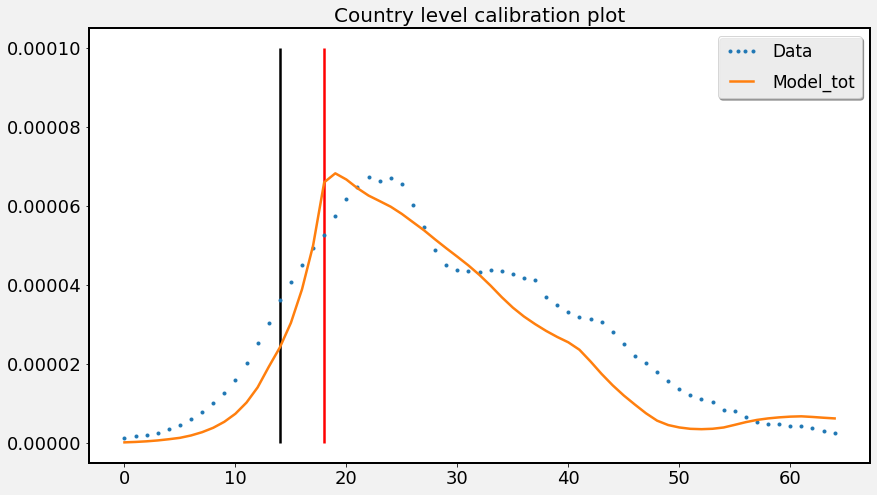

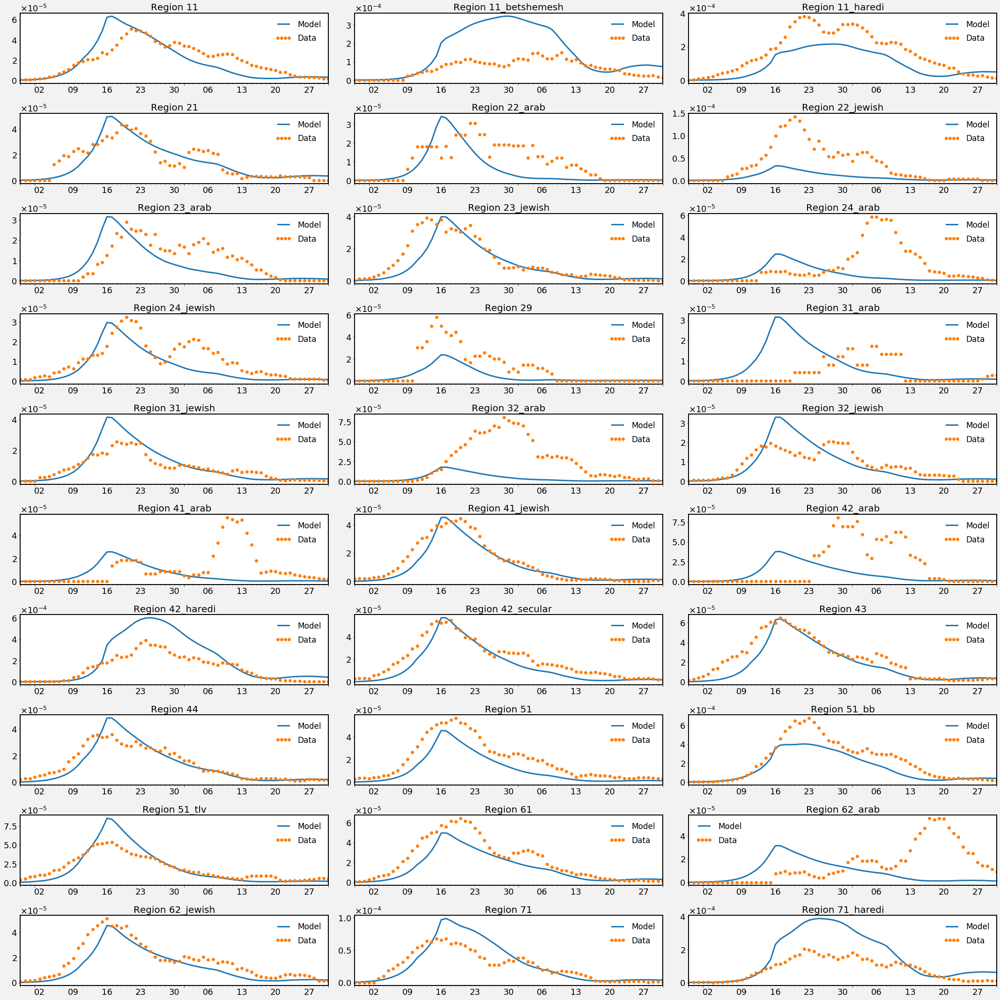

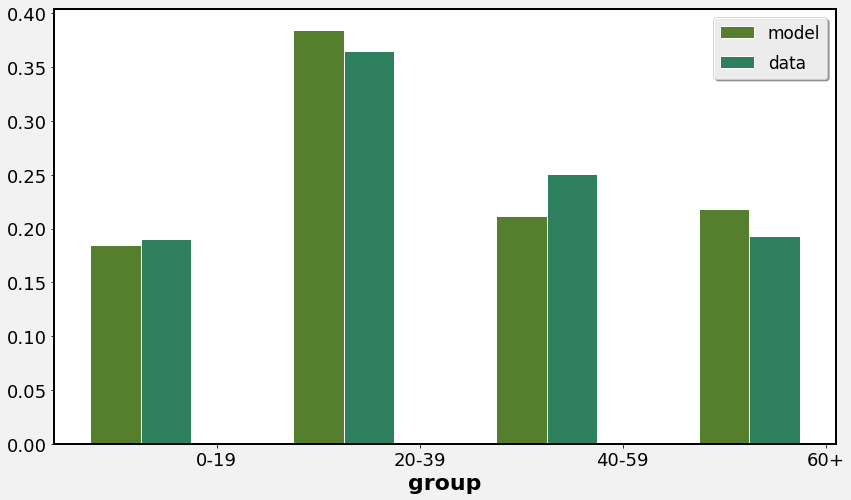

Results for  2  and for seasonality  -1 :
Fit Loss: -25.9179601850672
Fitted parameters:
 Beta=[0.05852261 0.01533448 0.02371048 0.08395287]
 Theta=2.7217207539982455,
,Beta_behave=0.2744777649941495, 


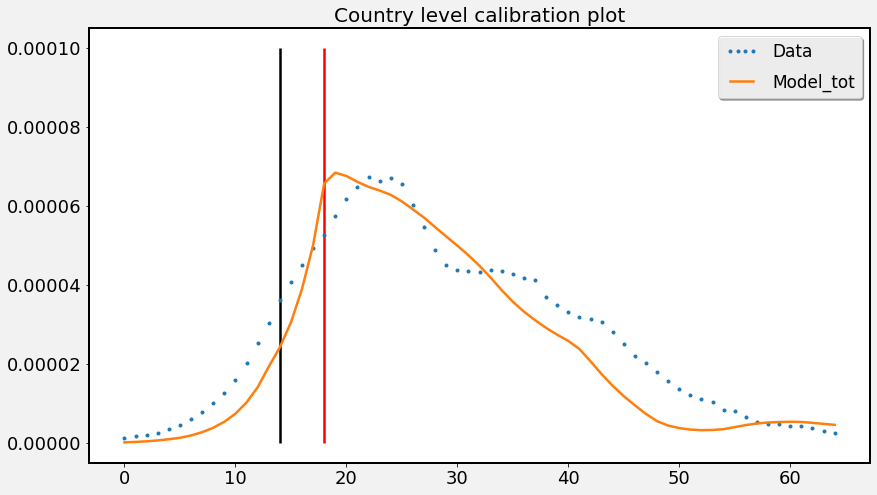

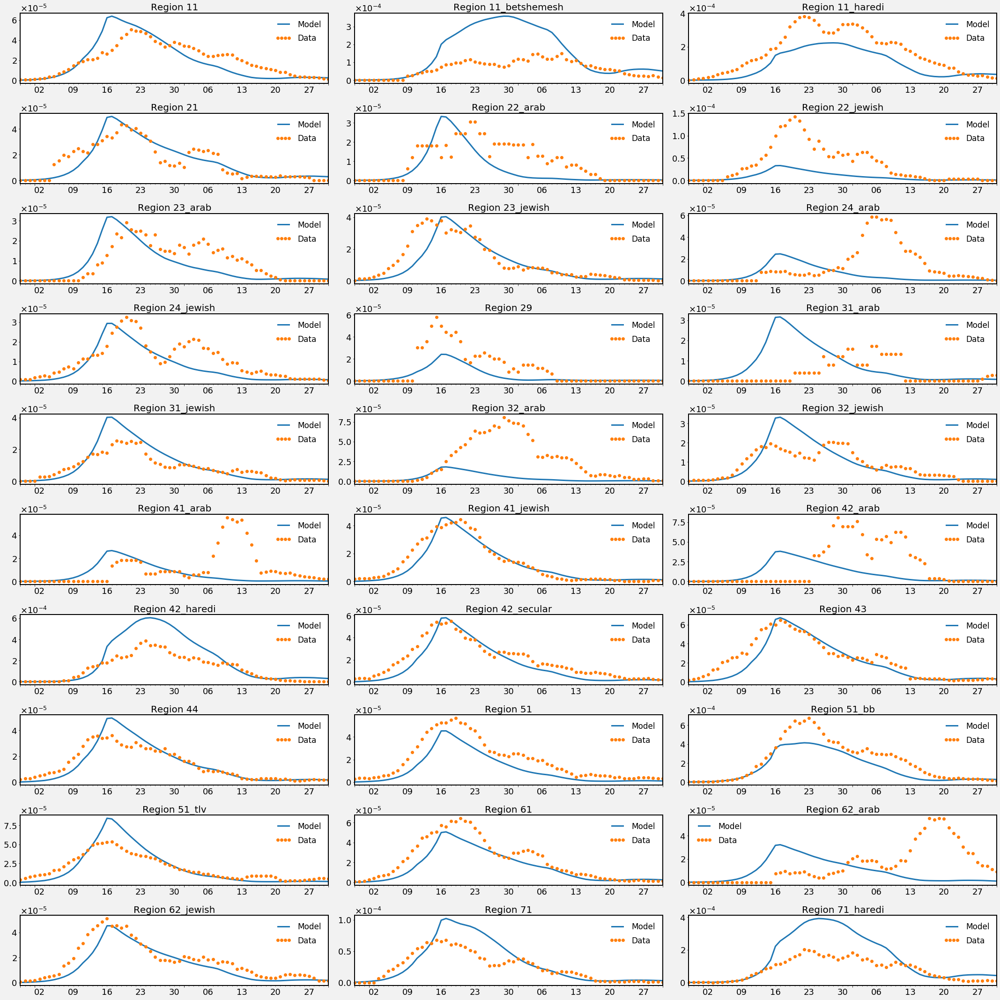

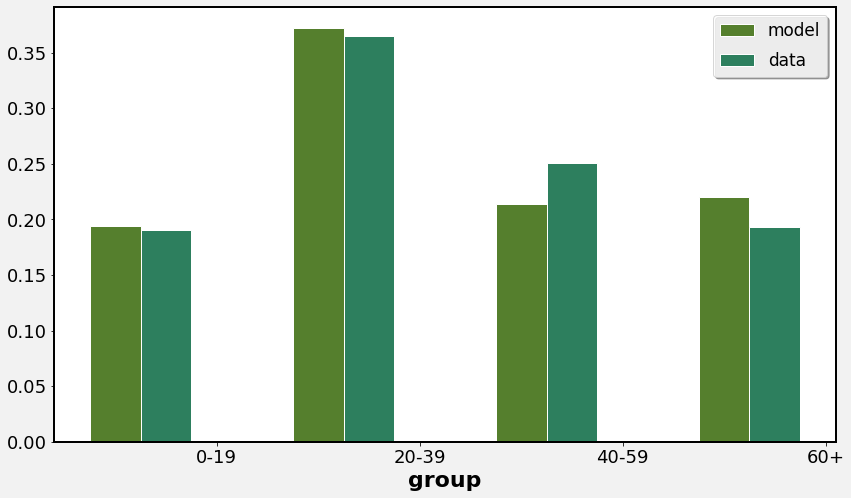

Results for  2  and for seasonality  29 :
Fit Loss: -25.898526897671783
Fitted parameters:
 Beta=[0.05945635 0.0203259  0.03027989 0.11267461]
 Theta=2.8076337362988926,
,Beta_behave=0.29519514992959195, 


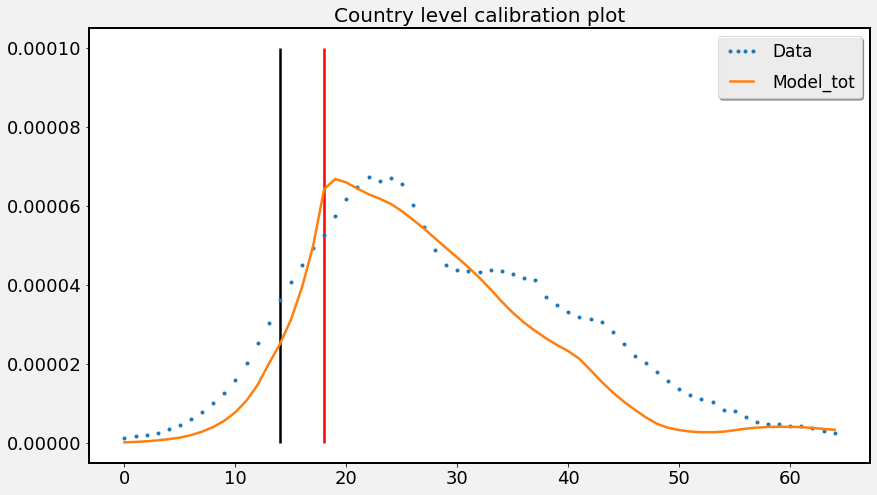

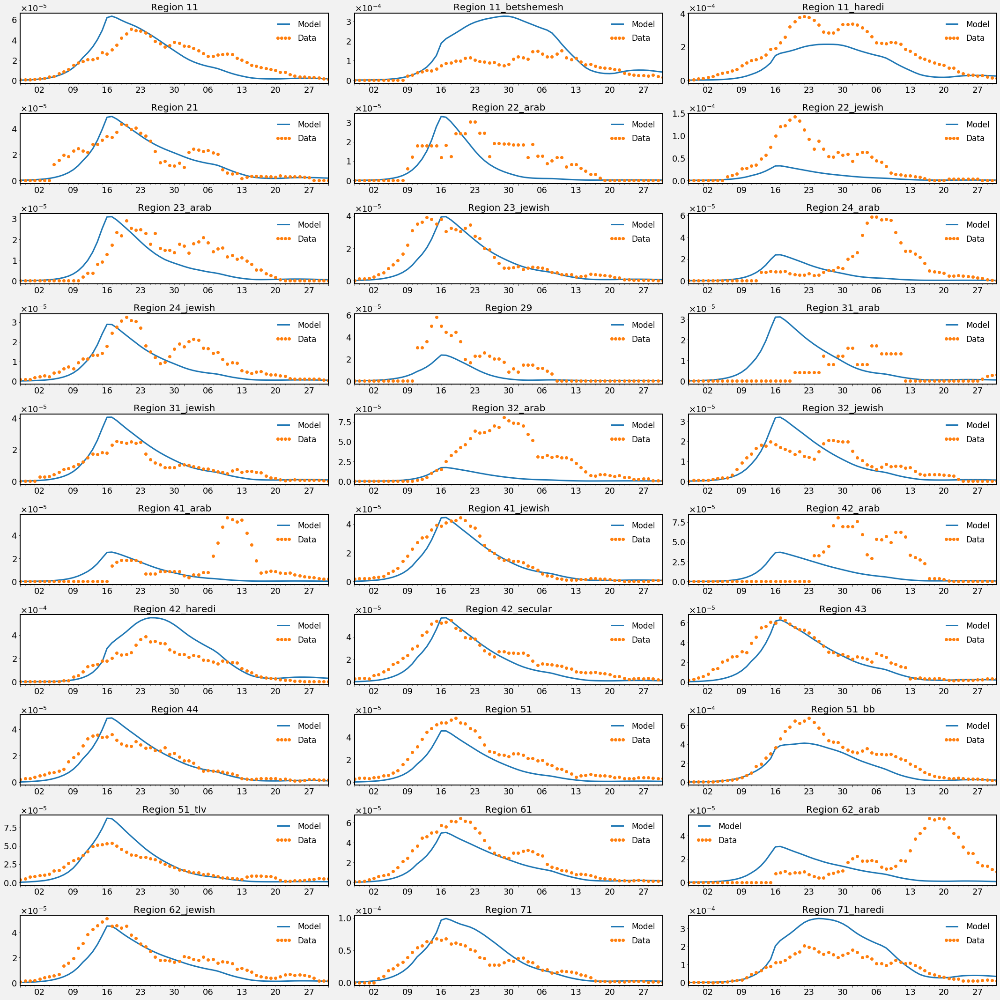

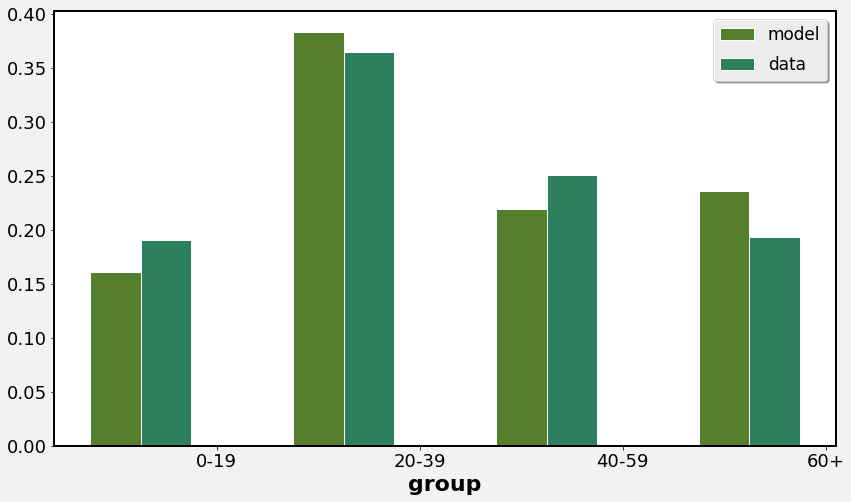

Results for  2  and for seasonality  60 :
Fit Loss: -25.827992850073734
Fitted parameters:
 Beta=[0.10025341 0.03014829 0.03456392 0.1576538 ]
 Theta=2.095744449297545,
,Beta_behave=0.4119732737123784, 


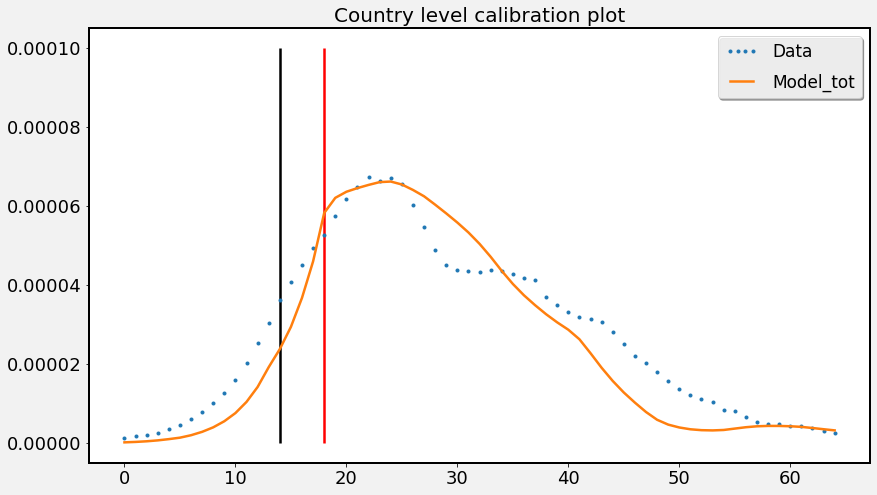

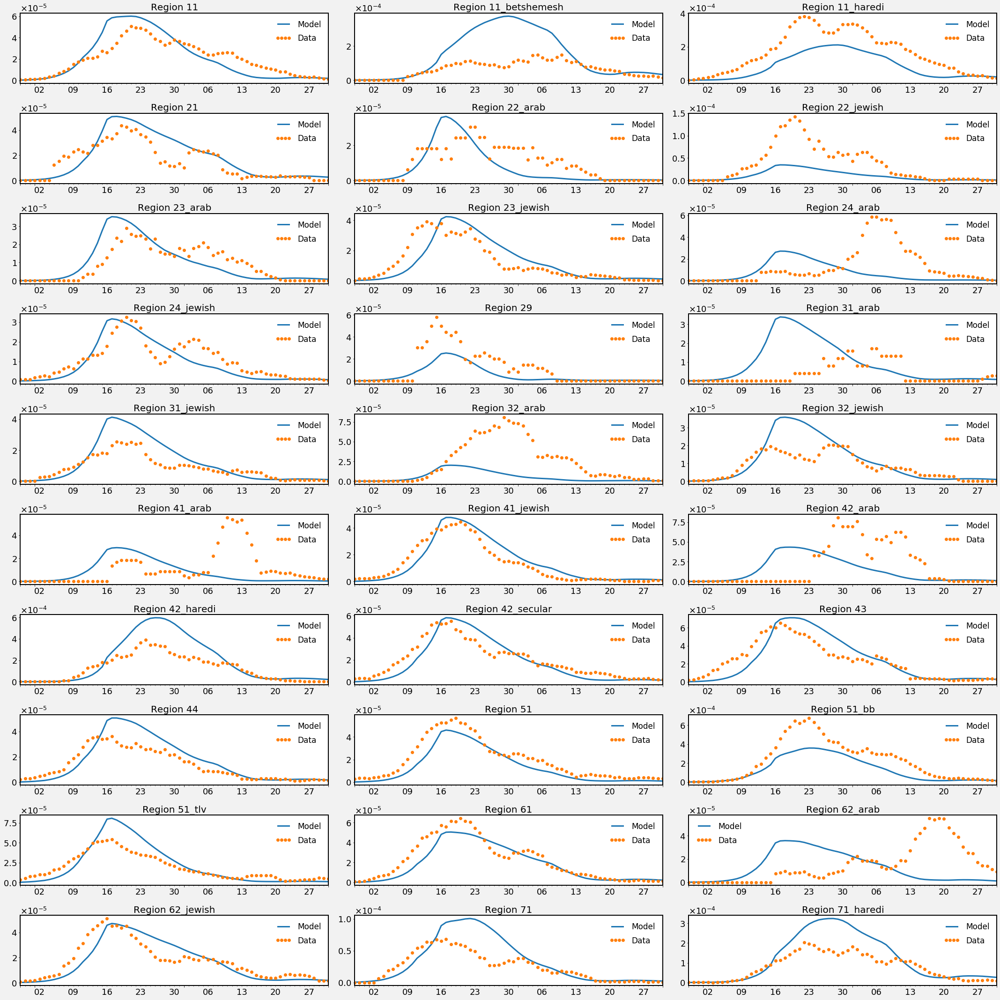

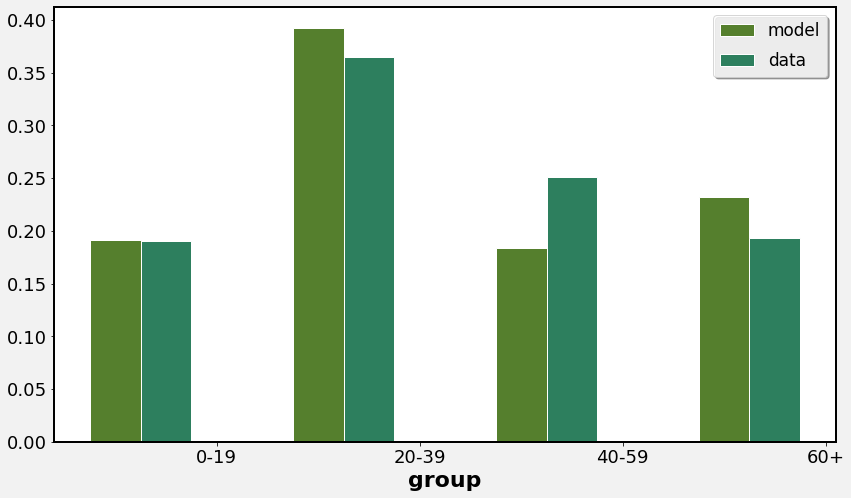

Results for  3  and for seasonality  - :
Fit Loss: -25.766859332991928
Fitted parameters:
 Beta=[0.09429609 0.05409133 0.04257669 0.31101413]
 Theta=2.3247436620648054,
,Beta_behave=0.24838849624074943, 


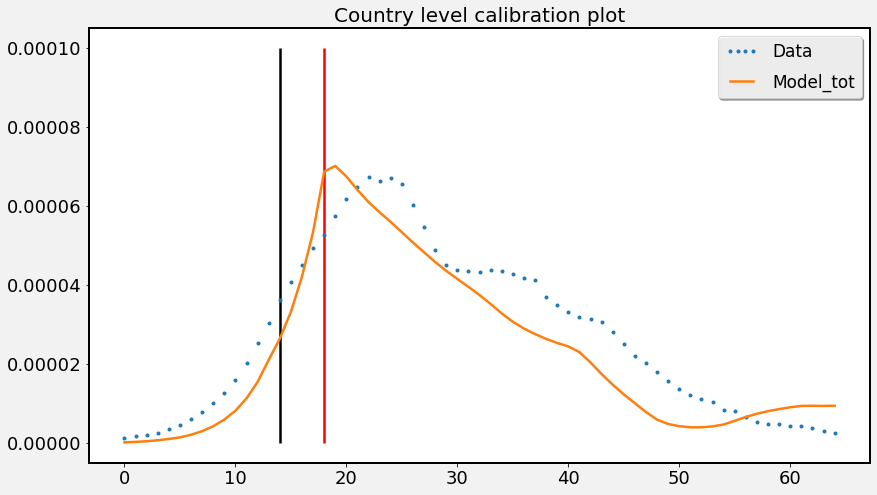

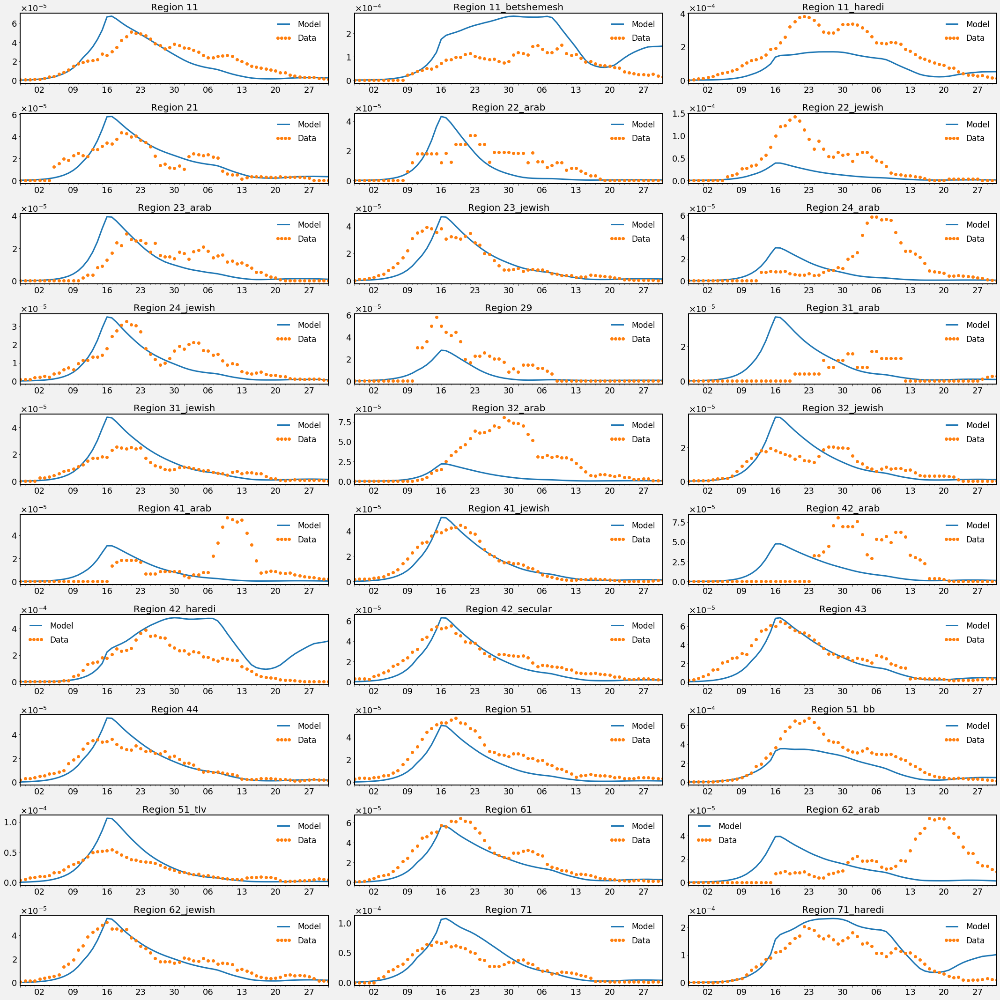

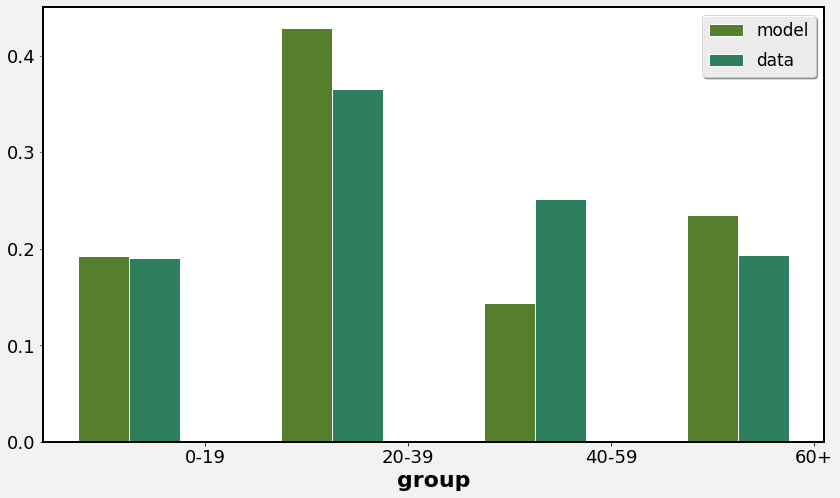

Results for  3  and for seasonality  -1 :
Fit Loss: -25.856091734991633
Fitted parameters:
 Beta=[0.03877397 0.02324786 0.02027647 0.12883293]
 Theta=2.668372372271473,
,Beta_behave=0.27238608175651324, 


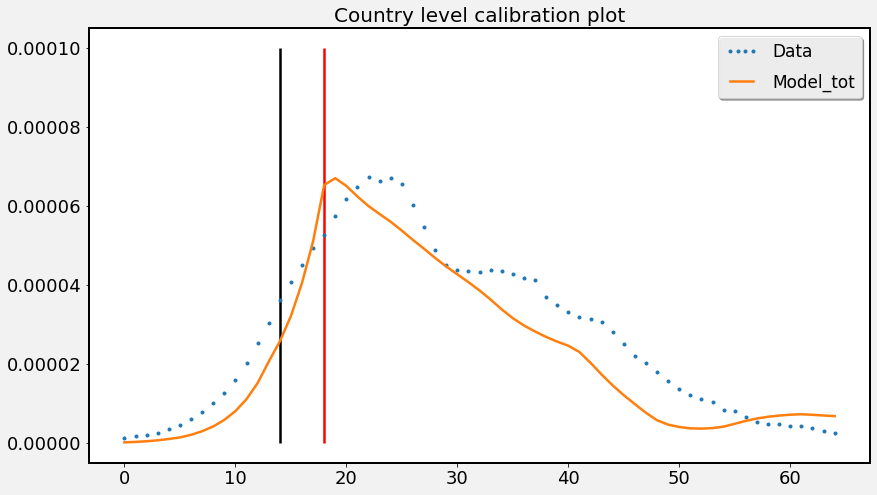

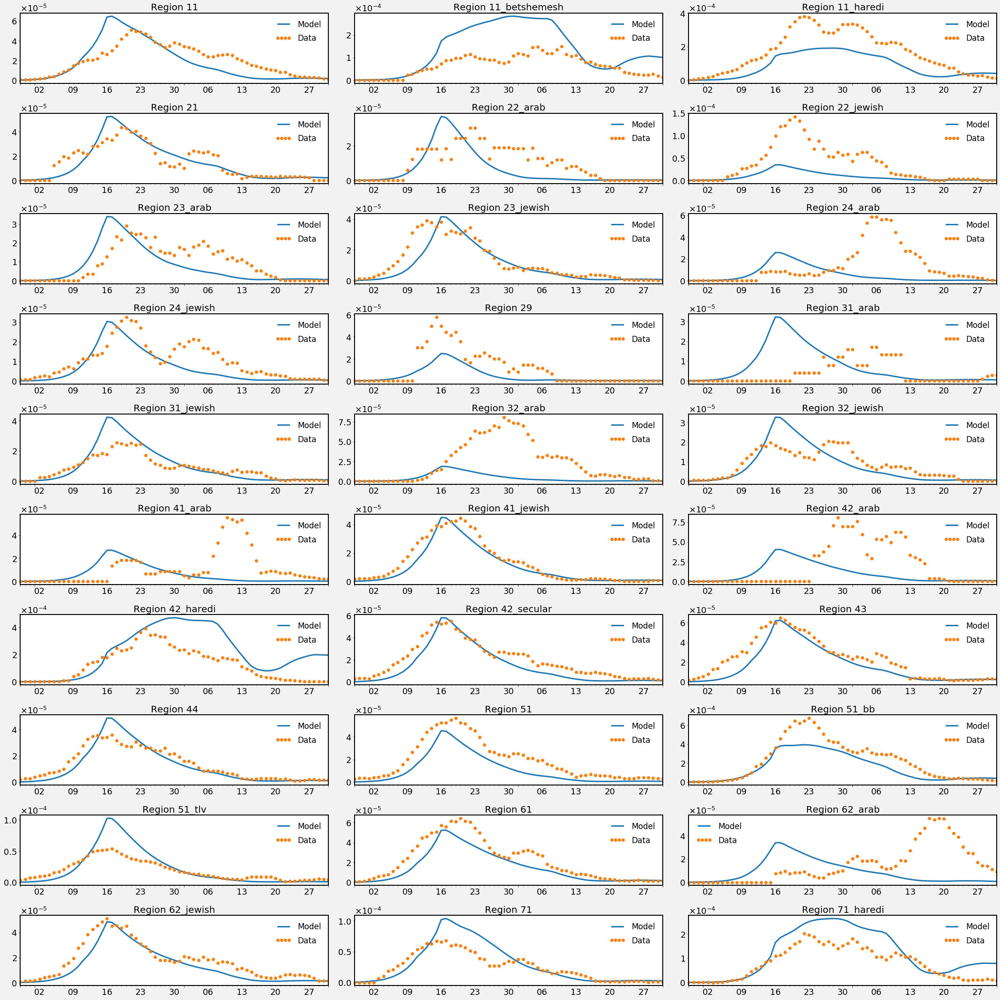

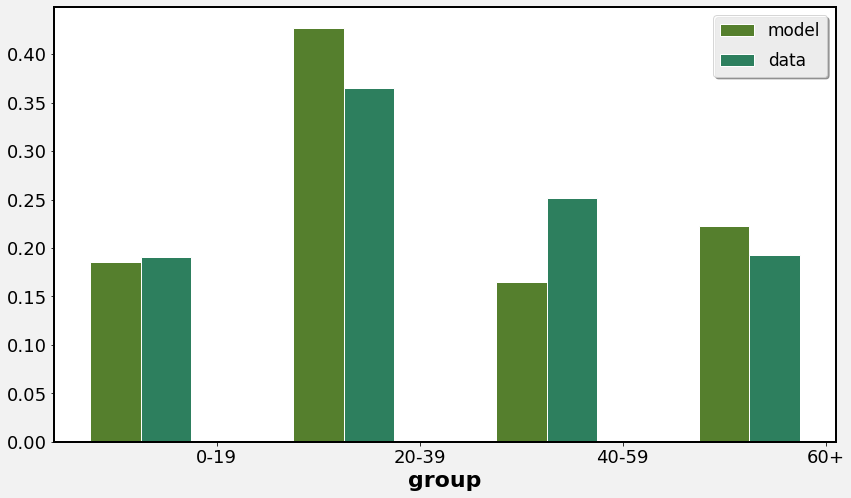

Results for  3  and for seasonality  29 :
Fit Loss: -25.835966888139694
Fitted parameters:
 Beta=[0.04374825 0.02512583 0.02495743 0.15153001]
 Theta=2.503839742672762,
,Beta_behave=0.36491349233021075, 


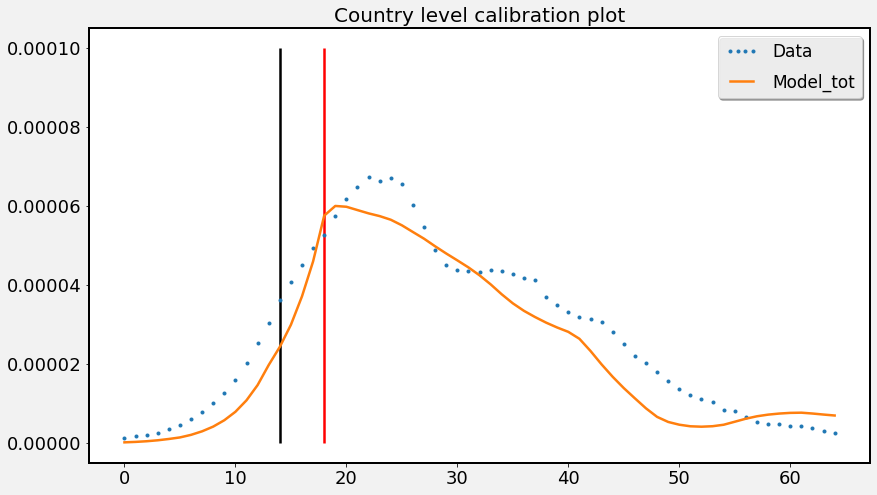

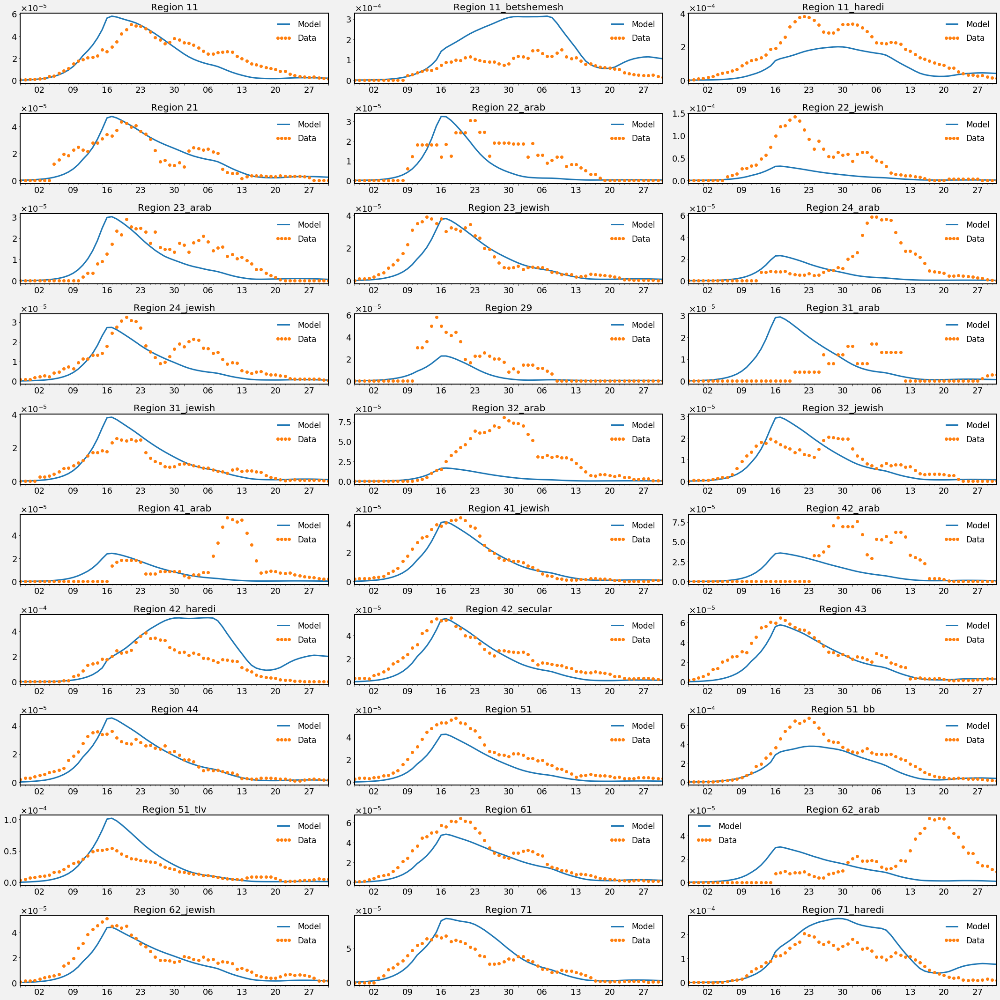

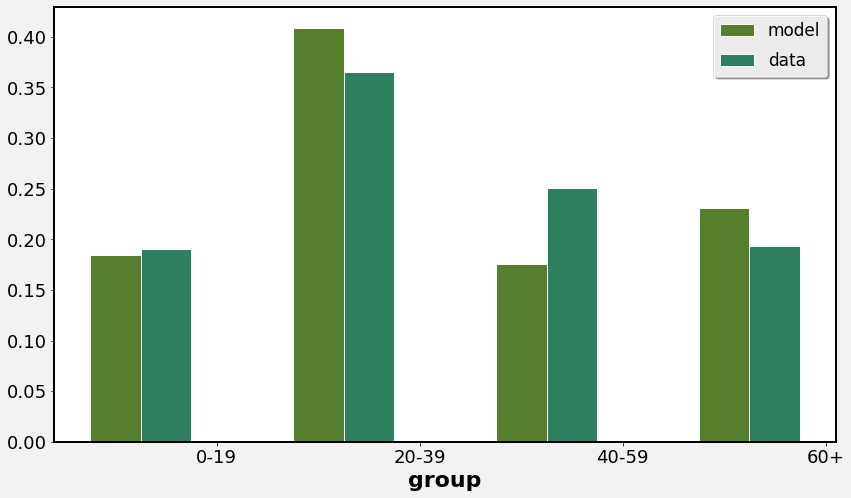

Results for  3  and for seasonality  60 :
Fit Loss: -25.8221876632522
Fitted parameters:
 Beta=[0.06348226 0.03913274 0.03374409 0.24813029]
 Theta=2.5209852486736053,
,Beta_behave=0.3476213464613731, 


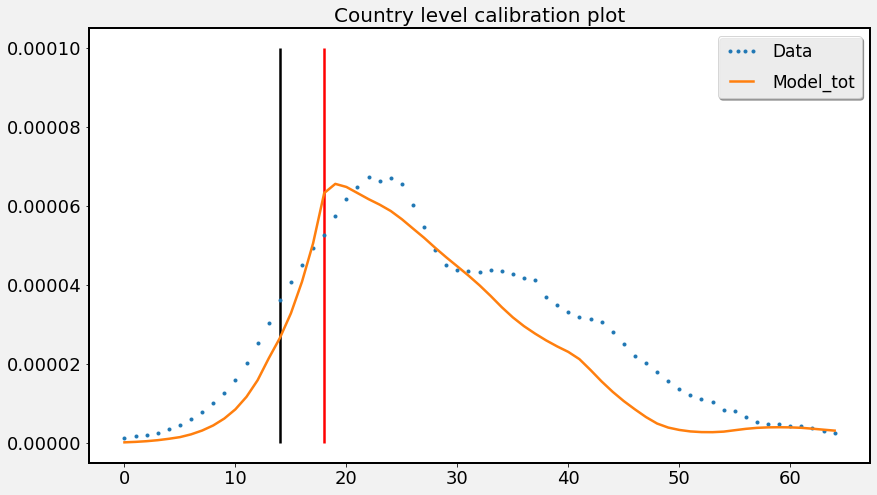

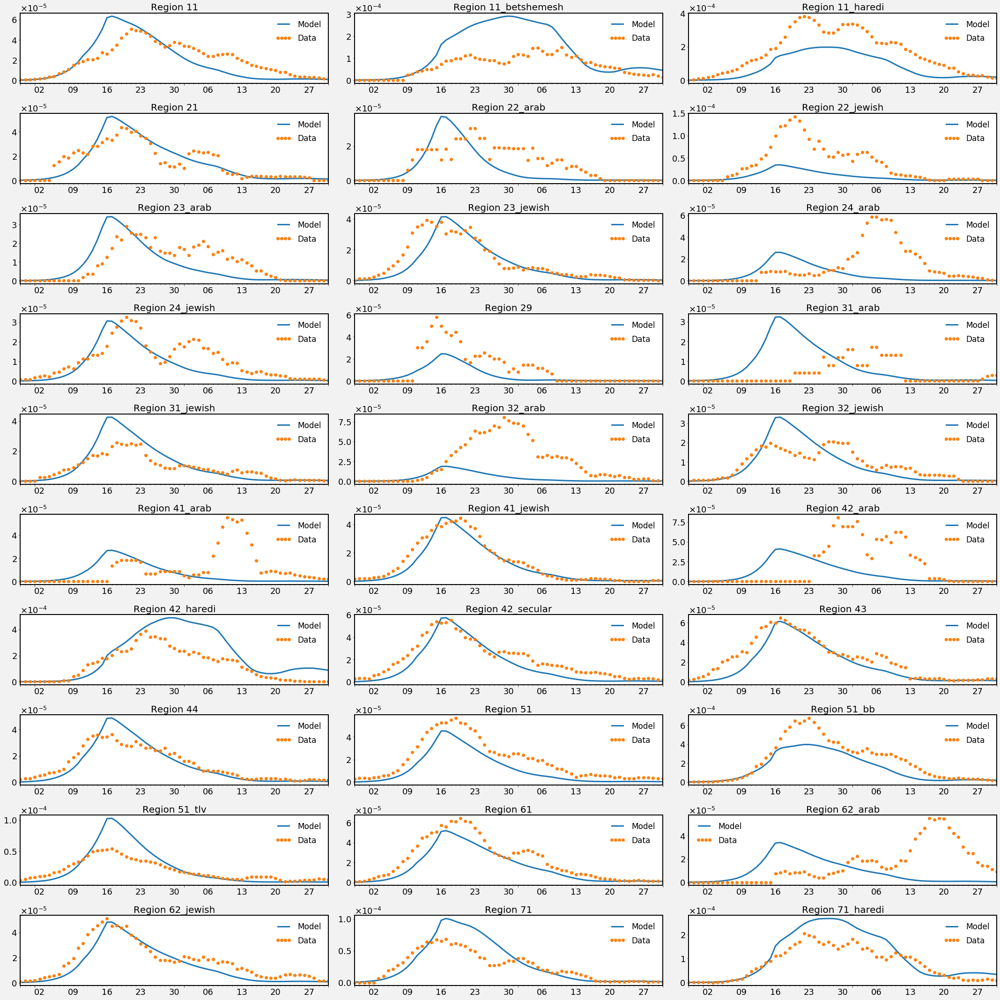

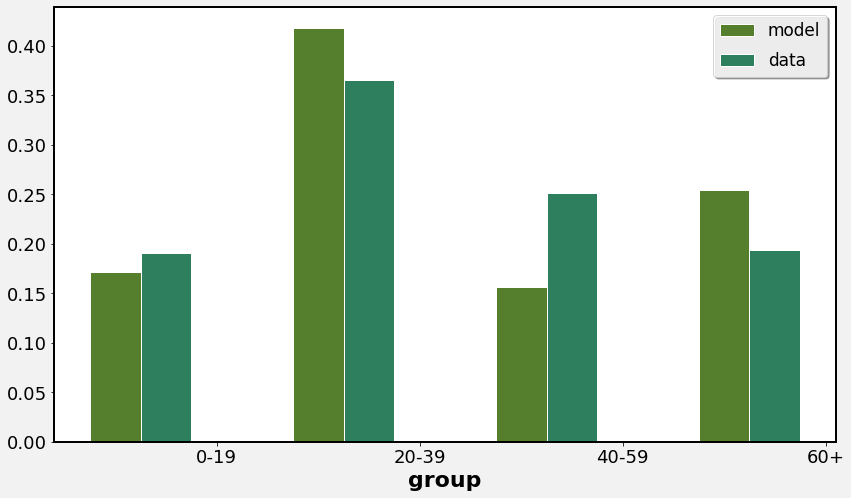

In [21]:
for scen in [mdl.num2scen(i) for i in [1,2,3]]:
    for phase in ['-', -1, 29, 60]:
        mdl.show_calibration_param(
            ind,
            int(scen[-1]),
            phase,
        )
# #         run calibration for model parameters
#         mdl.make_calibration(
#             scen,
#             phase,
#             ind,
#         )
        
# #         run calibration for model tracking states
#         mdl.make_track_calibration(
#             scen,
#             phase,
#             ind,
#         )

iter:  50  loss:  -23.721974128127616
iter:  100  loss:  -23.76676787174418
minimized value: -23.76696484133003
Fitted parameters:
 Eta=0.5075527764632188
 Nu=0.10054031967556343,
 
num of sampling the target function: 30
Results for  1  and for seasonality  29 for tracking  H :
H
Fit Loss: -23.76696484133003
Fitted parameters:
 Eta=0.5075527764632188
 Nu=0.10054031967556343,
 


<Figure size 1008x576 with 0 Axes>

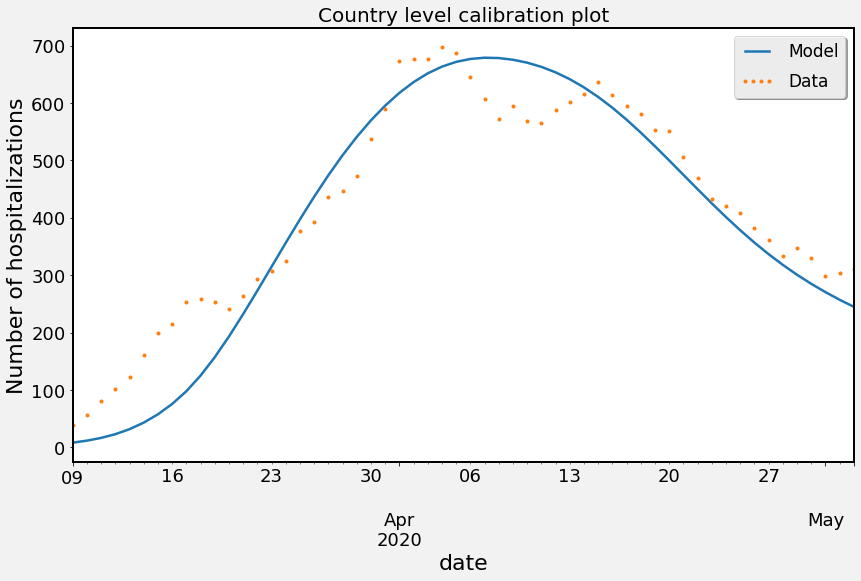

iter:  50  loss:  -27.426709901574785
iter:  100  loss:  -27.614418031930544
minimized value: -27.61444904426954
Fitted parameters:
 Xi=0.19403777603125816
 Mu=0.05589509912945517,
 
num of sampling the target function: 36
Results for  1  and for seasonality  29 for tracking  Vents :
Vents
0.19403777603125816
Fit Loss: -27.61444904426954
Fitted parameters:
 Xi=0.19403777603125816
 Mu=0.05589509912945517,
 


<Figure size 1008x576 with 0 Axes>

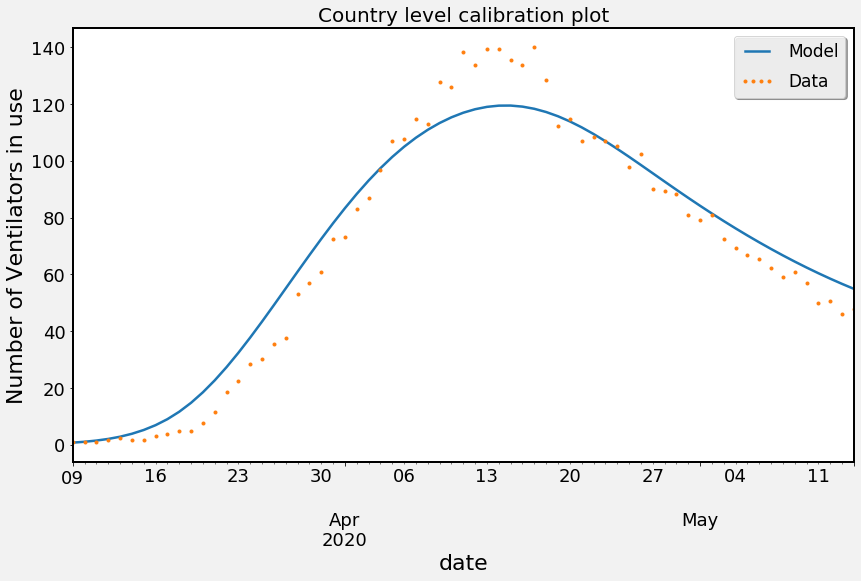

iter:  50  loss:  -23.783692465718865
iter:  100  loss:  -23.870189894821923
iter:  150  loss:  -23.876492564524494
minimized value: -23.876492864721072
Fitted parameters:
 Eta=0.7222820195159176
 Nu=0.08573132795865773,
 
num of sampling the target function: 43
Results for  1  and for seasonality  60 for tracking  H :
H
Fit Loss: -23.876492864721072
Fitted parameters:
 Eta=0.7222820195159176
 Nu=0.08573132795865773,
 


<Figure size 1008x576 with 0 Axes>

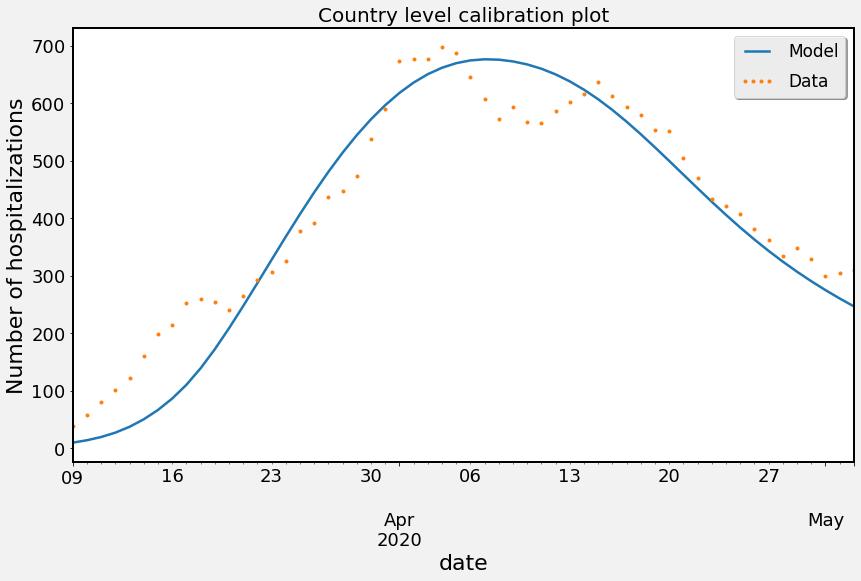

iter:  50  loss:  -27.416952367785107
iter:  100  loss:  -27.45831732431917
minimized value: -27.458322368557038
Fitted parameters:
 Xi=0.21715949457530997
 Mu=0.04688401955971211,
 
num of sampling the target function: 33
Results for  1  and for seasonality  60 for tracking  Vents :
Vents
0.21715949457530997
Fit Loss: -27.458322368557038
Fitted parameters:
 Xi=0.21715949457530997
 Mu=0.04688401955971211,
 


<Figure size 1008x576 with 0 Axes>

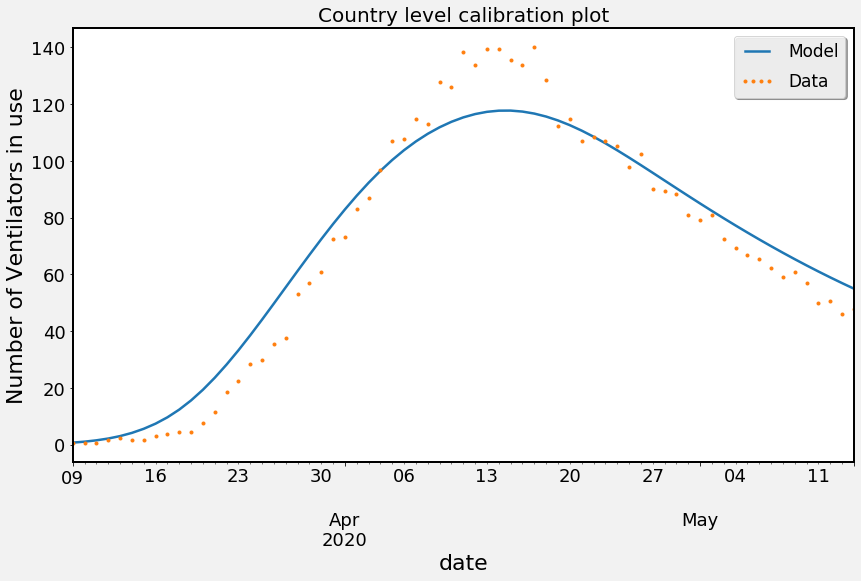

iter:  50  loss:  -22.900546840908554
iter:  100  loss:  -23.778209784298213
minimized value: -23.778269406954923
Fitted parameters:
 Eta=0.42265392536635626
 Nu=0.09348260360564808,
 
num of sampling the target function: 36
Results for  1  and for seasonality  -1 for tracking  H :
H
Fit Loss: -23.778269406954923
Fitted parameters:
 Eta=0.42265392536635626
 Nu=0.09348260360564808,
 


<Figure size 1008x576 with 0 Axes>

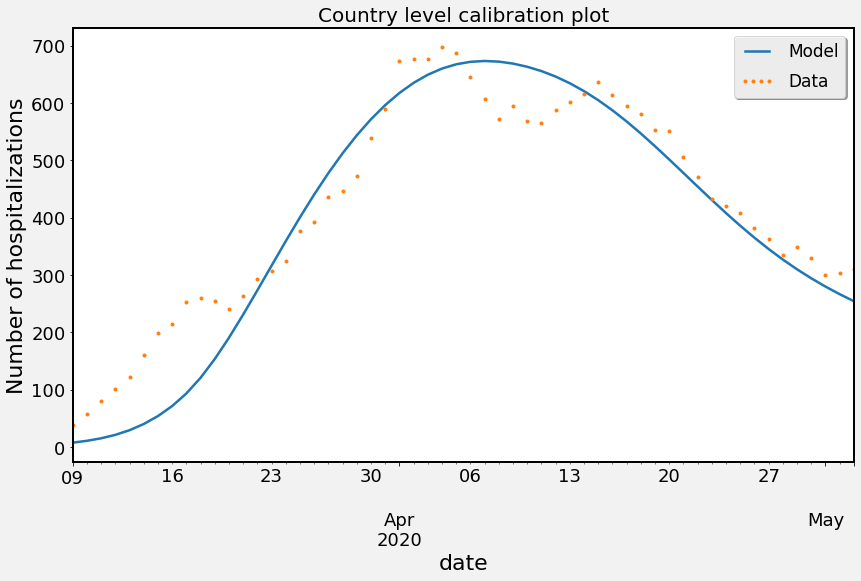

iter:  50  loss:  -27.29507607373923
iter:  100  loss:  -27.337985393884356
iter:  150  loss:  -27.337985761120642
minimized value: -27.337985761130458
Fitted parameters:
 Xi=0.1987760299750983
 Mu=0.048861576041211996,
 
num of sampling the target function: 45
Results for  1  and for seasonality  -1 for tracking  Vents :
Vents
0.1987760299750983
Fit Loss: -27.337985761130458
Fitted parameters:
 Xi=0.1987760299750983
 Mu=0.048861576041211996,
 


<Figure size 1008x576 with 0 Axes>

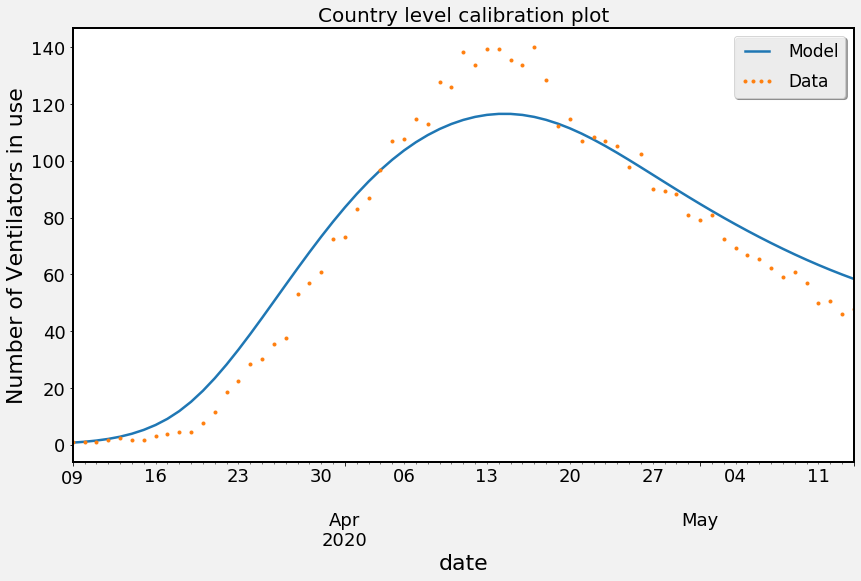

iter:  50  loss:  -23.597505685022828
iter:  100  loss:  -23.829445037447865
iter:  150  loss:  -23.854886404042617
iter:  200  loss:  -23.855132345826505
minimized value: -23.855132383454155
Fitted parameters:
 Eta=0.49724604726562655
 Nu=0.07667984381530396,
 
num of sampling the target function: 55
Results for  1  and for seasonality  - for tracking  H :
H
Fit Loss: -23.855132383454155
Fitted parameters:
 Eta=0.49724604726562655
 Nu=0.07667984381530396,
 


<Figure size 1008x576 with 0 Axes>

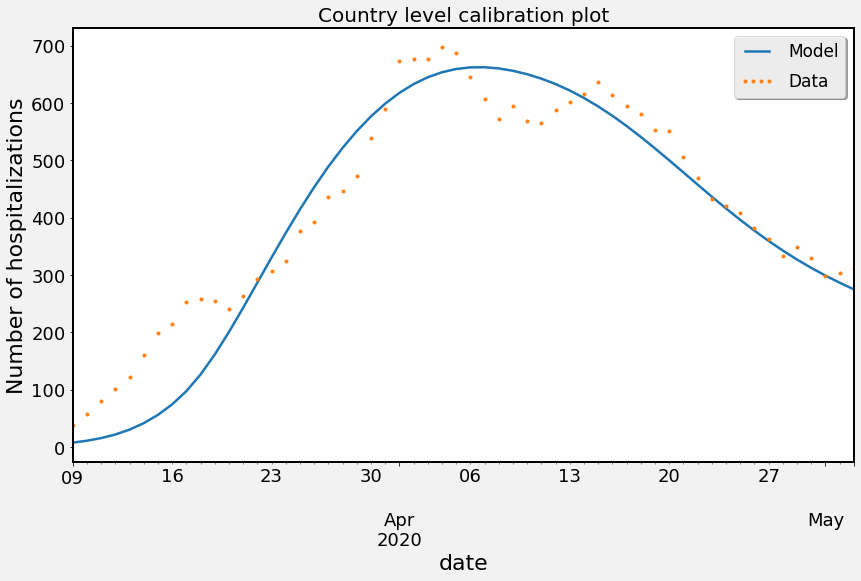

iter:  50  loss:  -26.05711027162195
iter:  100  loss:  -26.64719616971323
iter:  150  loss:  -26.650406871406794
iter:  200  loss:  -26.661081900264254
minimized value: -26.66109649960504
Fitted parameters:
 Xi=0.2835473609187167
 Mu=0.03142964687049088,
 
num of sampling the target function: 55
Results for  1  and for seasonality  - for tracking  Vents :
Vents
0.2835473609187167
Fit Loss: -26.66109649960504
Fitted parameters:
 Xi=0.2835473609187167
 Mu=0.03142964687049088,
 


<Figure size 1008x576 with 0 Axes>

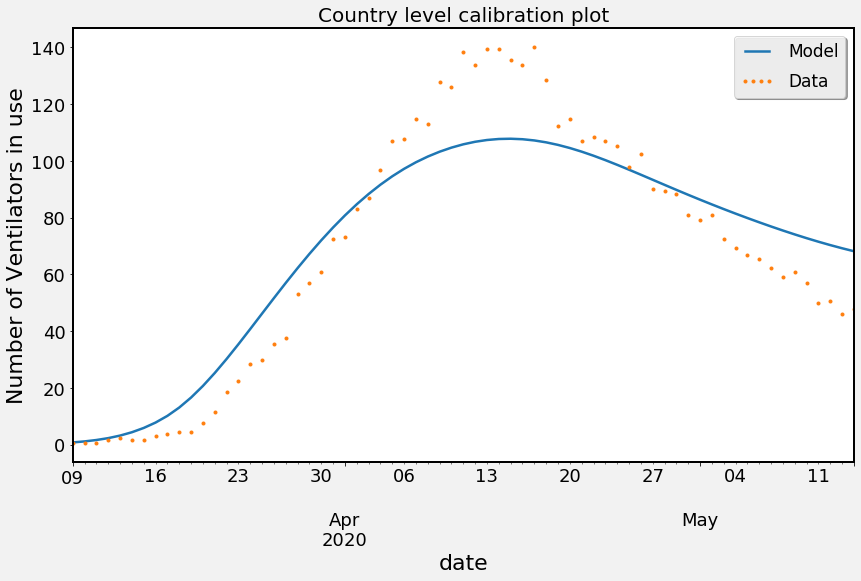

iter:  50  loss:  -23.612062722556733
iter:  100  loss:  -23.61338254451399
iter:  150  loss:  -23.613383734197473
minimized value: -23.613384207519292
Fitted parameters:
 Eta=0.29521249980231923
 Nu=0.09492221882629132,
 
num of sampling the target function: 46
Results for  2  and for seasonality  29 for tracking  H :
H
Fit Loss: -23.613384207519292
Fitted parameters:
 Eta=0.29521249980231923
 Nu=0.09492221882629132,
 


<Figure size 1008x576 with 0 Axes>

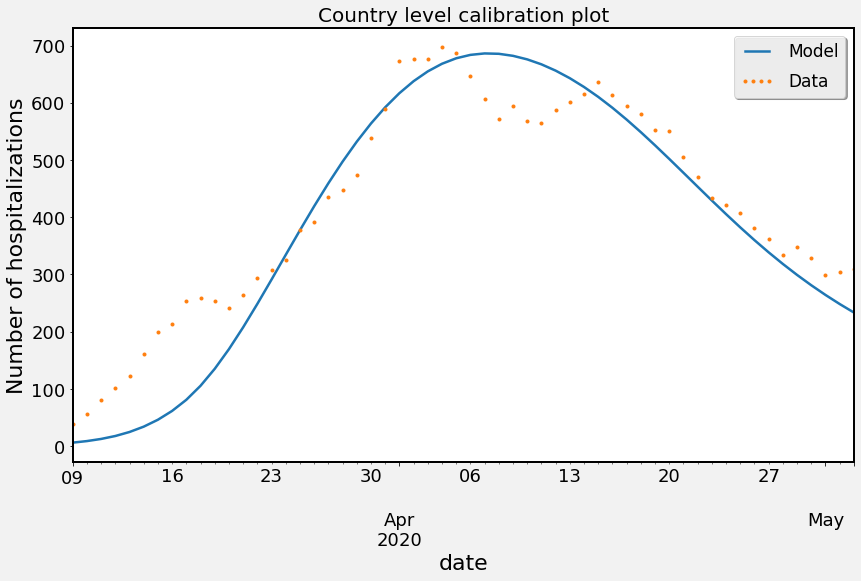

iter:  50  loss:  -27.515224415014455
iter:  100  loss:  -27.61354903105875
minimized value: -27.613612507377702
Fitted parameters:
 Xi=0.1647885096609985
 Mu=0.05026140029179654,
 
num of sampling the target function: 36
Results for  2  and for seasonality  29 for tracking  Vents :
Vents
0.1647885096609985
Fit Loss: -27.613612507377702
Fitted parameters:
 Xi=0.1647885096609985
 Mu=0.05026140029179654,
 


<Figure size 1008x576 with 0 Axes>

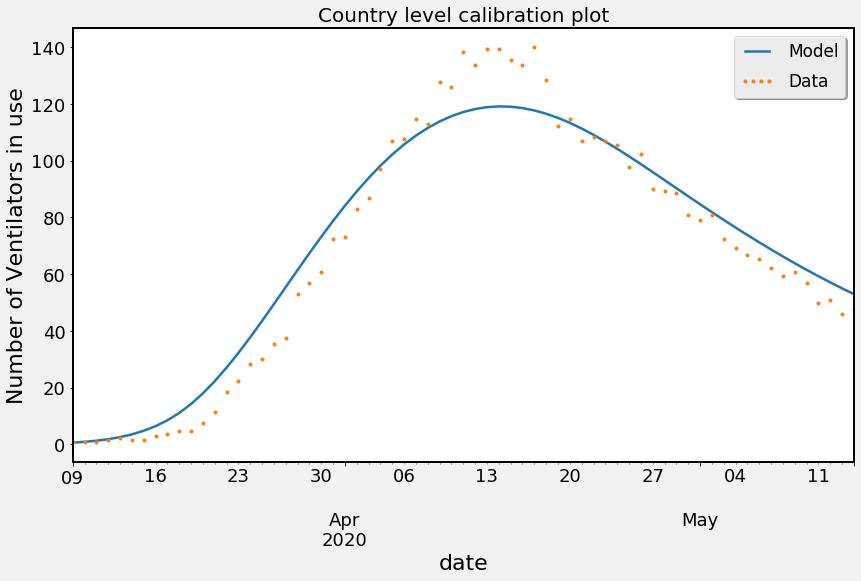

iter:  50  loss:  -23.570761327178783
minimized value: -23.570782982122186
Fitted parameters:
 Eta=0.3887805514600621
 Nu=0.10147781685149859,
 
num of sampling the target function: 19
Results for  2  and for seasonality  60 for tracking  H :
H
Fit Loss: -23.570782982122186
Fitted parameters:
 Eta=0.3887805514600621
 Nu=0.10147781685149859,
 


<Figure size 1008x576 with 0 Axes>

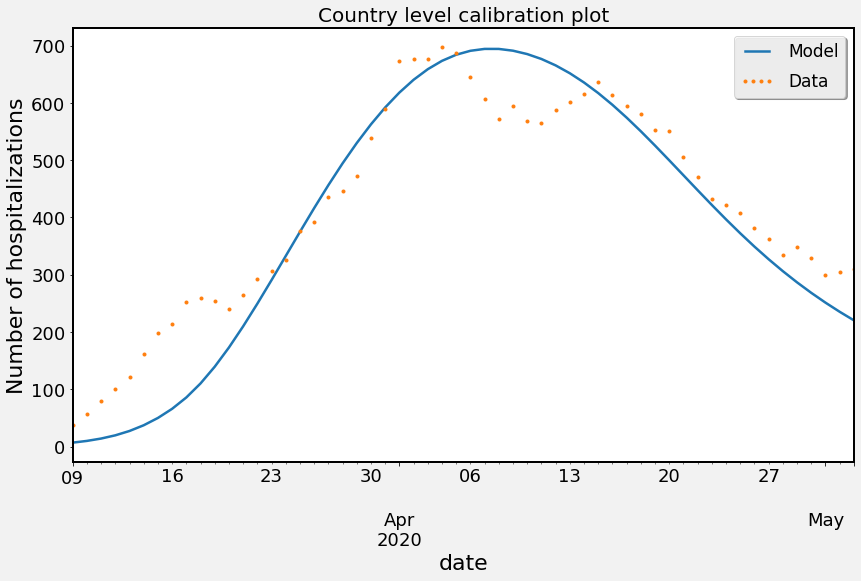

iter:  50  loss:  -27.550619667586812
iter:  100  loss:  -27.859913324906366
iter:  150  loss:  -27.85991921694009
minimized value: -27.85991921694009
Fitted parameters:
 Xi=0.18215973124152074
 Mu=0.05415857361848736,
 
num of sampling the target function: 38
Results for  2  and for seasonality  60 for tracking  Vents :
Vents
0.18215973124152074
Fit Loss: -27.85991921694009
Fitted parameters:
 Xi=0.18215973124152074
 Mu=0.05415857361848736,
 


<Figure size 1008x576 with 0 Axes>

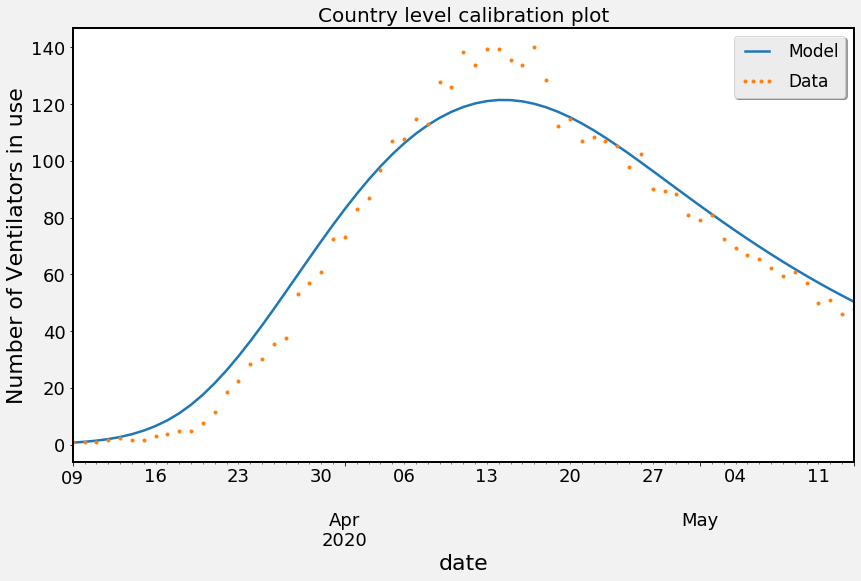

iter:  50  loss:  -23.624583735519156
iter:  100  loss:  -23.631560747640442
iter:  150  loss:  -23.632926125920427
minimized value: -23.63292612618156
Fitted parameters:
 Eta=0.3445539244144613
 Nu=0.09569408294106502,
 
num of sampling the target function: 40
Results for  2  and for seasonality  -1 for tracking  H :
H
Fit Loss: -23.63292612618156
Fitted parameters:
 Eta=0.3445539244144613
 Nu=0.09569408294106502,
 


<Figure size 1008x576 with 0 Axes>

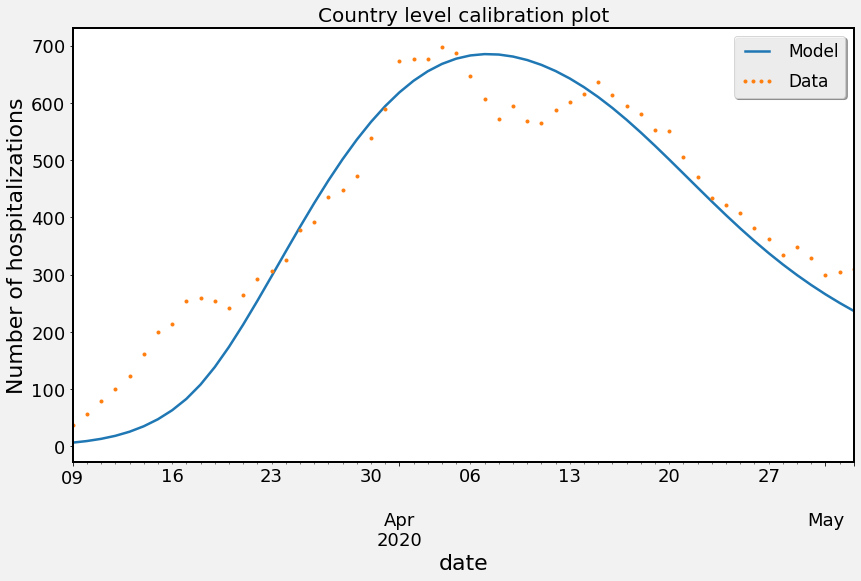

iter:  50  loss:  -27.514007803115373
iter:  100  loss:  -27.57869408550343
iter:  150  loss:  -27.578701915423647
minimized value: -27.578701915423647
Fitted parameters:
 Xi=0.1800060195913626
 Mu=0.05022055118297425,
 
num of sampling the target function: 38
Results for  2  and for seasonality  -1 for tracking  Vents :
Vents
0.1800060195913626
Fit Loss: -27.578701915423647
Fitted parameters:
 Xi=0.1800060195913626
 Mu=0.05022055118297425,
 


<Figure size 1008x576 with 0 Axes>

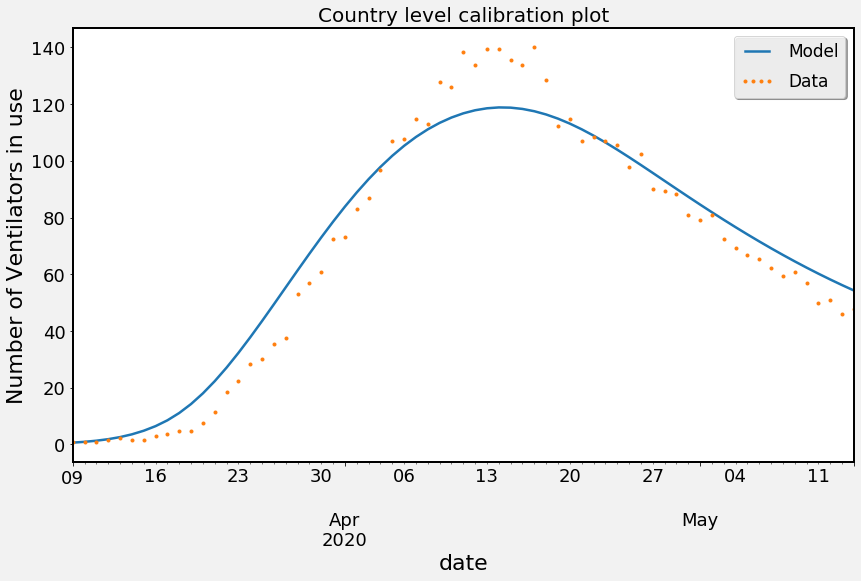

iter:  50  loss:  -23.70167319463731
iter:  100  loss:  -23.70480392561649
minimized value: -23.704814382579997
Fitted parameters:
 Eta=0.371547340582379
 Nu=0.09211446622938824,
 
num of sampling the target function: 35
Results for  2  and for seasonality  - for tracking  H :
H
Fit Loss: -23.704814382579997
Fitted parameters:
 Eta=0.371547340582379
 Nu=0.09211446622938824,
 


<Figure size 1008x576 with 0 Axes>

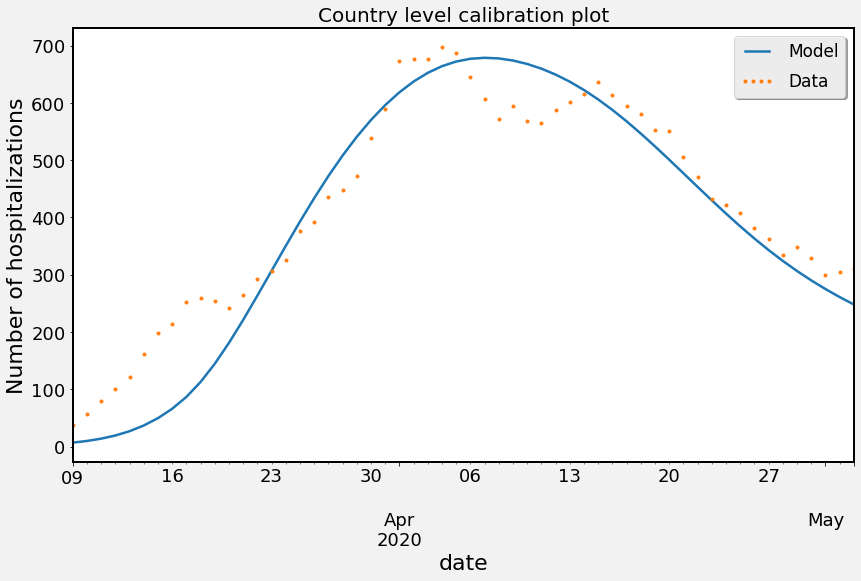

iter:  50  loss:  -27.312378518007318
iter:  100  loss:  -27.37296711519876
iter:  150  loss:  -27.37298549714804
minimized value: -27.37298549714804
Fitted parameters:
 Xi=0.19189160288564094
 Mu=0.04742195990166104,
 
num of sampling the target function: 37
Results for  2  and for seasonality  - for tracking  Vents :
Vents
0.19189160288564094
Fit Loss: -27.37298549714804
Fitted parameters:
 Xi=0.19189160288564094
 Mu=0.04742195990166104,
 


<Figure size 1008x576 with 0 Axes>

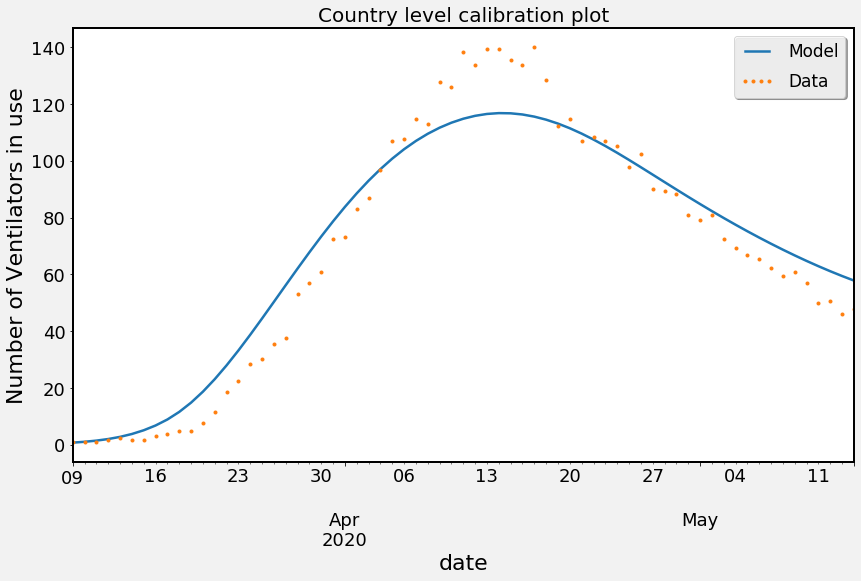

iter:  50  loss:  -23.831406253503946
iter:  100  loss:  -23.840910210102553
iter:  150  loss:  -23.841013790631287
minimized value: -23.84101379065851
Fitted parameters:
 Eta=0.5526570632588963
 Nu=0.08947732826859495,
 
num of sampling the target function: 39
Results for  3  and for seasonality  29 for tracking  H :
H
Fit Loss: -23.84101379065851
Fitted parameters:
 Eta=0.5526570632588963
 Nu=0.08947732826859495,
 


<Figure size 1008x576 with 0 Axes>

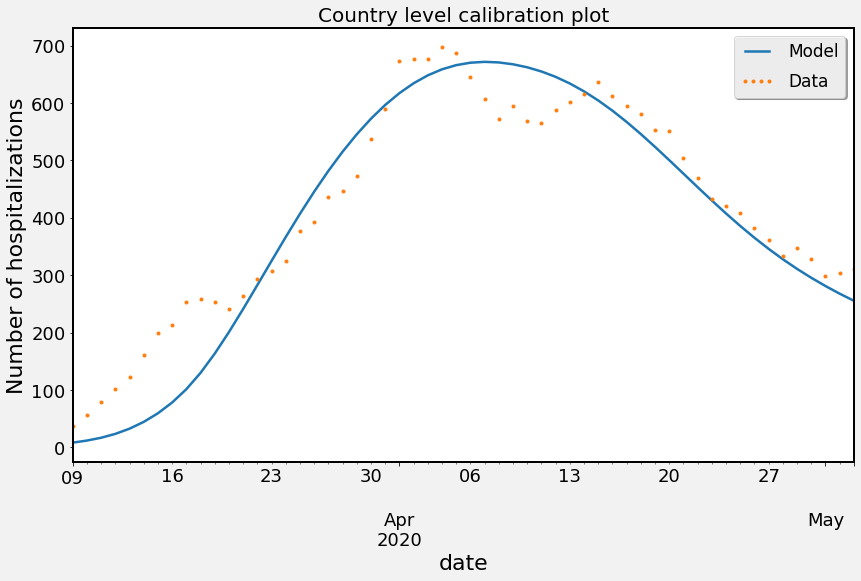

iter:  50  loss:  -26.45754401929486
iter:  100  loss:  -27.297716214621538
minimized value: -27.29771621528469
Fitted parameters:
 Xi=0.2242875485381502
 Mu=0.046176906410226704,
 
num of sampling the target function: 27
Results for  3  and for seasonality  29 for tracking  Vents :
Vents
0.2242875485381502
Fit Loss: -27.29771621528469
Fitted parameters:
 Xi=0.2242875485381502
 Mu=0.046176906410226704,
 


<Figure size 1008x576 with 0 Axes>

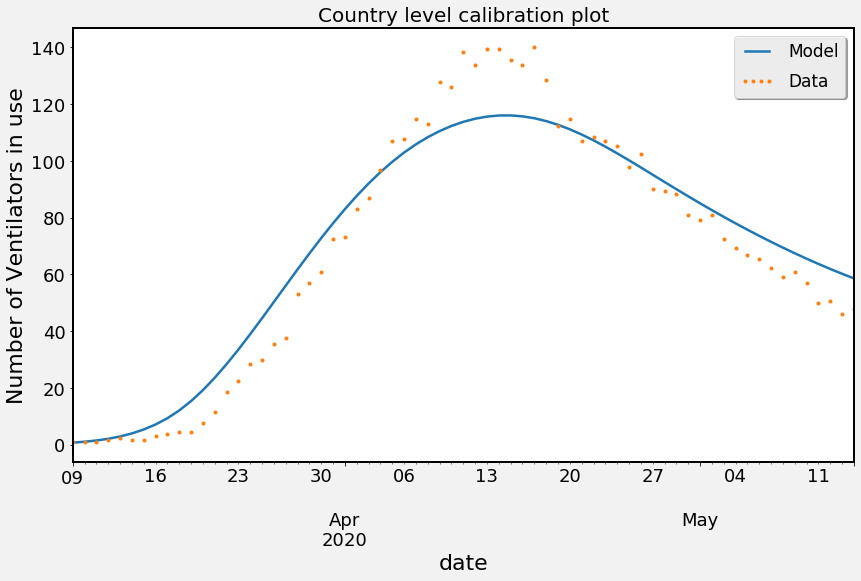

iter:  50  loss:  -23.65551026786044
iter:  100  loss:  -23.671509891611358
minimized value: -23.671509893886476
Fitted parameters:
 Eta=0.30013497325784966
 Nu=0.09125816933598968,
 
num of sampling the target function: 27
Results for  3  and for seasonality  60 for tracking  H :
H
Fit Loss: -23.671509893886476
Fitted parameters:
 Eta=0.30013497325784966
 Nu=0.09125816933598968,
 


<Figure size 1008x576 with 0 Axes>

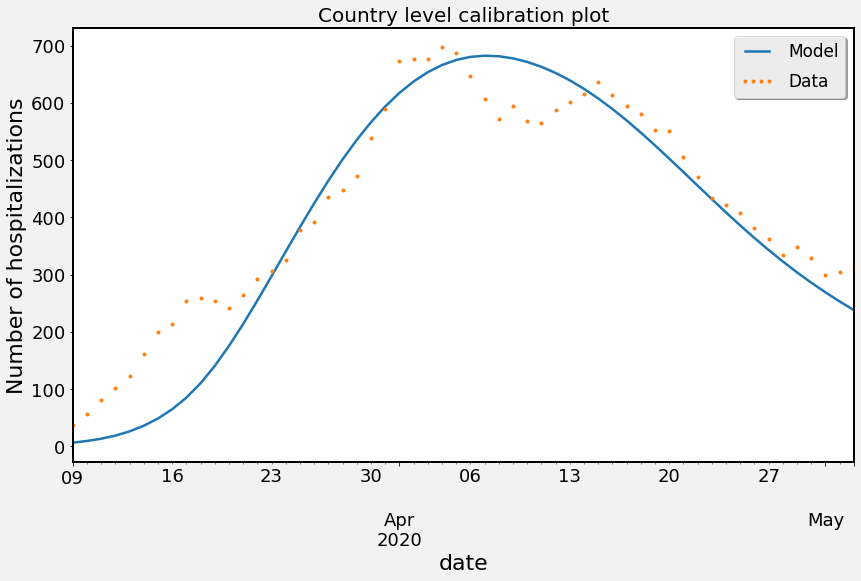

iter:  50  loss:  -26.85100073390435
iter:  100  loss:  -27.530316550064356
iter:  150  loss:  -27.530837868216096
minimized value: -27.53083786867038
Fitted parameters:
 Xi=0.16973269811099667
 Mu=0.04794558155420464,
 
num of sampling the target function: 40
Results for  3  and for seasonality  60 for tracking  Vents :
Vents
0.16973269811099667
Fit Loss: -27.53083786867038
Fitted parameters:
 Xi=0.16973269811099667
 Mu=0.04794558155420464,
 


<Figure size 1008x576 with 0 Axes>

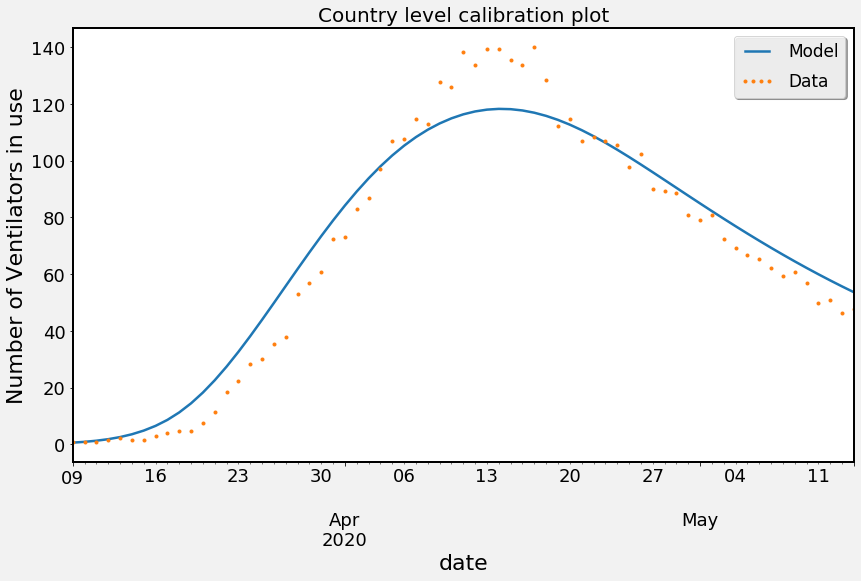

iter:  50  loss:  -23.791980755373686
iter:  100  loss:  -23.79219174055653
minimized value: -23.79219768305316
Fitted parameters:
 Eta=0.39137883258057493
 Nu=0.08521945535797953,
 
num of sampling the target function: 33
Results for  3  and for seasonality  -1 for tracking  H :
H
Fit Loss: -23.79219768305316
Fitted parameters:
 Eta=0.39137883258057493
 Nu=0.08521945535797953,
 


<Figure size 1008x576 with 0 Axes>

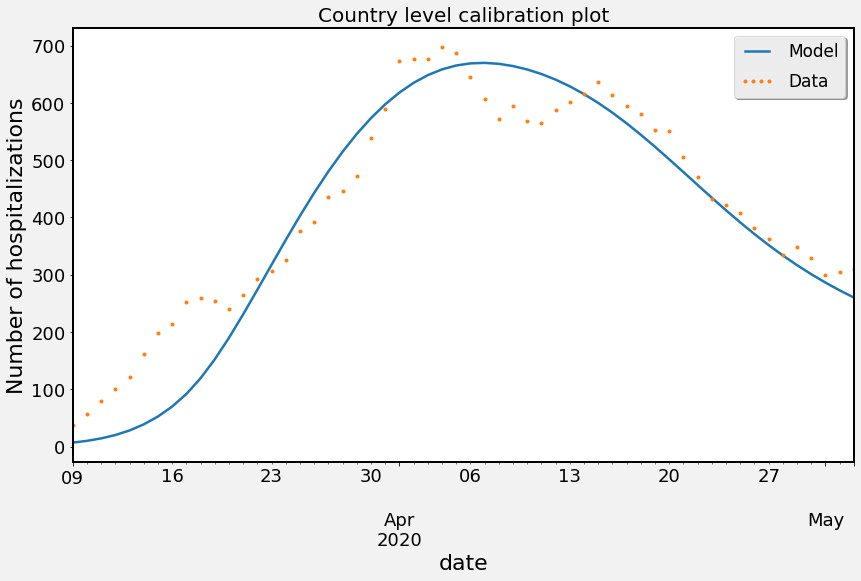

iter:  50  loss:  -27.114155620155316
iter:  100  loss:  -27.152810035698927
iter:  150  loss:  -27.152810867538623
minimized value: -27.15281086758488
Fitted parameters:
 Xi=0.20688545688032162
 Mu=0.04247514739126357,
 
num of sampling the target function: 39
Results for  3  and for seasonality  -1 for tracking  Vents :
Vents
0.20688545688032162
Fit Loss: -27.15281086758488
Fitted parameters:
 Xi=0.20688545688032162
 Mu=0.04247514739126357,
 


<Figure size 1008x576 with 0 Axes>

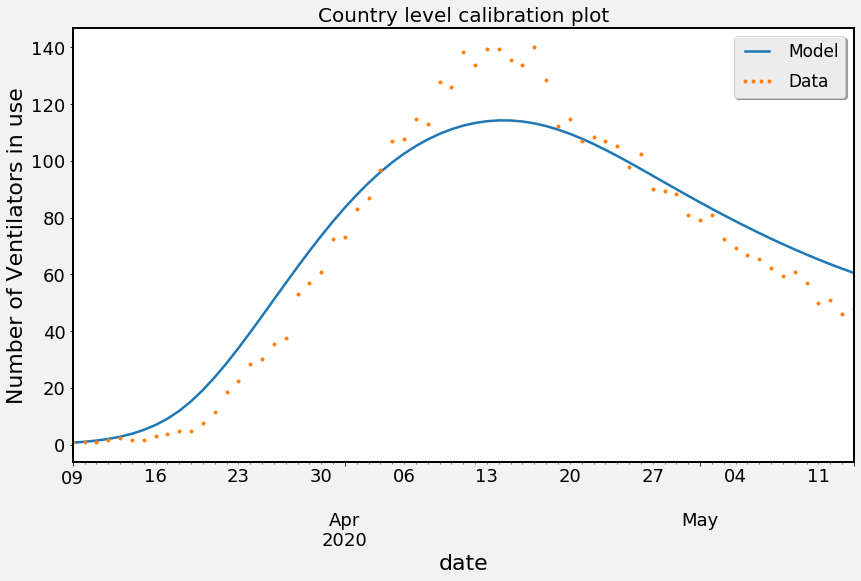

iter:  50  loss:  -23.674618430851
iter:  100  loss:  -23.779704391971425
minimized value: -23.779771278653683
Fitted parameters:
 Eta=0.34396575108702876
 Nu=0.08635698322719171,
 
num of sampling the target function: 34
Results for  3  and for seasonality  - for tracking  H :
H
Fit Loss: -23.779771278653683
Fitted parameters:
 Eta=0.34396575108702876
 Nu=0.08635698322719171,
 


<Figure size 1008x576 with 0 Axes>

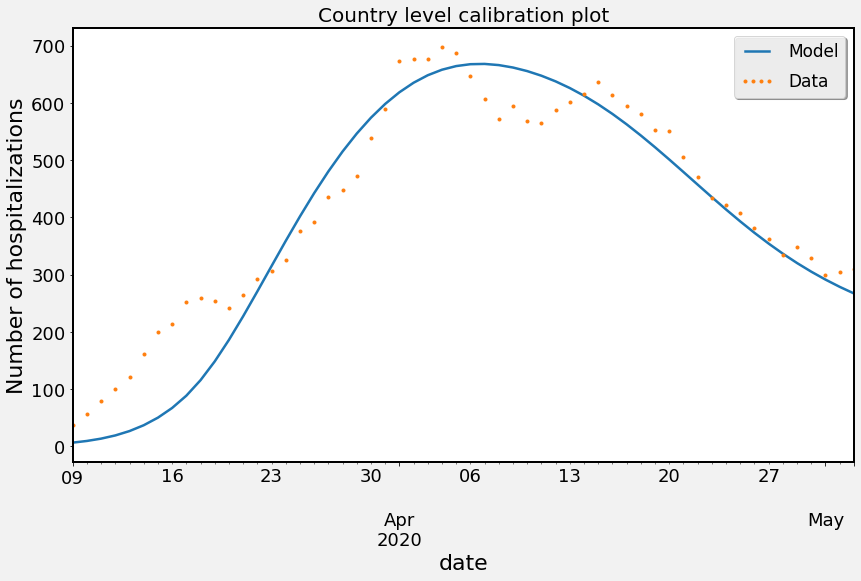

iter:  50  loss:  -26.532874349157165
minimized value: -27.118825204200323
Fitted parameters:
 Xi=0.18993466458146896
 Mu=0.04439373854703821,
 
num of sampling the target function: 22
Results for  3  and for seasonality  - for tracking  Vents :
Vents
0.18993466458146896
Fit Loss: -27.118825204200323
Fitted parameters:
 Xi=0.18993466458146896
 Mu=0.04439373854703821,
 


<Figure size 1008x576 with 0 Axes>

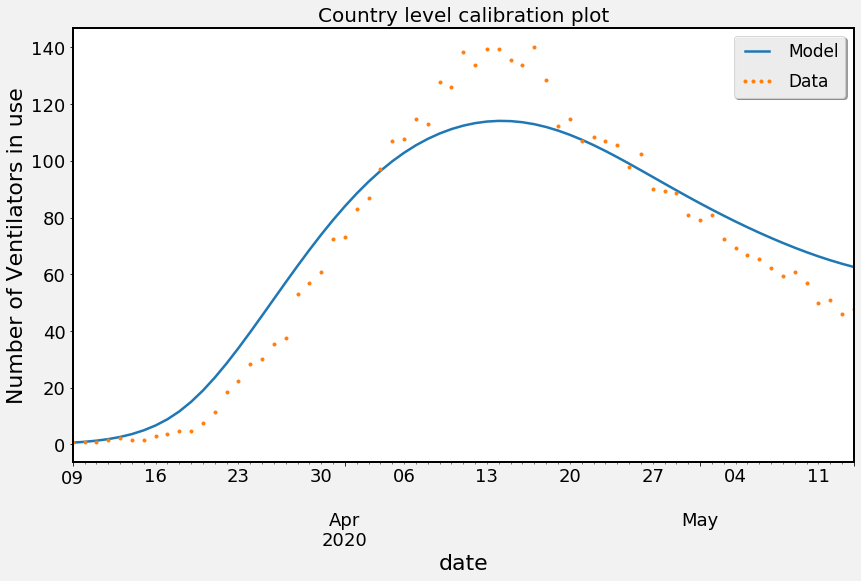

iter:  50  loss:  -23.651460359052226
iter:  100  loss:  -23.68449331424525
minimized value: -23.68449331825459
Fitted parameters:
 Eta=0.3160587143782718
 Nu=0.09197181468632898,
 
num of sampling the target function: 27
Results for  4  and for seasonality  29 for tracking  H :
H
Fit Loss: -23.68449331825459
Fitted parameters:
 Eta=0.3160587143782718
 Nu=0.09197181468632898,
 


<Figure size 1008x576 with 0 Axes>

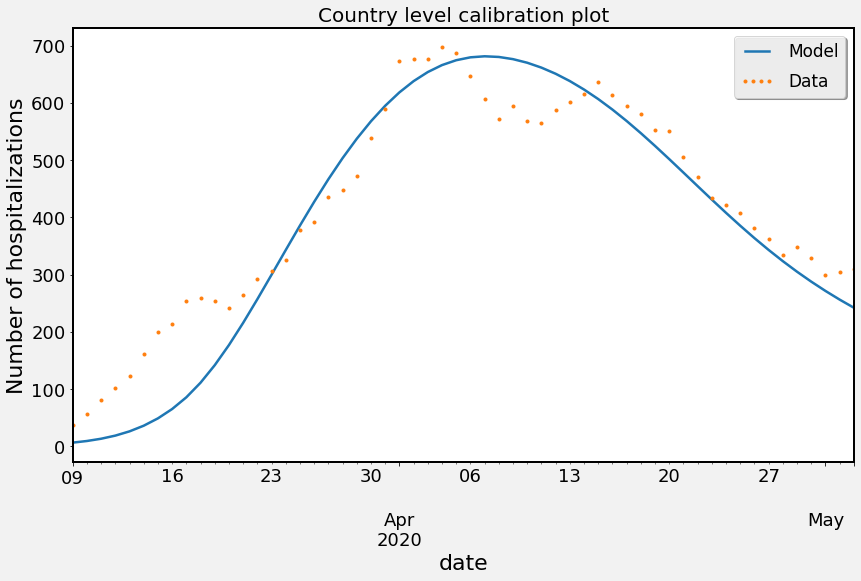

iter:  50  loss:  -26.66093095932717
iter:  100  loss:  -27.385263723293548
iter:  150  loss:  -27.38540026453319
minimized value: -27.38540026453554
Fitted parameters:
 Xi=0.19021819855597205
 Mu=0.04485296406144301,
 
num of sampling the target function: 39
Results for  4  and for seasonality  29 for tracking  Vents :
Vents
0.19021819855597205
Fit Loss: -27.38540026453554
Fitted parameters:
 Xi=0.19021819855597205
 Mu=0.04485296406144301,
 


<Figure size 1008x576 with 0 Axes>

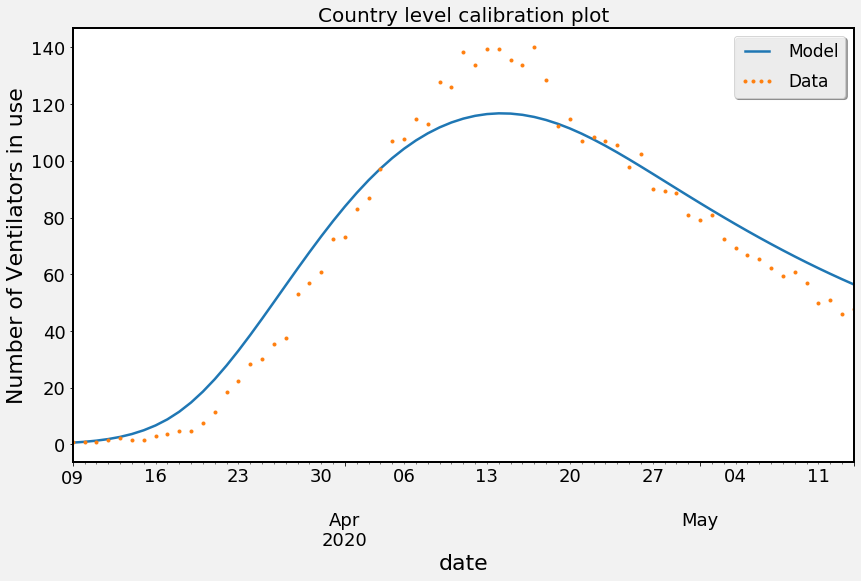

iter:  50  loss:  -23.62624825933127
iter:  100  loss:  -23.642561559691753
minimized value: -23.642561569068715
Fitted parameters:
 Eta=0.32048659945721025
 Nu=0.0941177584378361,
 
num of sampling the target function: 26
Results for  4  and for seasonality  60 for tracking  H :
H
Fit Loss: -23.642561569068715
Fitted parameters:
 Eta=0.32048659945721025
 Nu=0.0941177584378361,
 


<Figure size 1008x576 with 0 Axes>

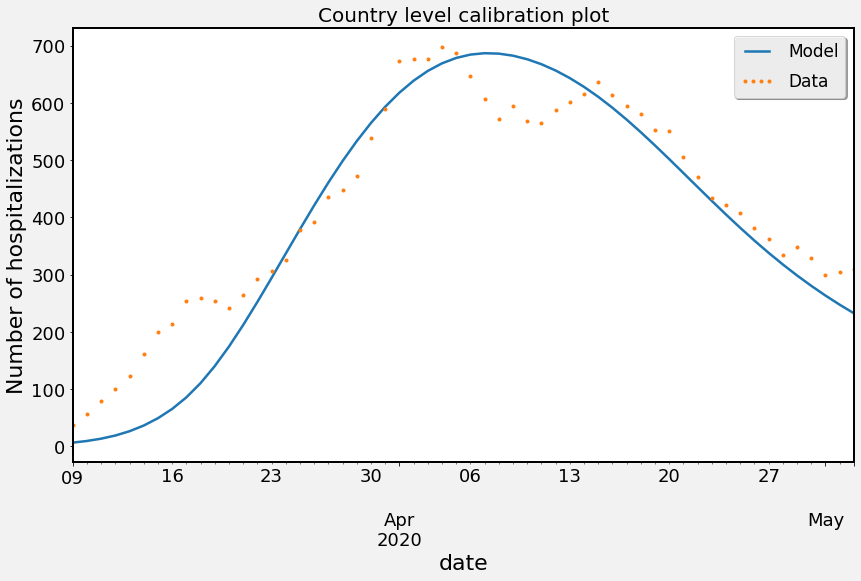

iter:  50  loss:  -26.668045020598626
iter:  100  loss:  -27.477711828219487
minimized value: -27.477722685802338
Fitted parameters:
 Xi=0.19648281839698867
 Mu=0.04465678499071157,
 
num of sampling the target function: 34
Results for  4  and for seasonality  60 for tracking  Vents :
Vents
0.19648281839698867
Fit Loss: -27.477722685802338
Fitted parameters:
 Xi=0.19648281839698867
 Mu=0.04465678499071157,
 


<Figure size 1008x576 with 0 Axes>

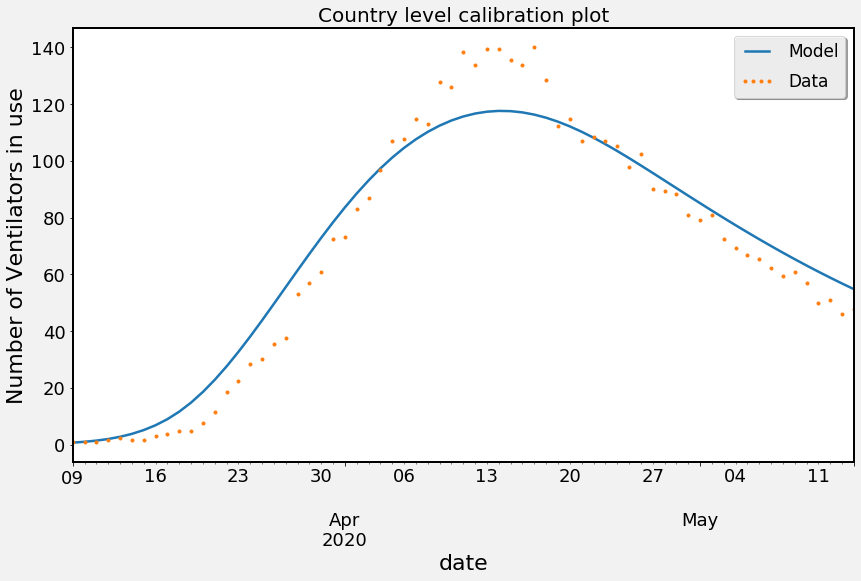

iter:  50  loss:  -23.79020446318259
iter:  100  loss:  -23.79136530401752
minimized value: -23.79136989141752
Fitted parameters:
 Eta=0.4420426266893188
 Nu=0.09185319191754177,
 
num of sampling the target function: 31
Results for  4  and for seasonality  -1 for tracking  H :
H
Fit Loss: -23.79136989141752
Fitted parameters:
 Eta=0.4420426266893188
 Nu=0.09185319191754177,
 


<Figure size 1008x576 with 0 Axes>

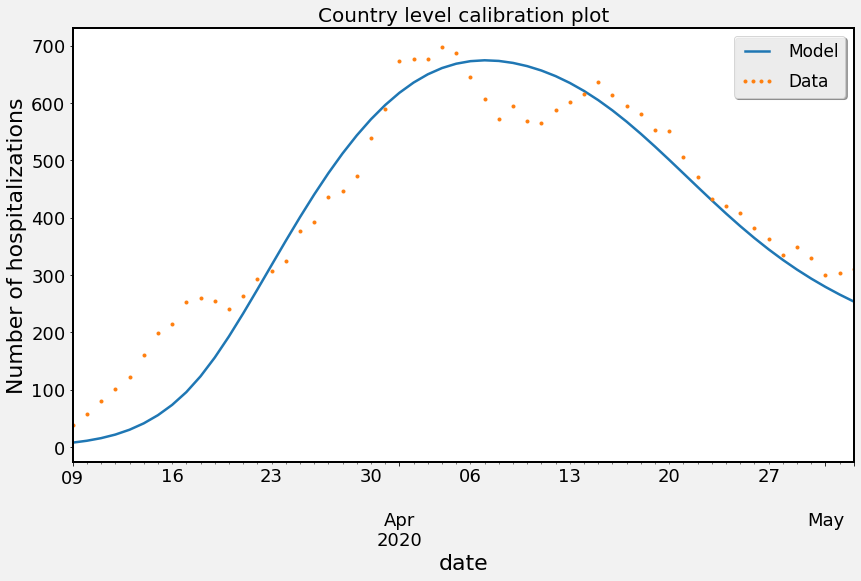

iter:  50  loss:  -27.33623472401865
iter:  100  loss:  -27.387898739056986
minimized value: -27.387898739191286
Fitted parameters:
 Xi=0.19873856650512928
 Mu=0.04892100123406684,
 
num of sampling the target function: 24
Results for  4  and for seasonality  -1 for tracking  Vents :
Vents
0.19873856650512928
Fit Loss: -27.387898739191286
Fitted parameters:
 Xi=0.19873856650512928
 Mu=0.04892100123406684,
 


<Figure size 1008x576 with 0 Axes>

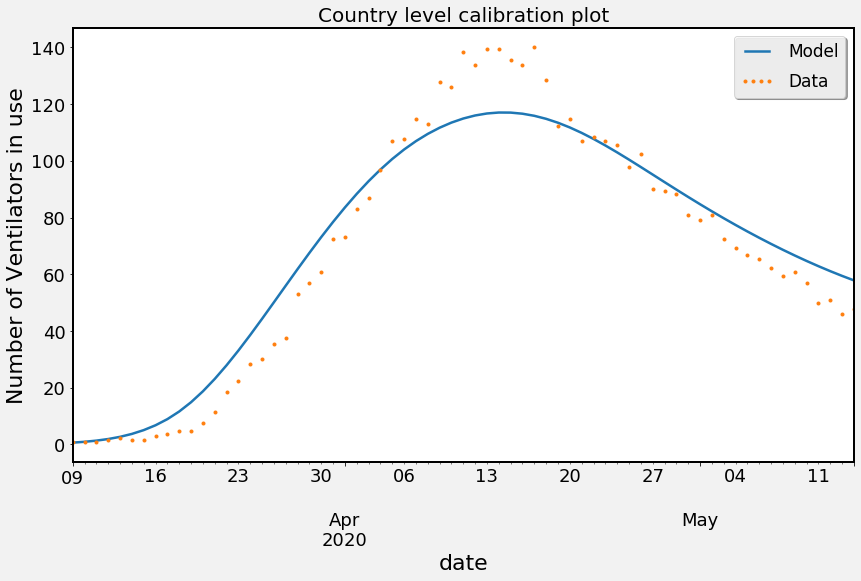

iter:  50  loss:  -22.7083756189972
iter:  100  loss:  -23.683108391921923
minimized value: -23.82089362539136
Fitted parameters:
 Eta=1.0
 Nu=0.03878459375013282,
 
num of sampling the target function: 35
Results for  4  and for seasonality  - for tracking  H :
H
Fit Loss: -23.82089362539136
Fitted parameters:
 Eta=1.0
 Nu=0.03878459375013282,
 


<Figure size 1008x576 with 0 Axes>

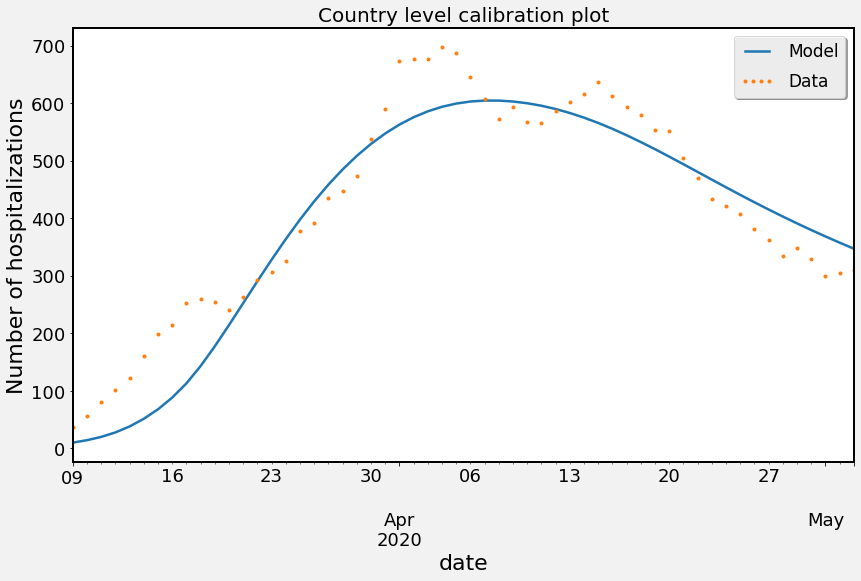

iter:  50  loss:  -25.031446224455244
iter:  100  loss:  -25.42445679246085
iter:  150  loss:  -25.439050100224254
minimized value: -25.439050100224254
Fitted parameters:
 Xi=1.0
 Mu=0.0022634736267057587,
 
num of sampling the target function: 37
Results for  4  and for seasonality  - for tracking  Vents :
Vents
1.0
Fit Loss: -25.439050100224254
Fitted parameters:
 Xi=1.0
 Mu=0.0022634736267057587,
 


<Figure size 1008x576 with 0 Axes>

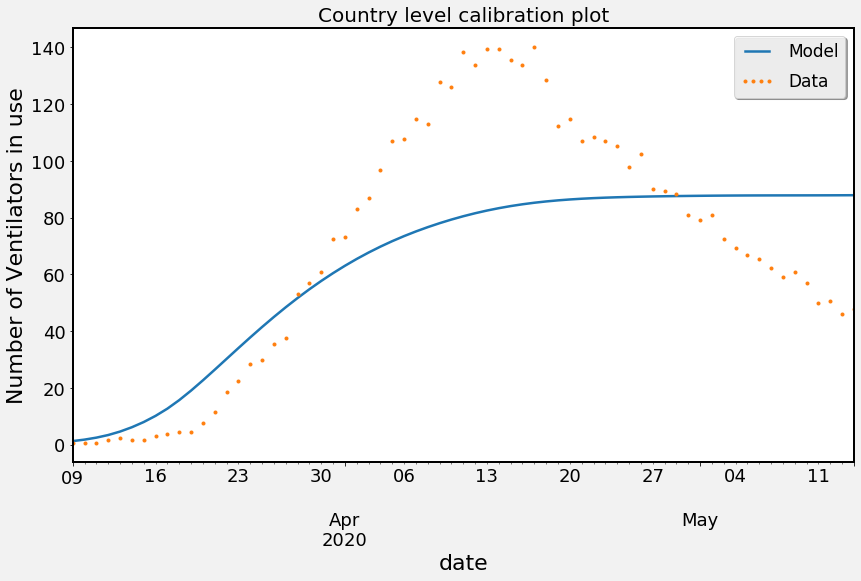

In [6]:
for scen in [mdl.num2scen(i) for i in [1, 2, 3, 4]]:
    for phase in [29, 60, -1, '-']:
#         mdl.show_calibration(
#             ind,
#             int(scen[-1]),
#             phase,
#         )
#         run calibration for model parameters
#         mdl.make_calibration(
#             scen,
#             phase,
#             ind,
#             no_mobility=True,
#         )
        
#         run calibration for model tracking states
        mdl.make_track_calibration(
            scen,
            phase,
            ind,
        )

# Running manually:

In [4]:
# loads mapping 250 to 20:
with open('../Data/division_choice/250_to_30/250_to_30_region_mapper.pickle', 'rb') as pickle_in:
    region_250_to_30 = pickle.load(pickle_in)
with open('../Data/division_choice/250_to_30/250_to_30_region_age_mapper.pickle', 'rb') as pickle_in:
    region_age_250_to_30 = pickle.load(pickle_in)
with open('../Data/division_choice/250_to_30/250_to_30_region_ga_mapper.pickle', 'rb') as pickle_in:
    region_ga_250_to_30 = pickle.load(pickle_in)

# Amit Model play for initial values of calibration

## Data Loading

In [5]:
first = pd.Timestamp('2020-03-03')
last = pd.Timestamp('2020-05-01')
tot = pd.read_csv('../Data/sick/all_tests_by_age_county.csv')
pos = pd.read_csv('../Data/sick/smooth_sick_by_age_calibration_county.csv')
pos.set_index('Unnamed: 1', inplace=True)
pos.columns = ['county'] + list(pos.columns)[1:]
pos.sort_values(by='county', inplace=True)
pos = pos.pivot(columns='county')
pos.columns = pos.columns.swaplevel(0, 1)
pos = pos.reindex(pd.MultiIndex.from_product([region_250_to_30.keys(), ind.A.values()]), axis=1)
pos.index = pd.to_datetime(pos.index)
pos = pos.reindex(pd.date_range(pos.index.values.min(), pos.index.values.max(),freq='d'), fill_value=0)
pos.fillna(0, inplace=True)

begining = pos.index.values.min()
ending = pos.index.values.max()
pos = pos.reindex(pd.date_range(begining, ending,freq='d'), fill_value=0)

# Shifting data by 5 days for fit
pos_0303 = pos.loc['2020-03-03':].copy() #starting the fit from March 3rd 2020

shift_date_list = pd.date_range('2020-02-27',freq='d',periods=pos_0303.shape[0])

pos_0303['shift_date'] = shift_date_list

pos_0303.set_index('shift_date',inplace=True)
data = np.ndarray((2,len(pos_0303), len(region_age_250_to_30.keys())))
data[0] = np.zeros(pos_0303.shape) # insert the tested positive specimens only for relevant calibration period 
data[1] = pos_0303

pos_0303.iloc[-1]

11         0-4      0.022663
           5-9      0.036512
           10-19    0.146049
           20-29    0.209001
           30-39    0.138495
                      ...   
71_haredi  30-39    0.182437
           40-49    0.262253
           50-59    0.127706
           60-69    0.043329
           70+      0.025085
Name: 2020-05-01 00:00:00, Length: 270, dtype: float64

## Define and run model

In [184]:
# fit params
start = pos_0303.index[0]
end = pos_0303.index[-1]
date_lst = pd.date_range('2020-02-20',end)
len(date_lst)

72

In [185]:
scen = 'Scenario1'
model = mdl.Model_behave(
    ind=ind,
    beta_j=np.array([0.10167117, 0.10167117, 0.10167117, 0.05606748, 0.05606748,
       0.04709613, 0.04709613, 0.25676354, 0.25676354])*0.4,
    theta=2.0684200685446243,
    beta_behave=0.38,
    scen=scen,
    seasonality=True
    
)
res_mdl = model.predict(
    C=mdl.C_calibration,
    days_in_season=len(date_lst),
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)
res_mdl, _ = mdl.multi_inter_by_name(
    ind, 
    model, 
    mdl.pop_israel, 
    [mdl.inter2name(ind, 100, no_risk=False)], 
    sim_length=500, 
    fix_vents=False,
    no_pop=False,
    start=len(date_lst),
)

model.reset()

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2312c630>)

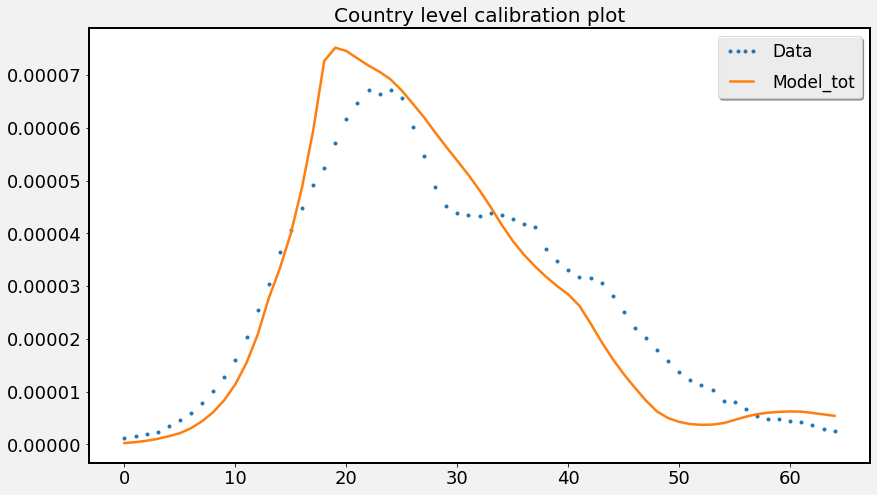

In [186]:
mdl.plot_calibrated_total_model(pd.DataFrame(data[1])/mdl.pop_israel, res_mdl, date_lst, start=start,end=end)
# plt.vlines(x=14,ymin=0, ymax=0.0001)
# plt.vlines(x=23-6,ymin=0, ymax=0.0001, color='r')

In [123]:
res_mdl['new_Is'].sum()

0.19212058884311065

In [124]:
model.noise

2.1891418563922943e-07

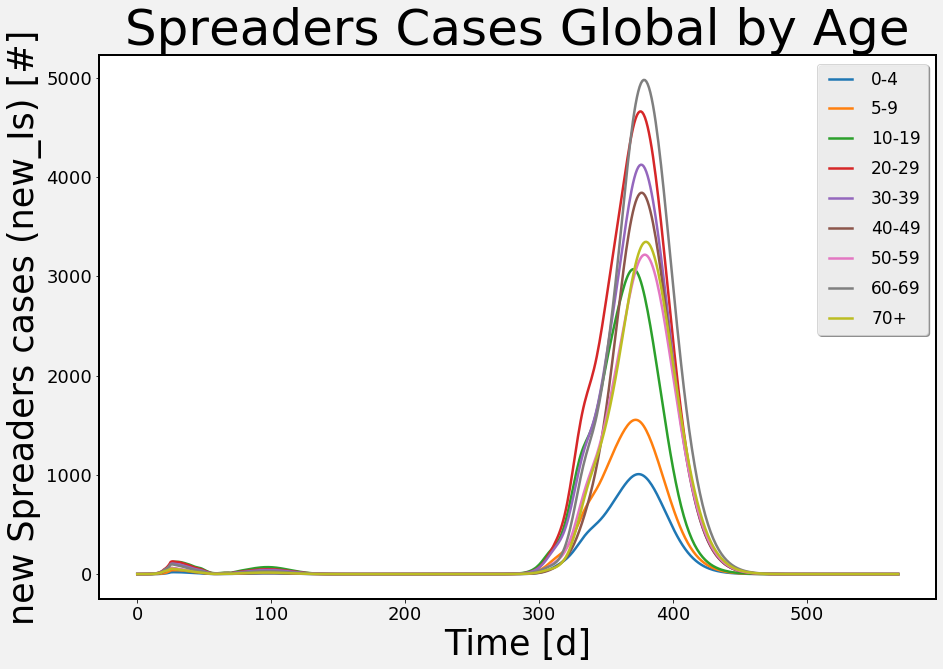

(<Figure size 1080x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x48761b70>)

In [125]:
mdl.plot_I_by_age(ind,res_mdl, new_only=True)

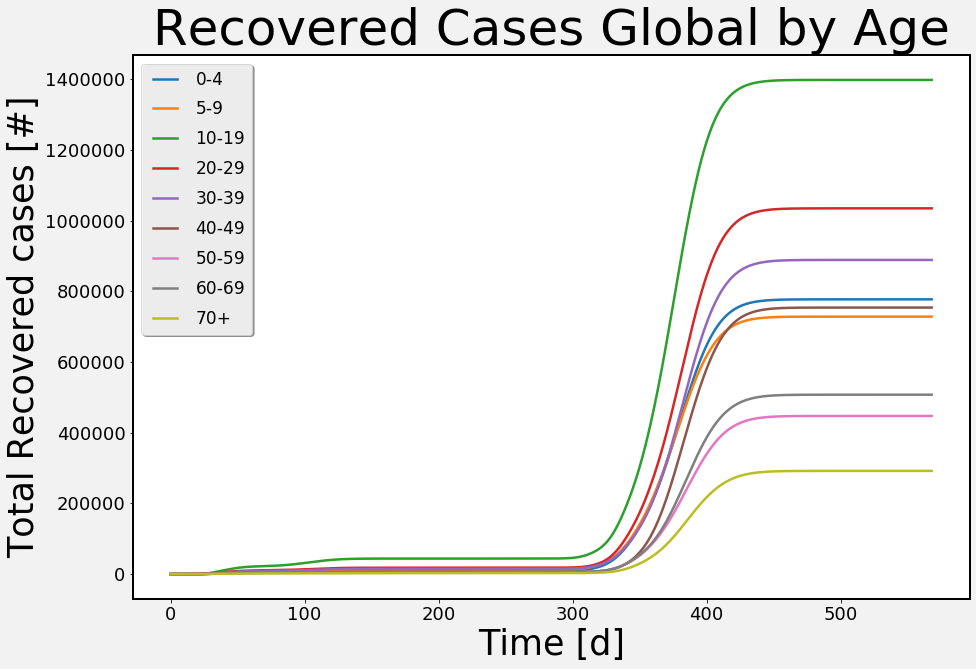

(<Figure size 1080x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x64dd9fd0>)

In [126]:
mdl.plot_R_by_age(ind,res_mdl)

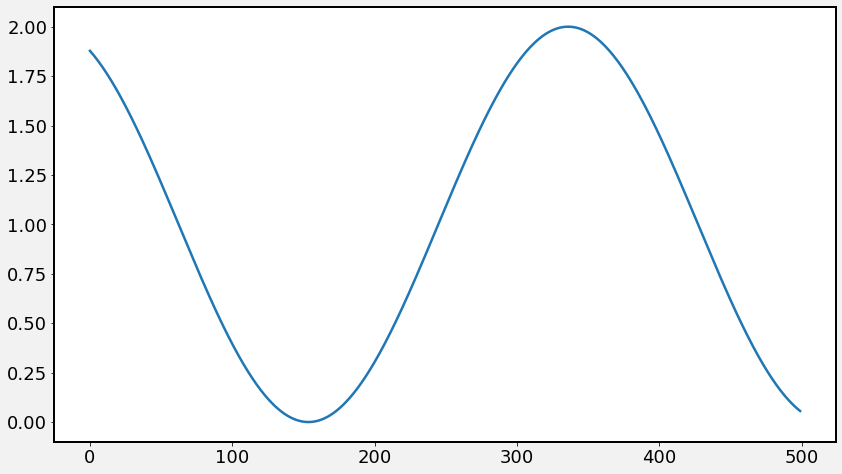

In [127]:
t = np.arange(500)
plt.plot(t, 1 + np.cos((2 * np.pi * (t + model.phi)) / 365.0))

<BarContainer object of 9 artists>

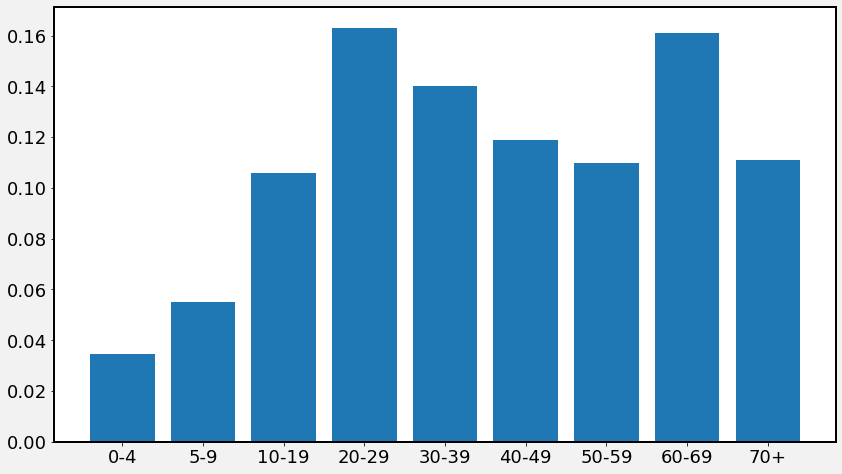

In [128]:
age_pct = []
for age in ind.A.values():
    age_pct.append(res_mdl['new_Is'][:, ind.age_dict[age]].sum()/res_mdl['new_Is'].sum())
plt.bar(list(ind.A.values()), age_pct)

# Model Calibration

## Scenario 1

### $\phi$=29

#### calibrating

In [16]:
scen = 'Scenario1'
seasonality = True

In [10]:
# fit params
start = pos_0303.index[0]
end = pos_0303.index[-1]
date_lst = pd.date_range('2020-02-20',end)
len(date_lst)

72

In [11]:
model_1_ml = mdl.Model_behave(
    ind=ind,
    beta_j=np.array([0.10167117, 0.10167117, 0.10167117, 0.05606748, 0.05606748,
       0.04709613, 0.04709613, 0.25676354, 0.25676354])*0.4,
    theta=2.0684200685446243,
    beta_behave=0.38,
    scen=scen,
    seasonality=seasonality,
)

In [12]:
# Model Fitting
p0=(0.04066847,0.02242699,0.01883845,0.10270542,2.0684200685446243, 0.38) # initial guess
bnds = ((0,0.3),(0,0.2),(0,0.2),(0,0.6),(1.5,3),(0,0.6))# boundries for variables


In [13]:
model_1_ml.reset()

In [14]:
res_fit_1_ml = model_1_ml.fit(
        mapper=region_age_250_to_30,
        p0=p0,
        bnds=bnds,
        data=data,
        date_lst = date_lst,
        start=start,
        end=end,
        loss_func='MSE',
        maxiter=85,
        factor=1,
    )

iter:  50  loss:  -25.99587757666926
curr param: BETAj: 0.0355892132501764   0.022698074177770505   0.01911282794974667   0.10105114145775282   THETA: 2.068670756725096   BEHAVE: 0.3809977228239163
iter:  100  loss:  -25.97920751910449
curr param: BETAj: 0.030283963585466964   0.023510762016217095   0.02611041977497547   0.09637004041498709   THETA: 2.0657794641303022   BEHAVE: 0.40002597295713954
iter:  150  loss:  -26.01113432330506
curr param: BETAj: 0.033372704608322507   0.02308546058487372   0.021683043249767123   0.08251062854999835   THETA: 2.065557694110006   BEHAVE: 0.3941176973747075
iter:  200  loss:  -25.91007143810182
curr param: BETAj: 0.030729968082397488   0.023281766554437783   0.026311588183024787   0.124374691520374   THETA: 2.0756511397151987   BEHAVE: 0.4310788770271457
iter:  250  loss:  -26.0311034612348
curr param: BETAj: 0.03206233997410762   0.023339277601299974   0.019026080876047166   0.08299787468436007   THETA: 2.069297758146071   BEHAVE: 0.44254371164401

In [19]:
mdl.print_stat_fit_behave(res_fit_1_ml)

minimized value: -26.070744073432092
Fitted parameters:
 Beta=[0.02880126 0.02039389 0.01940452 0.08176075]
 Theta=2.08845636544809,
,Beta_behave=0.5297563921760634
num of sampling the target function: 85


In [17]:
res_mdl_1_ml = model_1_ml.predict(
    C=mdl.C_calibration,
    days_in_season=len(date_lst),
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

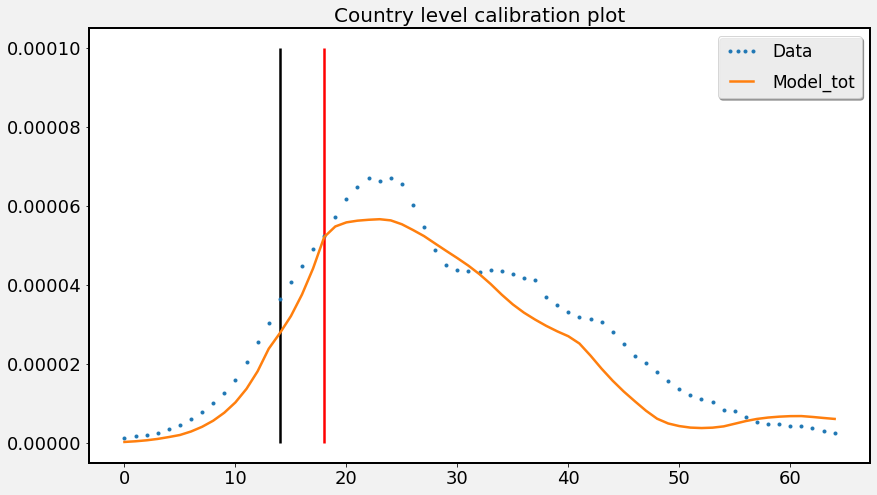

In [18]:
mdl.plot_calibrated_total_model(pd.DataFrame(data[1])/mdl.pop_israel, res_mdl_1_ml, date_lst, start=start,end=end)
plt.vlines(x=14,ymin=0, ymax=0.0001)
plt.vlines(x=23-5,ymin=0, ymax=0.0001, color='r')

(0.974705203675643, 1.0354437008069218e-42)

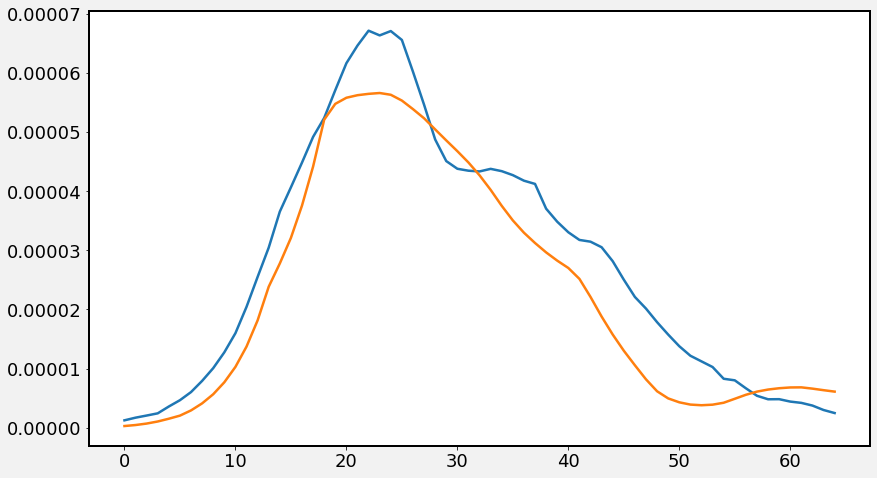

In [20]:
#index to cut model's data
start_idx = int(np.where(date_lst == start)[0])
end_idx = int(np.where(date_lst == end)[0])

# creating DF
model_data_cal = res_mdl_1_ml['new_Is'][start_idx:end_idx + 1,:].sum(axis=1)
data_tot = (pd.DataFrame(data[1])/mdl.pop_israel).sum(axis=1)
plt.plot(range(len(data_tot)),data_tot, model_data_cal)
import scipy
scipy.stats.pearsonr(model_data_cal, data_tot)

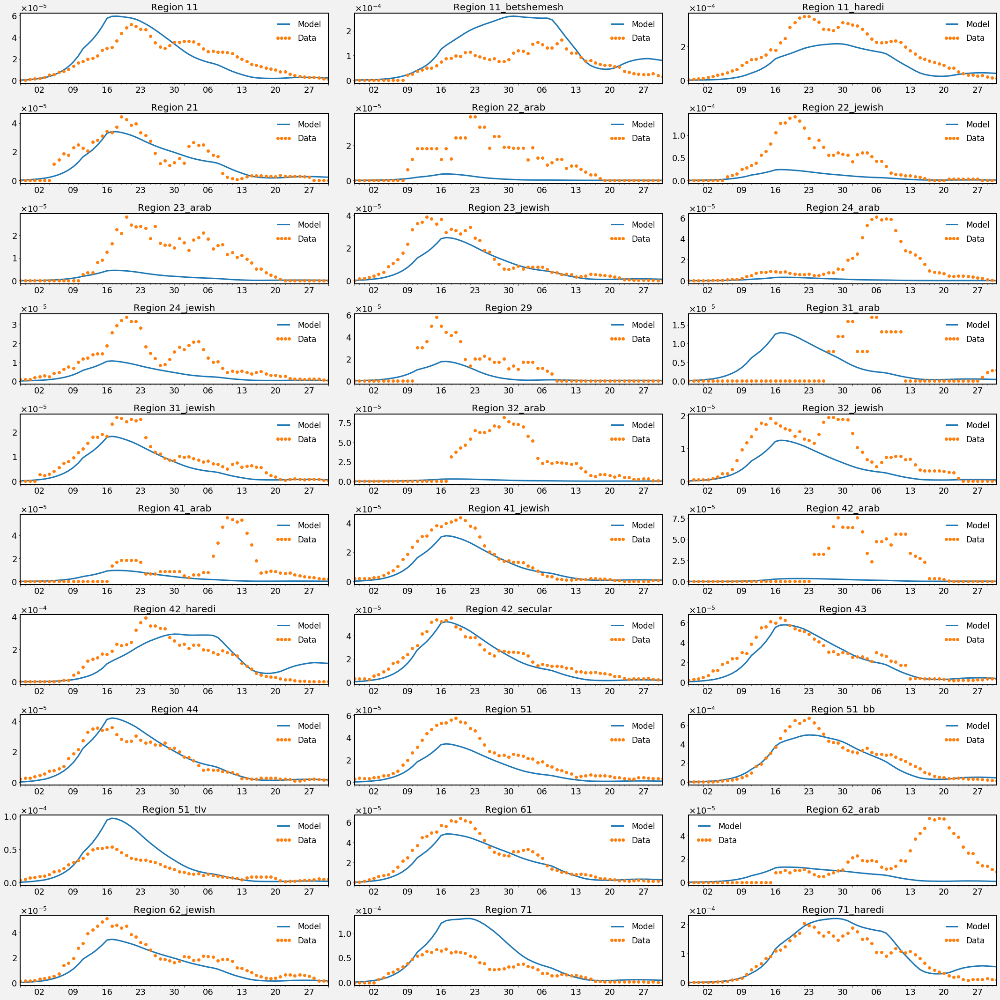

In [22]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(mdl_mapper=region_250_to_30,
                                          data=data, 
                                          mdl_data = res_mdl_1_ml['new_Is'],
                                          date_list = date_lst,
                                          start=start,
                                          end=end,
                                          region_name = {k:k for k in region_250_to_30.keys()},
                                          loss_func = 'MSE',
                                         ind=ind,
                                         data_mapper=region_ga_250_to_30)
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

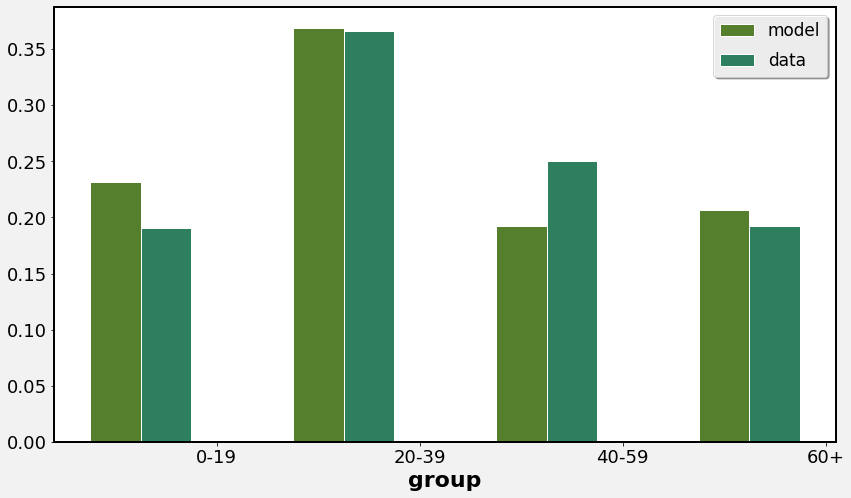

In [23]:
age_cal = [
    ['0-4', '5-9', '10-19'],
    ['20-29', '30-39'],
    ['40-49', '50-59'],
    ['60-69', '70+'],
]
age_name = [
    '0-19', 
    '20-39', 
    '40-59', 
    '60+',
]
age_pct = []
age_pct_data = []
age_model = []
data_age = (pos_0303.sum(axis=0).unstack(level=0).sum(axis=1))/(pos_0303.sum(axis=0).unstack(level=0).sum(axis=1).sum())
for age_list in age_cal:
    idx = []
    for age in age_list:
        idx += list(ind.age_dict[age])
    age_pct.append(res_mdl_1_ml['new_Is'][:, idx].sum()/res_mdl_1_ml['new_Is'].sum())
    age_pct_data.append(data_age.loc[age_list].sum())

# set width of bar
barWidth = 0.25
 
# set height of bar
 
# Set position of bar on X axis
r1 = np.arange(len(age_pct))
r2 = [x - barWidth for x in r1]
r3 = [x + barWidth for x in r2]
 
# Make the plot
plt.bar(r2, age_pct, color='#557f2d', width=barWidth, edgecolor='white', label='model')
plt.bar(r3, age_pct_data, color='#2d7f5e', width=barWidth, edgecolor='white', label='data')
 
# Add xticks on the middle of the group bars
plt.xlabel('group', fontweight='bold')
plt.xticks([r + barWidth for r in range(len(age_name))], age_name)
 
# Create legend & Show graphic
plt.legend()
plt.show()


Text(0.5, 0, 'Time [d]')

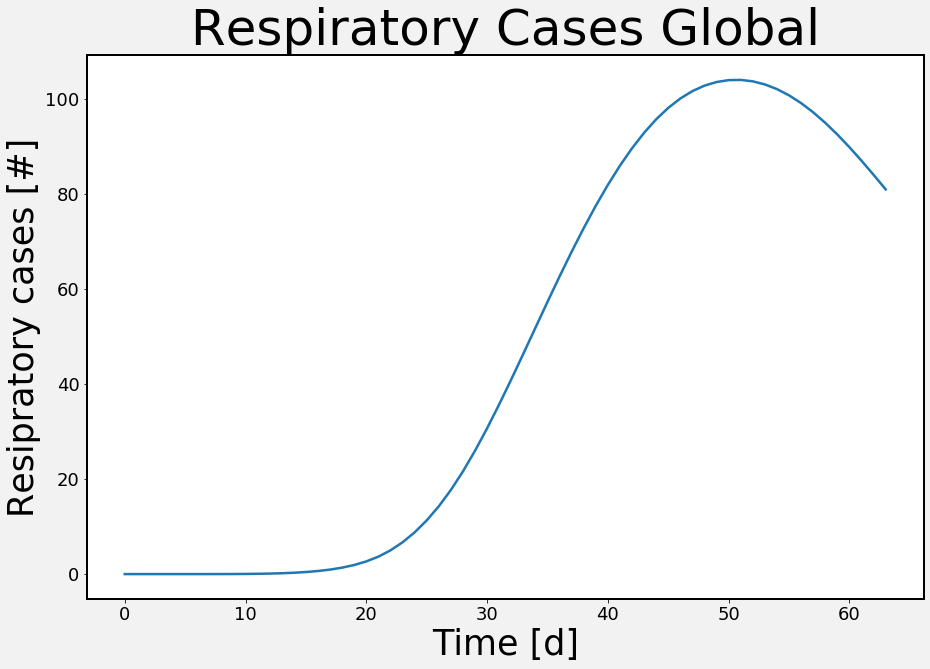

In [24]:
fig, ax = plt.subplots(figsize=(15, 10))
ax.plot(((res_mdl_1_ml['Vents']).sum(axis=1)[:(end-start).days])*isr_pop)
ax.set_ylabel('Resipratory cases [#]', fontsize=35)
ax.set_title('Respiratory Cases Global', fontsize=50)
ax.set_xlabel('Time [d]', fontsize=35)

In [25]:
mdl.save_cal(res_fit_1_ml, ind, scen, 29)

#### running tracking calibration

In [26]:
df = pd.read_csv('../Data/sick/daily_hospital_resp.csv')
df.index = pd.to_datetime(df['Date'], dayfirst=True)
resp = df['resp'].dropna()
hosp = df['hospitalized'].dropna()
# resp = pd.read_csv('../Data/sick/resp_country.csv')
# hosp = pd.read_csv('../Data/sick/hospitalizations_country.csv')

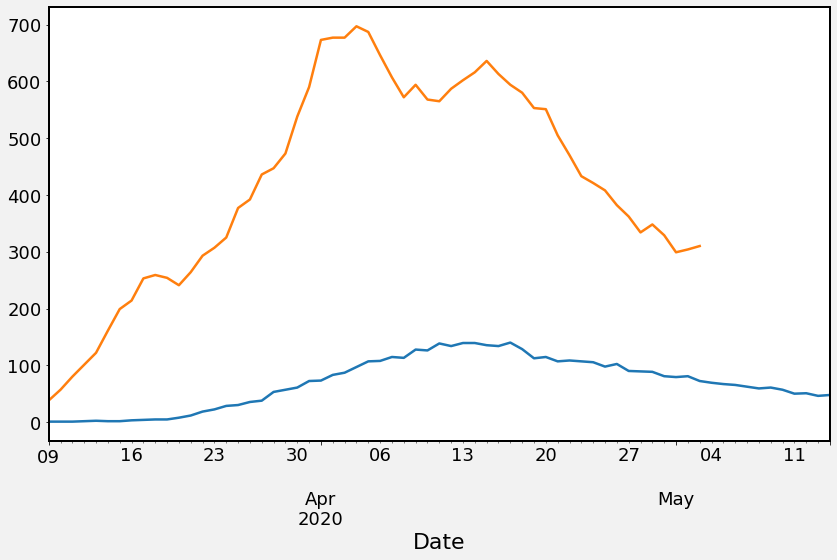

In [27]:
ax= plt.subplot()
resp.plot(ax=ax)
hosp.plot(ax=ax)

In [28]:
scen = 'Scenario1'
scen_idx = int(scen[-1])
seasonality = True
phase = 29
start_sim='2020-02-20'

start_date = hosp.index[0]
end_date = hosp.index[-1]

date_lst = pd.date_range(start_sim,end_date)
len(date_lst)

74

In [29]:
# Model Fitting
p0=(1/7., 0.1) # initial guess
bnds = ((0.05,1.0),(0.05,0.25))# boundries for variables
# bnds = ((0.01,1.0),(0.01,1.0))# boundries for variables

In [30]:
cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')

model_1_no = mdl.Model_behave(
    ind=ind,
    beta_j=cal_parameters[ind.cell_name][(scen_idx, phase)]['beta_j'],
    theta=cal_parameters[ind.cell_name][(scen_idx, phase)]['theta'],
    beta_behave=cal_parameters[ind.cell_name][(scen_idx, phase)]['beta_behave'],
    scen=scen,
    seasonality=seasonality,
)

In [31]:
model_1_no.reset()
res_fit_1_no = model_1_no.fit_tracking(
        p0=p0,
        bnds=bnds,
        data=hosp.values,
        date_lst = date_lst,
        days_in_season=len(date_lst),
        start=start_date,
        end=end_date,
        loss_func='MSE',
        maxiter=300,
        factor=1,
        tracking='hosp'
    )

iter:  50  loss:  -23.891674322334122


In [32]:
mdl.print_stat_fit_hosp(res_fit_1_no)

minimized value: -23.891675129403158
Fitted parameters:
 Eta=0.30953366619909495
 Nu=0.10209092186965754,
 
num of sampling the target function: 21


In [33]:
model_1_no.reset()
res_mdl_1_no = model_1_no.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

(<Figure size 1008x576 with 0 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x3d8af160>)

<Figure size 1008x576 with 0 Axes>

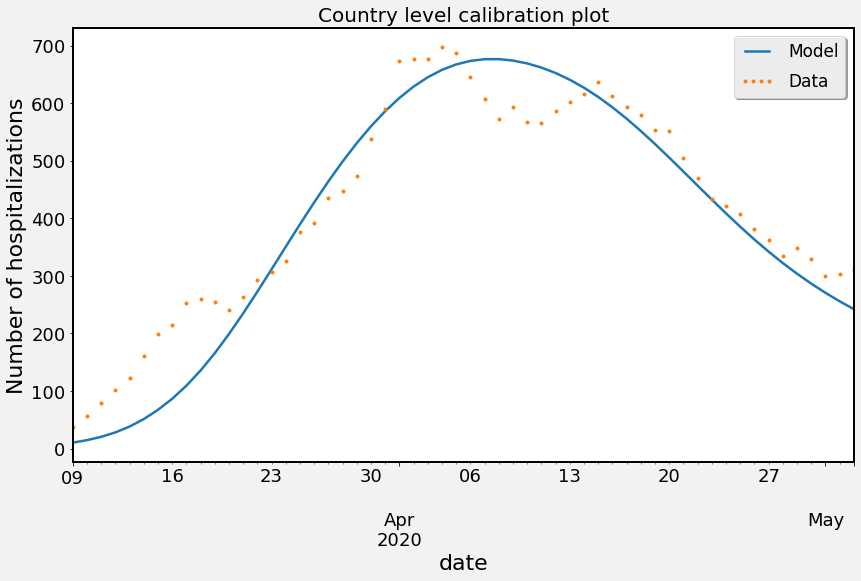

In [34]:
mdl.plot_hospitalizations_calibration(res_mdl_1_no,hosp,date_lst,start_date=start_date,end_date=end_date)

In [37]:
def save_cal_track(res_fit, ind, scen, phase, track):
    if track == 'H':
        cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['eta'] = \
            res_fit.x[0]
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['nu'] = \
            res_fit.x[0]

    elif track == 'Vents':
        cal_parameters = pd.read_pickle(
            '../Data/calibration/calibrattion_dict.pickle')
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['xi'] = \
            res_fit.x[0]
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['mu'] = \
            res_fit.x[0]
    with open('../Data/calibration/calibrattion_dict.pickle', 'wb') as handle:
        pickle.dump(cal_parameters, handle, protocol=pickle.HIGHEST_PROTOCOL)

save_cal_track(res_fit_1_no, ind, scen, phase, 'H')

In [35]:
scen = 'Scenario1'
scen_idx = int(scen[-1])
seasonality = False
phase = '-'
start_sim='2020-02-20'

start_date = resp.index[0]
end_date = resp.index[-1]
date_lst = pd.date_range(start_sim,end_date)
len(date_lst)

85

In [36]:
# Model Fitting
p0=(0.05, 1/9.9) # initial guess
# bnds = ((0.00,1),(1/14.,1/10.))# boundries for variables
bnds = ((0.00,1),(1/21.,1/10.))# boundries for variables

In [38]:
cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')

model_1_no = mdl.Model_behave(
    ind=ind,
    beta_j=cal_parameters[ind.cell_name][(scen_idx, phase)]['beta_j'],
    theta=cal_parameters[ind.cell_name][(scen_idx, phase)]['theta'],
    beta_behave=cal_parameters[ind.cell_name][(scen_idx, phase)]['beta_behave'],
    scen=scen,
    seasonality=seasonality,
)

In [39]:
model_1_no.reset()
res_fit_1_no = model_1_no.fit_tracking(
        p0=p0,
        bnds=bnds,
        data=resp.values,
        date_lst = date_lst,
        days_in_season=len(date_lst),
        start=start_date,
        end=end_date,
        loss_func='MSE',
        maxiter=85,
        factor=1,
        tracking='vents'
    )

iter:  50  loss:  -26.94730867942132
iter:  100  loss:  -27.146628204662292


In [40]:
mdl.print_stat_fit_hosp(res_fit_1_no, tracking='vents')

minimized value: -27.146632102689843
Fitted parameters:
 Xi=0.1573797898975995
 Mu=0.053282918040788066,
 
num of sampling the target function: 36


In [41]:
model_1_no.reset()
res_mdl_1_no = model_1_no.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

(<Figure size 1008x576 with 0 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x3b4b79e8>)

<Figure size 1008x576 with 0 Axes>

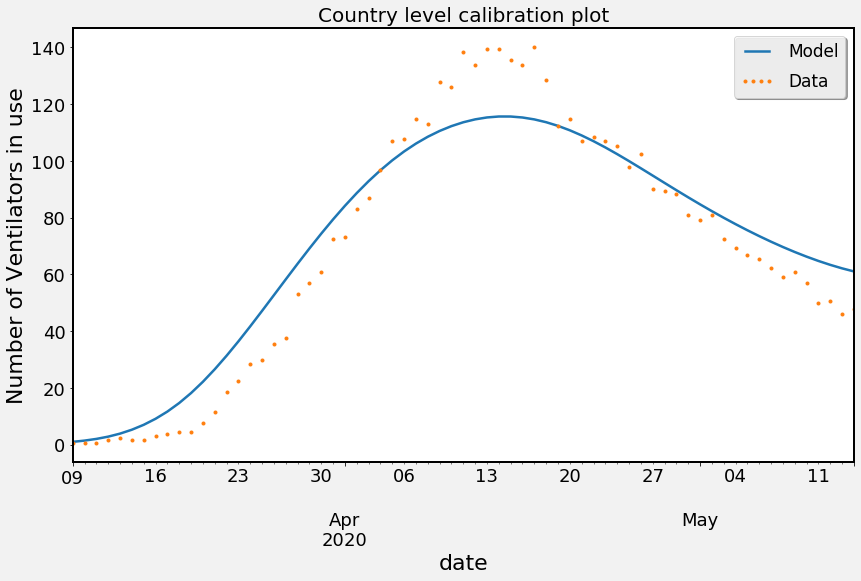

In [42]:
mdl.plot_hospitalizations_calibration(res_mdl_1_no,resp.values,date_lst,start_date=start_date,end_date=end_date,
                                     tracking='vents')

In [43]:
def save_cal_track(res_fit, ind, scen, phase, track):
    if track == 'H':
        cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['eta'] = \
            res_fit.x[0]
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['nu'] = \
            res_fit.x[0]

    elif track == 'Vents':
        cal_parameters = pd.read_pickle(
            '../Data/calibration/calibrattion_dict.pickle')
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['xi'] = \
            res_fit.x[0]
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['mu'] = \
            res_fit.x[0]
    with open('../Data/calibration/calibrattion_dict.pickle', 'wb') as handle:
        pickle.dump(cal_parameters, handle, protocol=pickle.HIGHEST_PROTOCOL)

save_cal_track(res_fit_1_no, ind, scen, phase, 'Vents')

#### Running Calibration forward with 100%

In [55]:
model_1_ml.reset()
res_mdl = model_1_ml.predict(
    C=mdl.C_calibration,
    days_in_season=len(date_lst),
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)
res_mdl, _ = mdl.multi_inter_by_name(
    ind, 
    model_1_ml, 
    mdl.pop_israel, 
    [mdl.inter2name(ind, 100, no_risk=True)], 
    sim_length=500, 
    fix_vents=False,
    no_pop=False,
    start=len(date_lst),
)

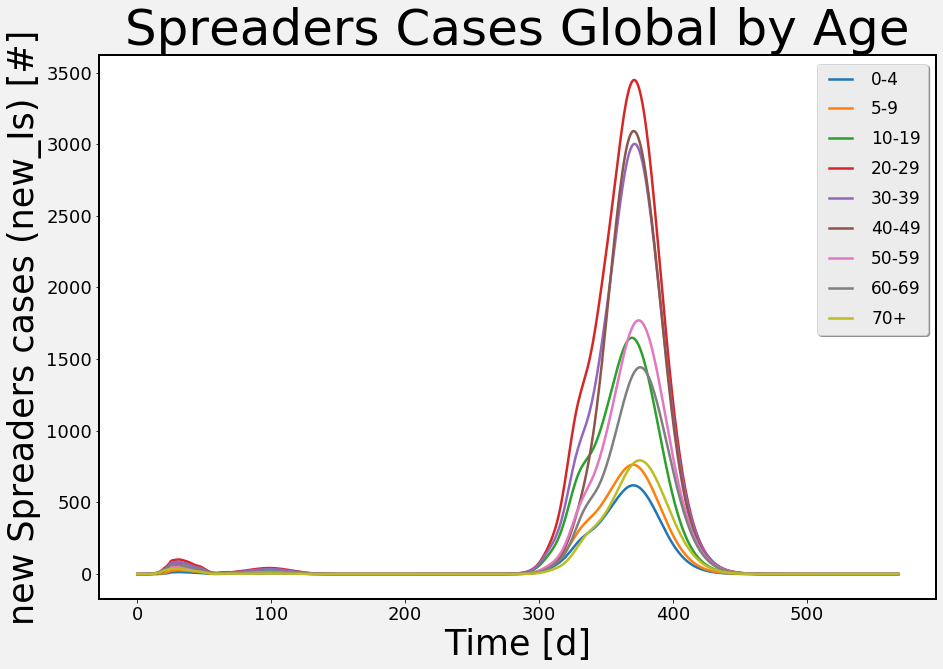

(<Figure size 1080x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1ca7acf8>)

In [56]:
mdl.plot_I_by_age(ind,res_mdl, new_only=True)

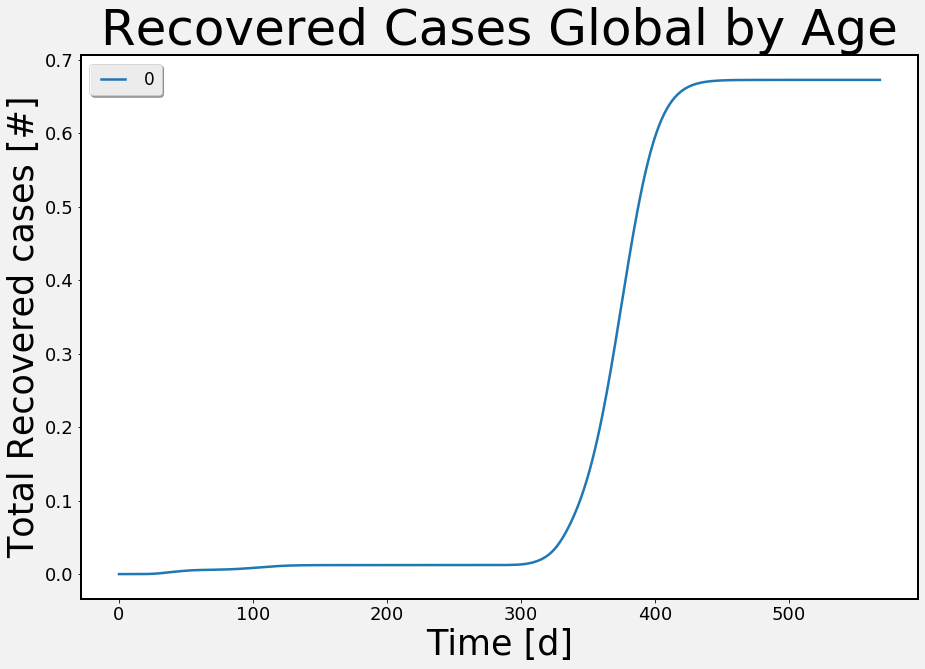

SyntaxError: 'return' outside function (<ipython-input-59-59271a62258e>, line 19)

In [59]:
# R = res_mdl['Vents']*isr_pop
R = res_mdl['R']

# dictionary of arrays to plot
plot_dict ={}
plot_dict = R.sum(axis=1)

fig = plt.figure(figsize=(15,10))
ax = plt.subplot()
ax.set_ylabel('Total Recovered cases [#]', fontsize=35)
ax.set_title('Recovered Cases Global by Age', fontsize=50)
ax.set_xlabel('Time [d]', fontsize=35)
plot_df = pd.DataFrame.from_dict(plot_dict)

# plot
plot_df.plot(ax=ax)
plt.show()
plt.close()
return fig, ax

In [ ]:
t = np.arange(500)
plt.plot(t, 1 + np.cos((2 * np.pi * (t + model_1_ml.phi)) / 365.0))

### NO seasonality

#### calibration

In [8]:
scen = 'Scenario1'
seasonality = False
phase='-'

In [9]:
# fit params
start = pos_0303.index[0]
end = pos_0303.index[-1]
date_lst = pd.date_range('2020-02-20',end)
len(date_lst)

72

In [15]:
cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')

model_1_ml = mdl.Model_behave(
    ind=ind,
    beta_j=cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['beta_j'],
    theta=cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['theta'],
    beta_behave=cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['beta_behave'],
    scen=scen,
    seasonality=seasonality,
)

In [191]:
model_1_ml = mdl.Model_behave(
    ind=ind,
    beta_j=np.array([0.10167117, 0.10167117, 0.10167117, 0.05606748, 0.05606748,
       0.04709613, 0.04709613, 0.25676354, 0.25676354])*0.4,
    theta=2.0684200685446243,
    beta_behave=0.38,
    scen=scen,
    seasonality=seasonality,
)

In [16]:
# Model Fitting
p0=(cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['beta_j'][0],
    cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['beta_j'][3],
    cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['beta_j'][5],
    cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['beta_j'][7],
    cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['theta'],
    cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['beta_behave']) # initial guess
bnds = ((0,0.3),(0,0.2),(0,0.2),(0,0.6),(1.5,3),(0,0.6))# boundries for variables


In [21]:
res_fit_1_ml = model_1_ml.fit(
        mapper=region_age_250_to_30,
        p0=p0,
        bnds=bnds,
        data=data,
        date_lst = date_lst,
        start=start,
        end=end,
        loss_func='MSE',
        maxiter=3,
        factor=1,
    )

In [22]:
mdl.print_stat_fit_behave(res_fit_1_ml)

minimized value: -26.02038532280429
Fitted parameters:
 Beta=[0.0562385  0.03910775 0.03831755 0.16266327]
 Theta=2.124157143193085,
,Beta_behave=0.4130383455172286
num of sampling the target function: 3


In [52]:
mdl.save_cal(res_fit_1_ml, ind, scen, '-')

In [23]:
res_mdl_1_ml = model_1_ml.predict(
    C=mdl.C_calibration,
    days_in_season=len(date_lst),
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

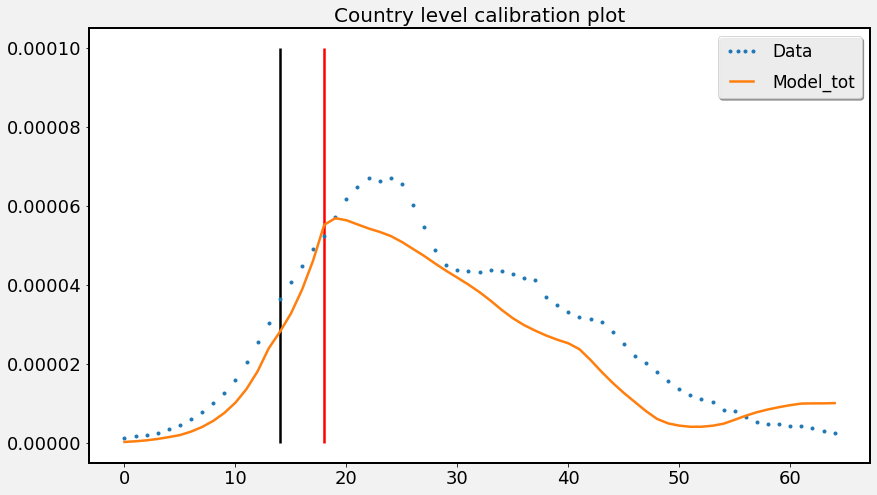

In [24]:
mdl.plot_calibrated_total_model(pd.DataFrame(data[1])/mdl.pop_israel, res_mdl_1_ml, date_lst, start=start,end=end)
plt.vlines(x=14,ymin=0, ymax=0.0001)
plt.vlines(x=23-5,ymin=0, ymax=0.0001, color='r')

In [36]:
from scipy.stats import f
dist = f.sf(np.exp(0.05), 60, 60)
dist

0.42354448311316045

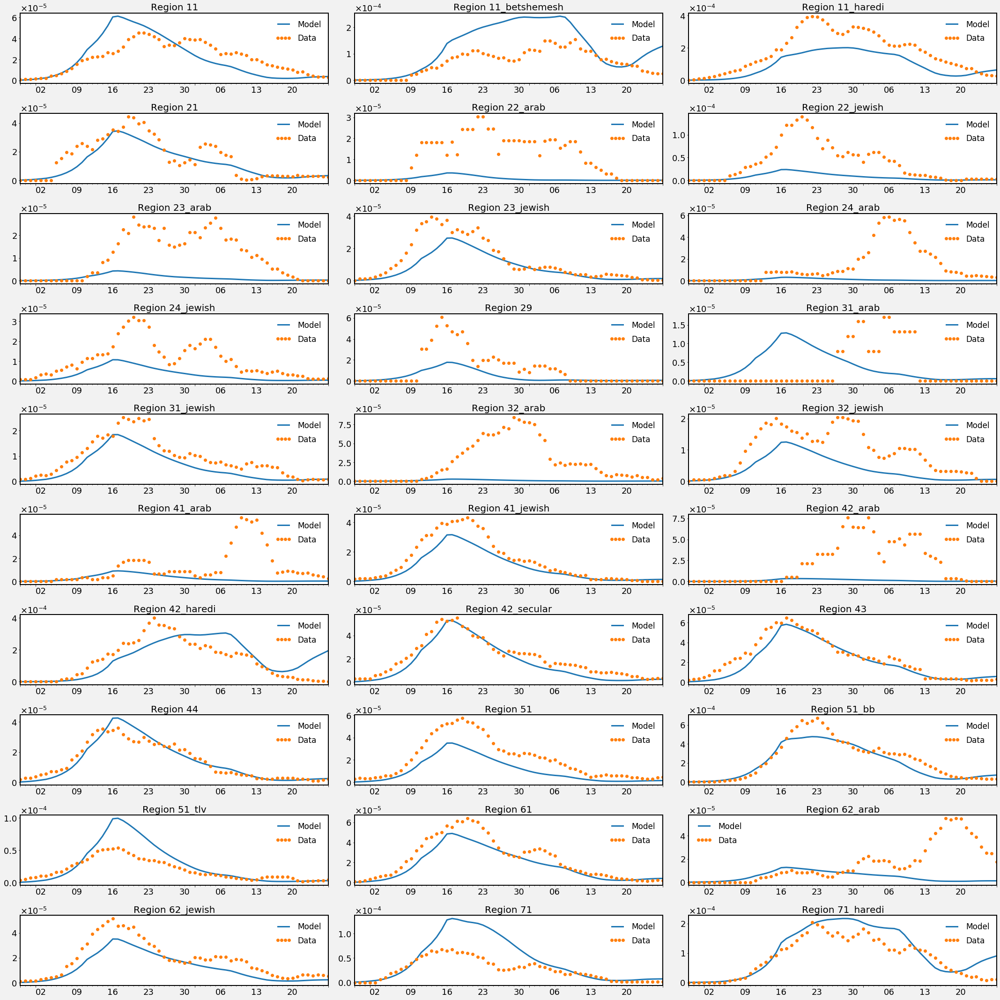

In [15]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(mdl_mapper=region_250_to_30,
                                          data=data, 
                                          mdl_data = res_mdl_1_ml['new_Is'],
                                          date_list = date_lst,
                                          start=start,
                                          end=end,
                                          region_name = {k:k for k in region_250_to_30.keys()},
                                          loss_func = 'MSE',
                                         ind=ind,
                                         data_mapper=region_ga_250_to_30)
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

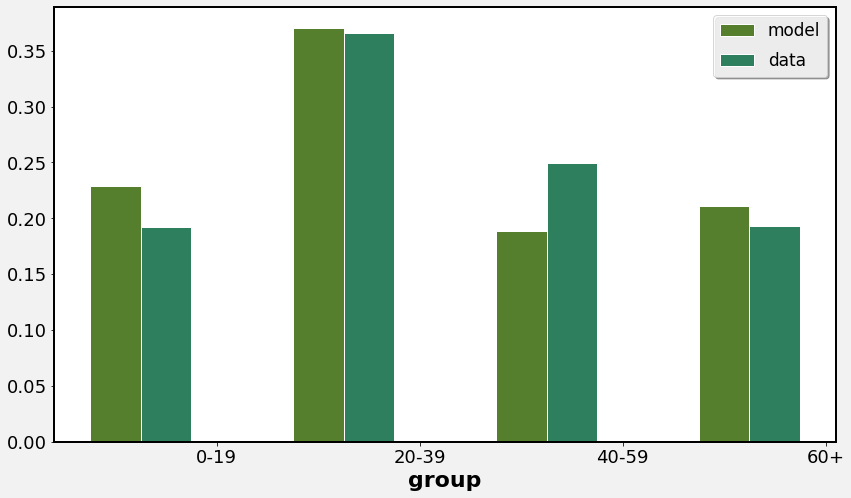

In [16]:
age_cal = [
    ['0-4', '5-9', '10-19'],
    ['20-29', '30-39'],
    ['40-49', '50-59'],
    ['60-69', '70+'],
]
age_name = [
    '0-19', 
    '20-39', 
    '40-59', 
    '60+',
]
age_pct = []
age_pct_data = []
age_model = []
data_age = (pos_0303.sum(axis=0).unstack(level=0).sum(axis=1))/(pos_0303.sum(axis=0).unstack(level=0).sum(axis=1).sum())
for age_list in age_cal:
    idx = []
    for age in age_list:
        idx += list(ind.age_dict[age])
    age_pct.append(res_mdl_1_ml['new_Is'][:, idx].sum()/res_mdl_1_ml['new_Is'].sum())
    age_pct_data.append(data_age.loc[age_list].sum())

# set width of bar
barWidth = 0.25
 
# set height of bar
 
# Set position of bar on X axis
r1 = np.arange(len(age_pct))
r2 = [x - barWidth for x in r1]
r3 = [x + barWidth for x in r2]
 
# Make the plot
plt.bar(r2, age_pct, color='#557f2d', width=barWidth, edgecolor='white', label='model')
plt.bar(r3, age_pct_data, color='#2d7f5e', width=barWidth, edgecolor='white', label='data')
 
# Add xticks on the middle of the group bars
plt.xlabel('group', fontweight='bold')
plt.xticks([r + barWidth for r in range(len(age_name))], age_name)
 
# Create legend & Show graphic
plt.legend()
plt.show()


Text(0.5, 0, 'Time [d]')

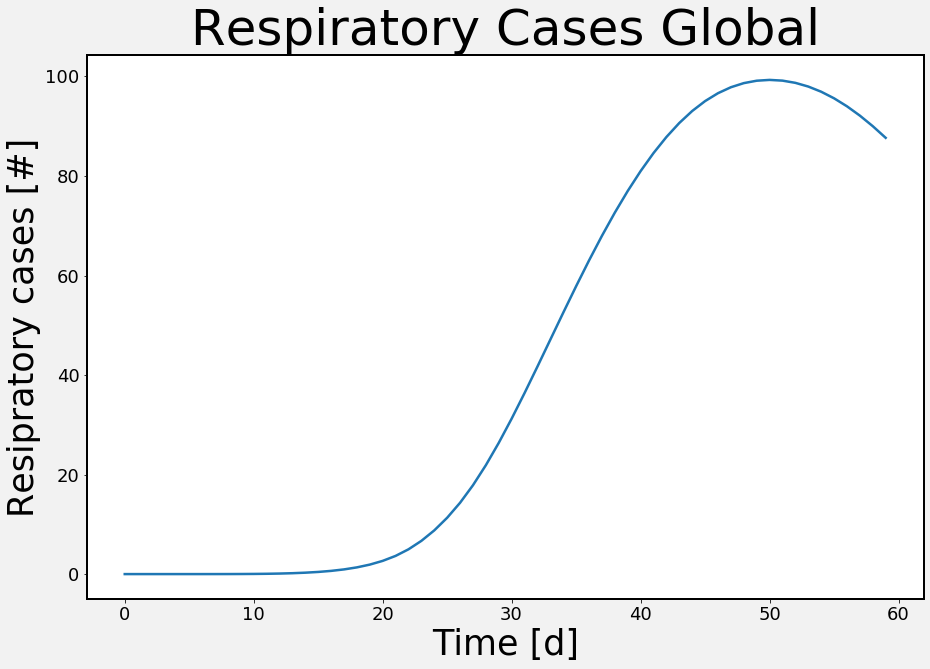

In [17]:
fig, ax = plt.subplots(figsize=(15, 10))
ax.plot(((res_mdl_1_ml['Vents']).sum(axis=1)[:(end-start).days])*isr_pop)
ax.set_ylabel('Resipratory cases [#]', fontsize=35)
ax.set_title('Respiratory Cases Global', fontsize=50)
ax.set_xlabel('Time [d]', fontsize=35)

#### running tracking calibration 

In [170]:
df = pd.read_csv('../Data/sick/daily_hospital_resp.csv')
df.index = pd.to_datetime(df['Date'], dayfirst=True)
resp = df['resp'].dropna()
hosp = df['hospitalized'].dropna()
# resp = pd.read_csv('../Data/sick/resp_country.csv')
# hosp = pd.read_csv('../Data/sick/hospitalizations_country.csv')

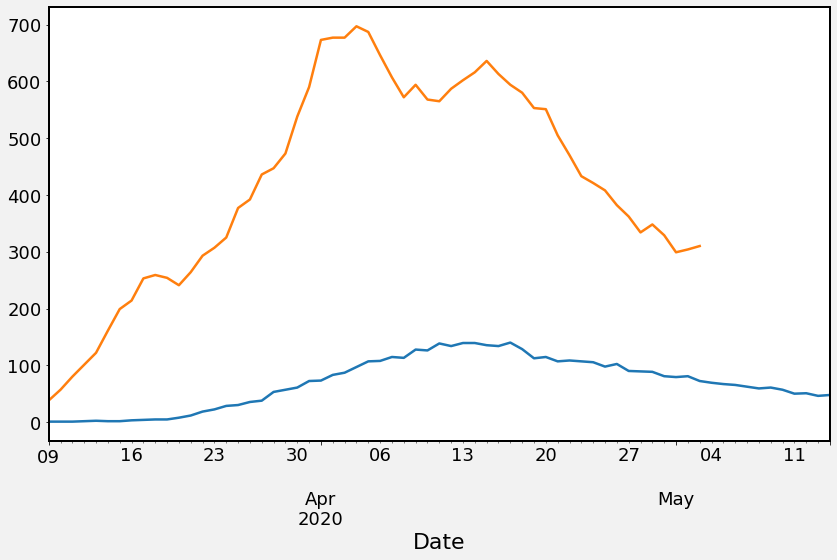

In [172]:
ax= plt.subplot()
resp.plot(ax=ax)
hosp.plot(ax=ax)

In [173]:
scen = 'Scenario1'
scen_idx = int(scen[-1])
seasonality = False
phase = '-'
start_sim='2020-02-20'

start_date = hosp.index[0]
end_date = hosp.index[-1]

date_lst = pd.date_range(start_sim,end_date)
len(date_lst)

74

In [174]:
hosp.index[-1]

Timestamp('2020-05-03 00:00:00')

In [175]:
# Model Fitting
p0=(1/7., 0.1) # initial guess
bnds = ((0.05,1.0),(0.05,0.25))# boundries for variables
# bnds = ((0.01,1.0),(0.01,1.0))# boundries for variables

In [177]:
cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')

model_1_no = mdl.Model_behave(
    ind=ind,
    beta_j=cal_parameters[ind.cell_name][(scen_idx, phase)]['beta_j'],
    theta=cal_parameters[ind.cell_name][(scen_idx, phase)]['theta'],
    beta_behave=cal_parameters[ind.cell_name][(scen_idx, phase)]['beta_behave'],
    scen=scen,
    seasonality=seasonality,
)

In [178]:
model_1_no.reset()
res_fit_1_no = model_1_no.fit_tracking(
        p0=p0,
        bnds=bnds,
        data=hosp.values,
        date_lst = date_lst,
        days_in_season=len(date_lst),
        start=start_date,
        end=end_date,
        loss_func='MSE',
        maxiter=300,
        factor=1,
        tracking='hosp'
    )

iter:  50  loss:  -23.96448233282365
iter:  100  loss:  -23.965723477595187


In [179]:
mdl.print_stat_fit_hosp(res_fit_1_no)

minimized value: -23.96572362155711
Fitted parameters:
 Eta=0.3027677648074807
 Nu=0.09764102915476332,
 
num of sampling the target function: 32


In [180]:
model_1_no.reset()
res_mdl_1_no = model_1_no.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

(<Figure size 1008x576 with 0 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x3a458358>)

<Figure size 1008x576 with 0 Axes>

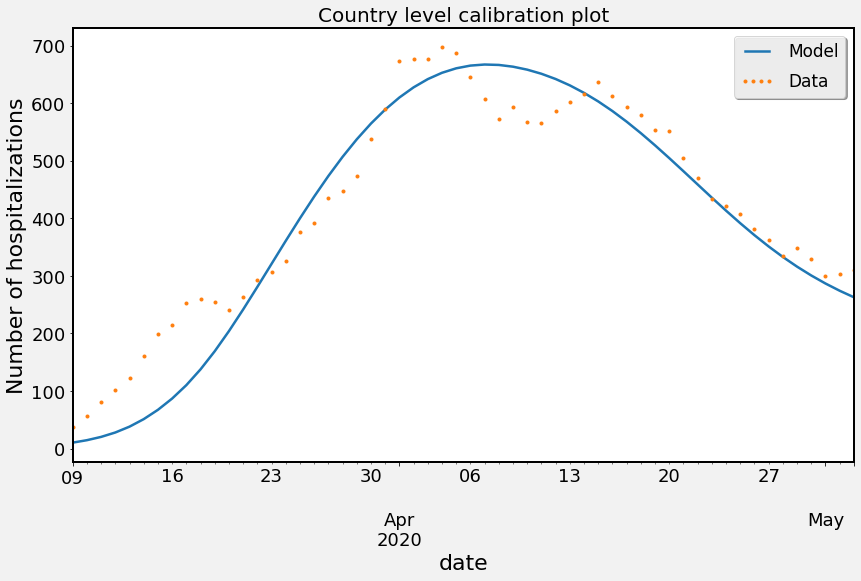

In [181]:
mdl.plot_hospitalizations_calibration(res_mdl_1_no,hosp,date_lst,start_date=start_date,end_date=end_date)

In [182]:
def save_cal_track(res_fit, ind, scen, phase, track):
    if track == 'H':
        cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['eta'] = \
            res_fit.x[0]
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['nu'] = \
            res_fit.x[0]

    elif track == 'Vents':
        cal_parameters = pd.read_pickle(
            '../Data/calibration/calibrattion_dict.pickle')
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['xi'] = \
            res_fit.x[0]
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['mu'] = \
            res_fit.x[0]
    with open('../Data/calibration/calibrattion_dict.pickle', 'wb') as handle:
        pickle.dump(cal_parameters, handle, protocol=pickle.HIGHEST_PROTOCOL)

save_cal_track(res_fit_1_no, ind, scen, phase, 'H')

In [158]:
scen = 'Scenario1'
scen_idx = int(scen[-1])
seasonality = False
phase = '-'
start_sim='2020-02-20'

start_date = resp.index[0]
end_date = resp.index[-1]
date_lst = pd.date_range(start_sim,end_date)
len(date_lst)

85

In [159]:
resp.index[-1]

Timestamp('2020-05-14 00:00:00')

In [160]:
# Model Fitting
p0=(0.05, 1/9.9) # initial guess
# bnds = ((0.00,1),(1/14.,1/10.))# boundries for variables
bnds = ((0.00,1),(1/21.,1/10.))# boundries for variables

In [161]:
cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')

model_1_no = mdl.Model_behave(
    ind=ind,
    beta_j=cal_parameters[ind.cell_name][(scen_idx, phase)]['beta_j'],
    theta=cal_parameters[ind.cell_name][(scen_idx, phase)]['theta'],
    beta_behave=cal_parameters[ind.cell_name][(scen_idx, phase)]['beta_behave'],
    scen=scen,
    seasonality=seasonality,
)

In [162]:
model_1_no.reset()
res_fit_1_no = model_1_no.fit_tracking(
        p0=p0,
        bnds=bnds,
        data=resp.values,
        date_lst = date_lst,
        days_in_season=len(date_lst),
        start=start_date,
        end=end_date,
        loss_func='MSE',
        maxiter=85,
        factor=1,
        tracking='vents'
    )

iter:  50  loss:  -26.94730867942132
iter:  100  loss:  -27.146628204662292


In [163]:
mdl.print_stat_fit_hosp(res_fit_1_no, tracking='vents')

minimized value: -27.146632102689843
Fitted parameters:
 Xi=0.1573797898975995
 Mu=0.053282918040788066,
 
num of sampling the target function: 36


In [164]:
model_1_no.reset()
res_mdl_1_no = model_1_no.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

(<Figure size 1008x576 with 0 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x19b21da0>)

<Figure size 1008x576 with 0 Axes>

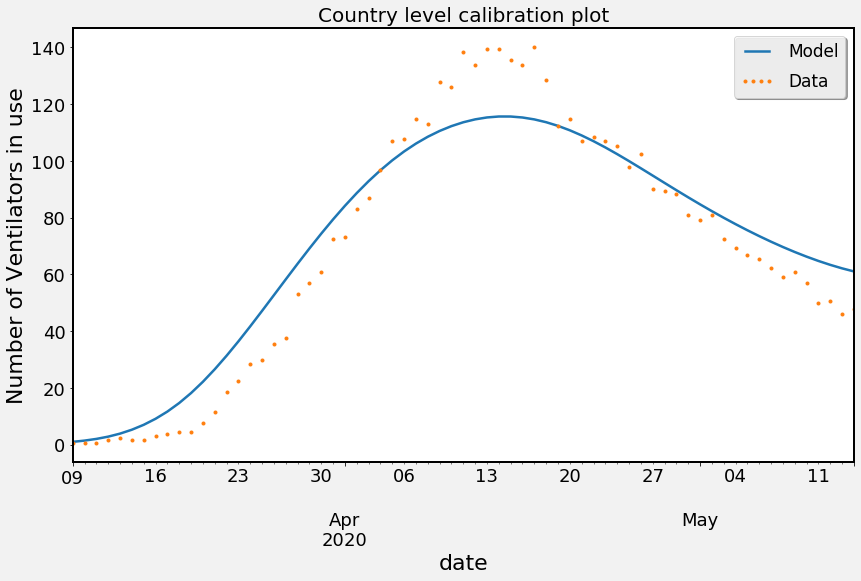

In [165]:
mdl.plot_hospitalizations_calibration(res_mdl_1_no,resp.values,date_lst,start_date=start_date,end_date=end_date,
                                     tracking='vents')

In [176]:
def save_cal_track(res_fit, ind, scen, phase, track):
    if track == 'H':
        cal_parameters = pd.read_pickle('../Data/calibration/calibrattion_dict.pickle')
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['eta'] = \
            res_fit.x[0]
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['nu'] = \
            res_fit.x[0]

    elif track == 'Vents':
        cal_parameters = pd.read_pickle(
            '../Data/calibration/calibrattion_dict.pickle')
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['xi'] = \
            res_fit.x[0]
        cal_parameters[ind.cell_name][(int(scen[-1]), phase)]['mu'] = \
            res_fit.x[0]
    with open('../Data/calibration/calibrattion_dict.pickle', 'wb') as handle:
        pickle.dump(cal_parameters, handle, protocol=pickle.HIGHEST_PROTOCOL)

save_cal_track(res_fit_1_no, ind, scen, phase, 'Vents')

#### running calibration with 100%

In [29]:
model_1_ml.reset()
res_mdl = model_1_ml.predict(
    C=mdl.C_calibration,
    days_in_season=len(date_lst),
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)
res_mdl, _ = mdl.multi_inter_by_name(
    ind, 
    model_1_ml, 
    mdl.pop_israel, 
    [mdl.inter2name(ind, 100, no_risk=False)], 
    sim_length=500, 
    fix_vents=False,
    no_pop=False,
    start=len(date_lst),
)

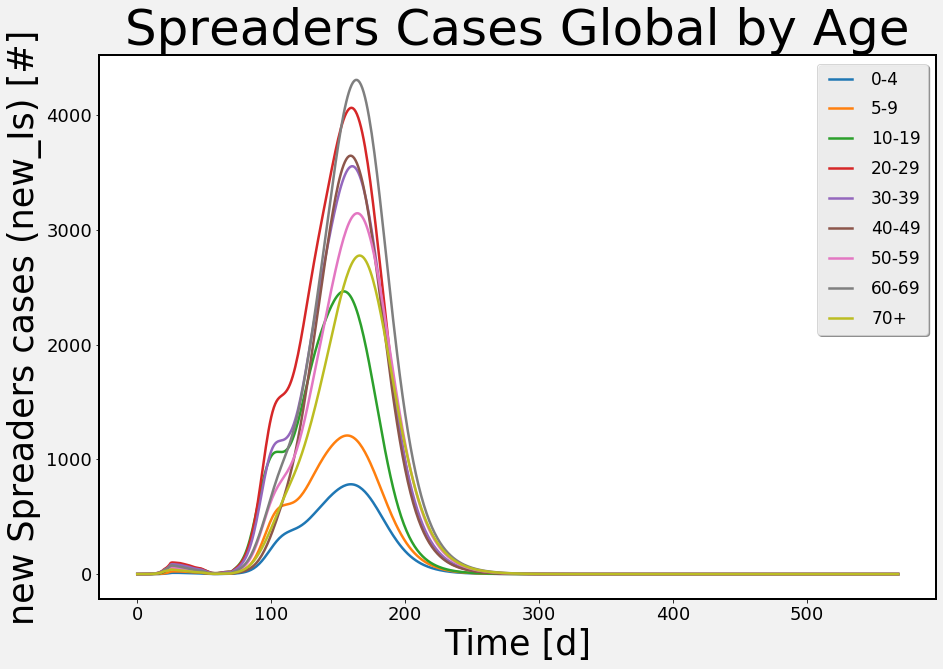

(<Figure size 1080x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x3d6ad198>)

In [30]:
mdl.plot_I_by_age(ind,res_mdl, new_only=True)

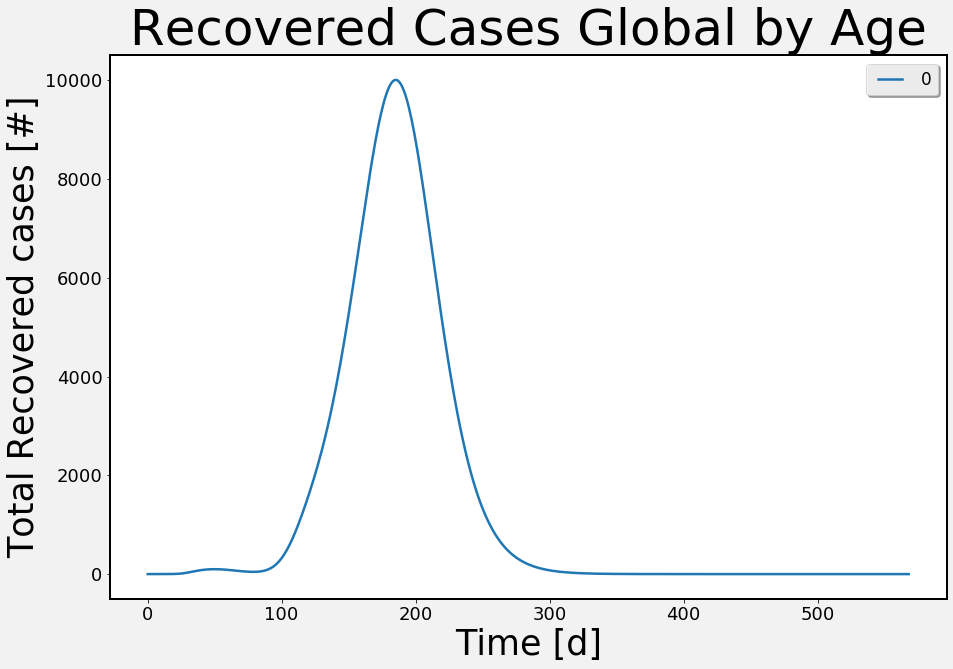

total casulties:  19011.471276770277


In [31]:
R = res_mdl['Vents']*isr_pop
# R = res_mdl['R']

# dictionary of arrays to plot
plot_dict ={}
plot_dict = R.sum(axis=1)

fig = plt.figure(figsize=(15,10))
ax = plt.subplot()
ax.set_ylabel('Total Recovered cases [#]', fontsize=35)
ax.set_title('Recovered Cases Global by Age', fontsize=50)
ax.set_xlabel('Time [d]', fontsize=35)
plot_df = pd.DataFrame.from_dict(plot_dict)

# plot
plot_df.plot(ax=ax)
plt.show()
plt.close()
print('total casulties: ', mdl.make_casulties(res_mdl, -1, mdl.pop_israel, model_1_ml.mu))

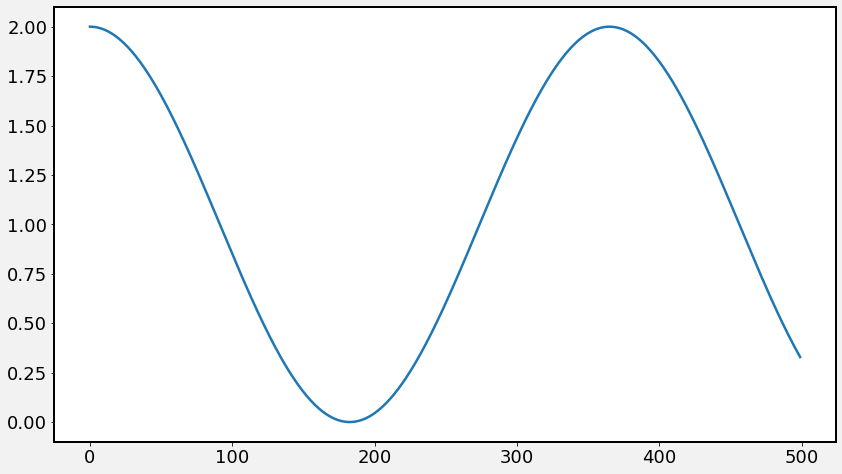

In [21]:
t = np.arange(500)
plt.plot(t, 1 + np.cos((2 * np.pi * (t + model_1_ml.phi)) / 365.0))

# Fit model Matan

## Scenario 2

In [91]:
# fit params
days_in_season=100
date_lst = pd.date_range('2020-02-20',last)
len(date_lst)

59

In [15]:
# Model Fitting
p0=(0.0981001,0.05305112,0.05157651,0.3,2.103427546494595, 0.23785134529029744) # initial guess
bnds = ((0,0.1),(0,0.15),(0,0.15),(0,0.4),(1.5,3),(0,0.6))# boundries for variables


In [17]:
model.reset()
model.update({'sigma':1./4.4, 'nu':0.1})

In [20]:
res_fit = model.fit(
        p0=p0,
        bnds=bnds,
        data=data,
        date_lst = date_lst,
        days_in_season=days_in_season,
        start='2020-02-26',
        end='2020-04-09',
        loss_func='MSE',
        maxiter=300,
        factor=1,
    )

iter:  50  loss:  -25.286651523683272
iter:  100  loss:  -25.28666225695731
iter:  150  loss:  -25.28666842165207
iter:  200  loss:  -25.28664352824454
iter:  250  loss:  -25.286668634525913
iter:  300  loss:  -25.28667188969636
iter:  350  loss:  -25.28667337954782
iter:  400  loss:  -25.286675707520644
iter:  450  loss:  -25.286307312819737
iter:  500  loss:  -25.28667897564827
iter:  550  loss:  -25.286670456114894
iter:  600  loss:  -25.258880990145563
iter:  650  loss:  -25.286679827472604
iter:  700  loss:  -25.28128182902487
iter:  750  loss:  -25.28668093344763
iter:  800  loss:  -25.28380934191835
iter:  850  loss:  -25.286681325314152
iter:  900  loss:  -25.286681551047835
iter:  950  loss:  -25.28668348428066
iter:  1000  loss:  -25.286684542087375
iter:  1050  loss:  -25.28668697644248
iter:  1100  loss:  -25.28668778459287
iter:  1150  loss:  -25.286680448438474
iter:  1200  loss:  -25.284386681612624
iter:  1250  loss:  -25.28668802414523
iter:  1300  loss:  -25.286688259

In [21]:
mdl.print_stat_fit_behave(res_fit)

minimized value: -25.28668836556765
Fitted parameters:
 Beta=[0.09883986 0.05334751 0.05144386 0.30902021]
 Theta=2.074502181457254,
 Beta_behave=0.2364975456730552
num of sampling the target function: 176


In [94]:
model.reset()
model.update({'nu':1/15.})
res_mdl = model.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

In [95]:
model.beta_j

array([0.09883986, 0.09883986, 0.09883986, 0.05334751, 0.05334751,
       0.05144386, 0.05144386, 0.30902021, 0.30902021])

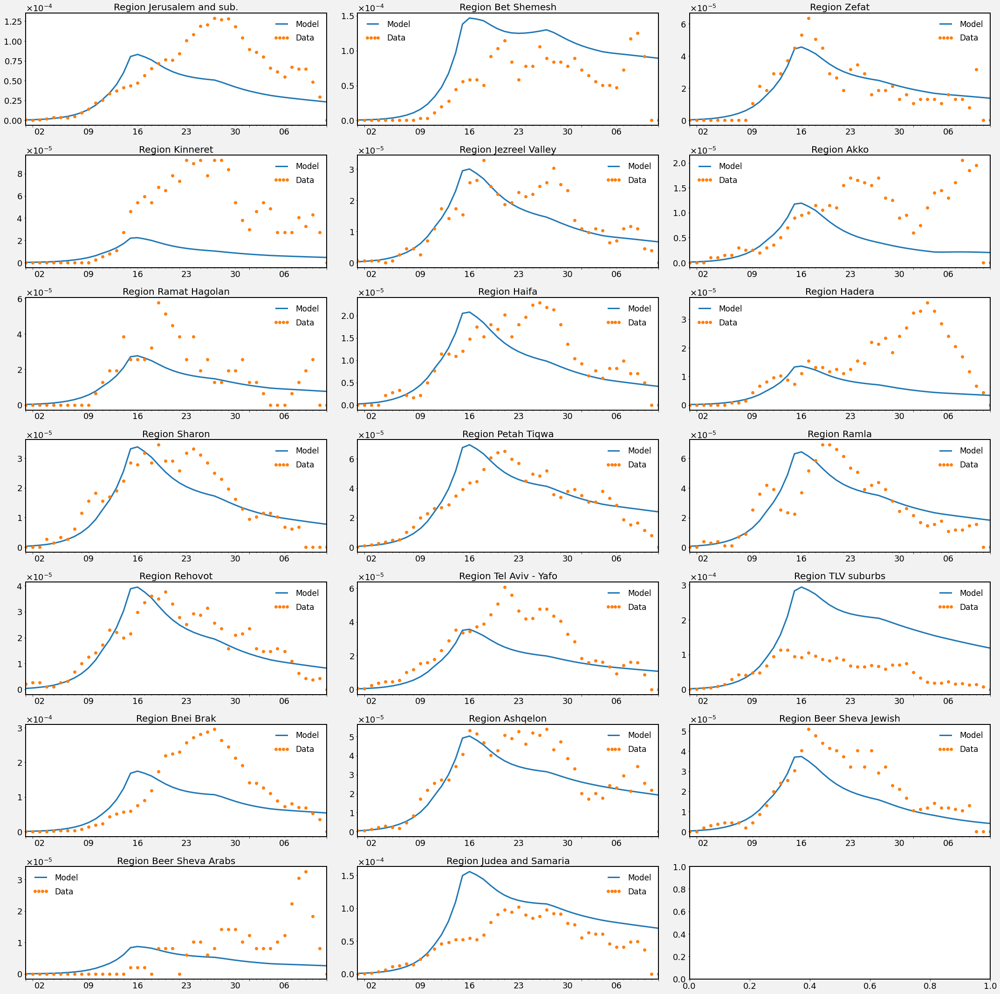

In [24]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=data, 
                                          mdl_data = res_mdl['new_Is'],
                                          date_list = date_lst,
                                          start='2020-02-29',
                                          end='2020-04-12',
                                          region_name = mdl.cell,
                                          loss_func = 'MSE')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

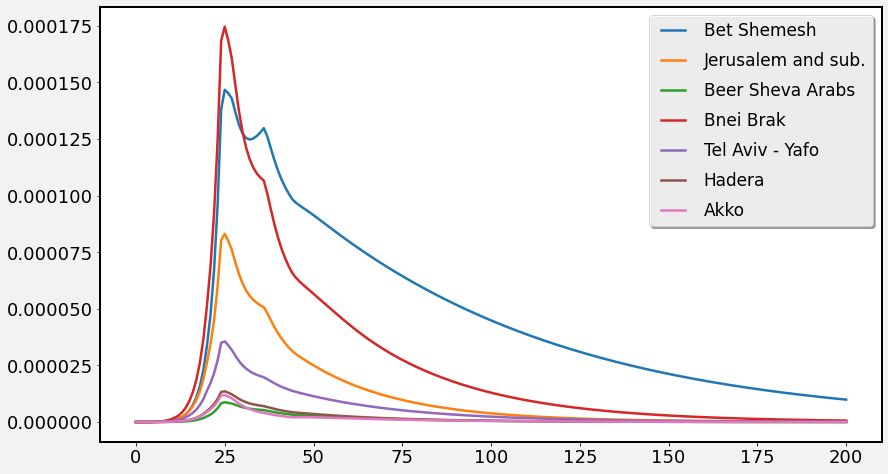

In [25]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.cell[region]] = (res_mdl['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

In [26]:
(res_mdl['new_Is']).sum()

0.001912198900378699

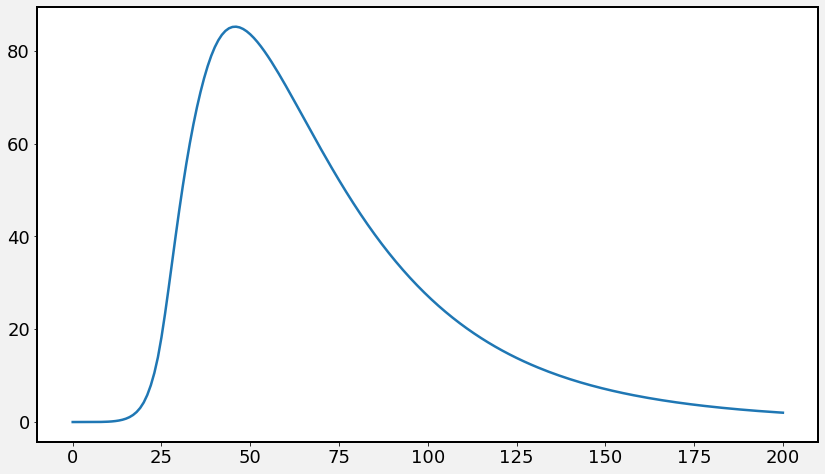

In [96]:
plt.plot(res_mdl['H'].sum(axis=1)*9136000)

In [85]:
date_lst[-1]

Timestamp('2020-04-13 00:00:00', freq='D')

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x28eea880dc8>)

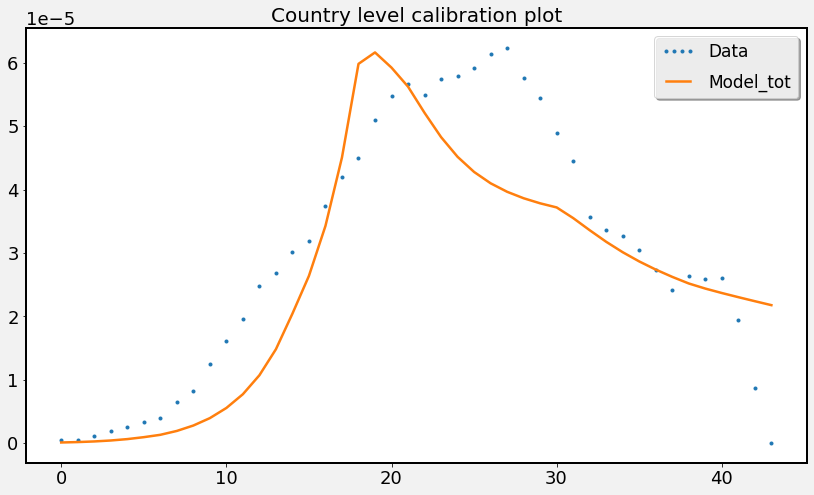

In [29]:
mdl.plot_calibrated_total_model(pd.DataFrame(data[1])/9136000,res_mdl,date_lst,start='2020-02-26',end='2020-04-09')

### Model Variance

In [30]:
model_start_idx = int(np.where(date_lst == '2020-02-26')[0])
model_end_idx = int(np.where(date_lst == '2020-04-09')[0])

In [31]:
# Calculation of variance:
# model results array based on region and age:
model_by_age_region = {}
for i, key in enumerate(mdl.region_age_dict.keys()):
    model_by_age_region[key[0] + '_' + key[1] + '_mdl'] = res_mdl['new_Is'][model_start_idx:model_end_idx+1, mdl.region_age_dict[key]].sum(axis=1)
model_by_age_region = pd.DataFrame.from_dict(model_by_age_region)

In [32]:
model_std = (np.sqrt((np.power((data[1]/isr_pop - model_by_age_region.values),2).sum())/data[1].size))

In [127]:
model_std

2.4067397786831007e-07

### Fit UB for different CIs

======checking CI 90.0%=======
iter:  50  loss:  -24.759038483894752
iter:  100  loss:  -24.765145205138687
iter:  150  loss:  -24.781214883130353
iter:  200  loss:  -24.68037895714571
iter:  250  loss:  -24.796518980154662
iter:  300  loss:  -24.761659873631764
iter:  350  loss:  -24.77960540808225
iter:  400  loss:  -24.797415186941794
iter:  450  loss:  -24.801032928702472
iter:  500  loss:  -24.802926111100476
iter:  550  loss:  -24.79388396805358
iter:  600  loss:  -24.80306407693242
iter:  650  loss:  -24.802639218212253
iter:  700  loss:  -24.80314460475881
iter:  750  loss:  -24.803186897553346
iter:  800  loss:  -24.803187823608226
iter:  850  loss:  -24.80318721366874
iter:  900  loss:  -24.803189024649374
iter:  950  loss:  -24.803189290289854
minimized value: -24.803189290290465
Fitted parameters:
 Beta=[0.1157294  0.06716495 0.07727618 0.41851232]
 Theta=1.5,
 Beta_behave=0.23409992936184507
num of sampling the target function: 118


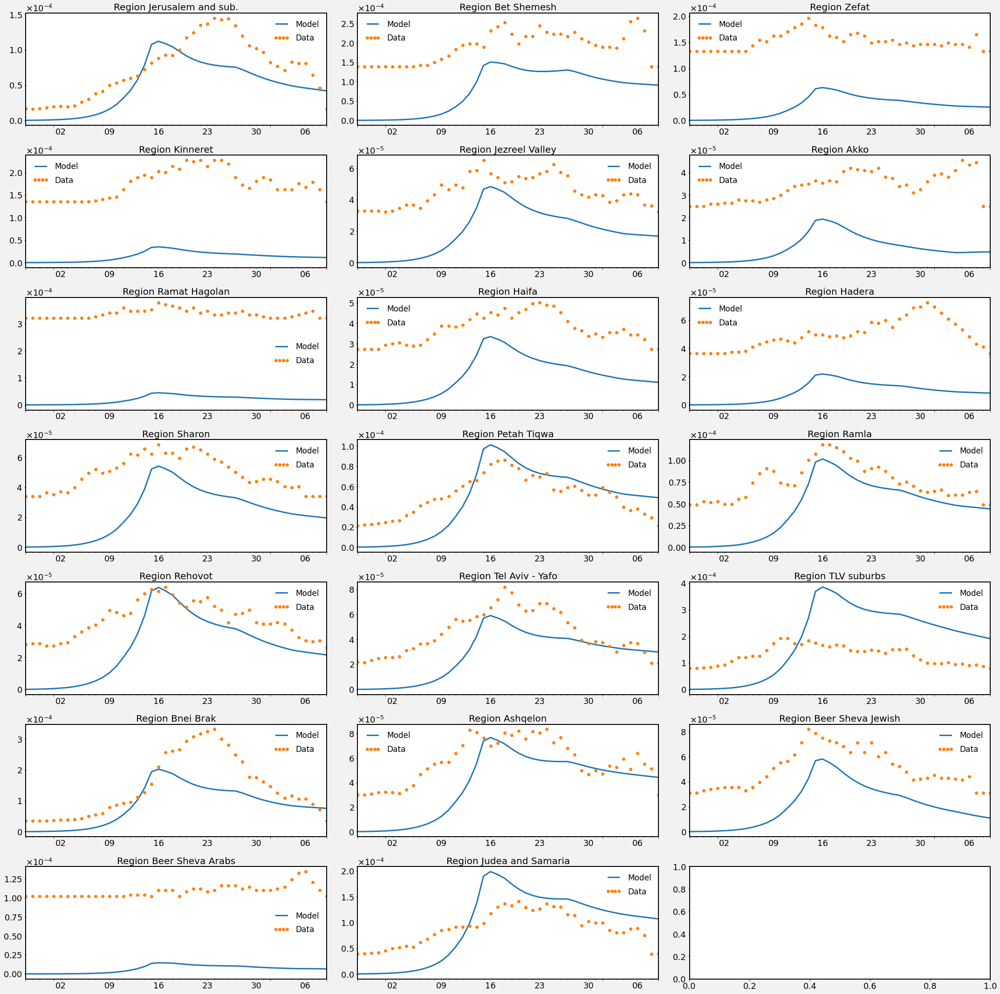

======checking CI 87.5%=======
iter:  50  loss:  -24.88894877671723
iter:  100  loss:  -24.906323147824462
iter:  150  loss:  -24.907933184416343
iter:  200  loss:  -24.909165350663482
iter:  250  loss:  -24.910849532269207
iter:  300  loss:  -24.913076963520698
iter:  350  loss:  -24.914901194473376
iter:  400  loss:  -24.918644740987563
iter:  450  loss:  -24.921535916082966
iter:  500  loss:  -24.921783349657822
iter:  550  loss:  -24.925872043736298
iter:  600  loss:  -24.926475052749204
iter:  650  loss:  -24.71278278721245
iter:  700  loss:  -24.9290074401845
iter:  750  loss:  -24.929965589003096
iter:  800  loss:  -24.521778901849558
iter:  850  loss:  -24.930010467564518
iter:  900  loss:  -24.931199566032355
iter:  950  loss:  -24.820626142497453
iter:  1000  loss:  -24.931197768656745
iter:  1050  loss:  -24.93122251718597
iter:  1100  loss:  -24.931241111436364
iter:  1150  loss:  -24.931265091590475
iter:  1200  loss:  -24.9314268896519
iter:  1250  loss:  -24.931562342460

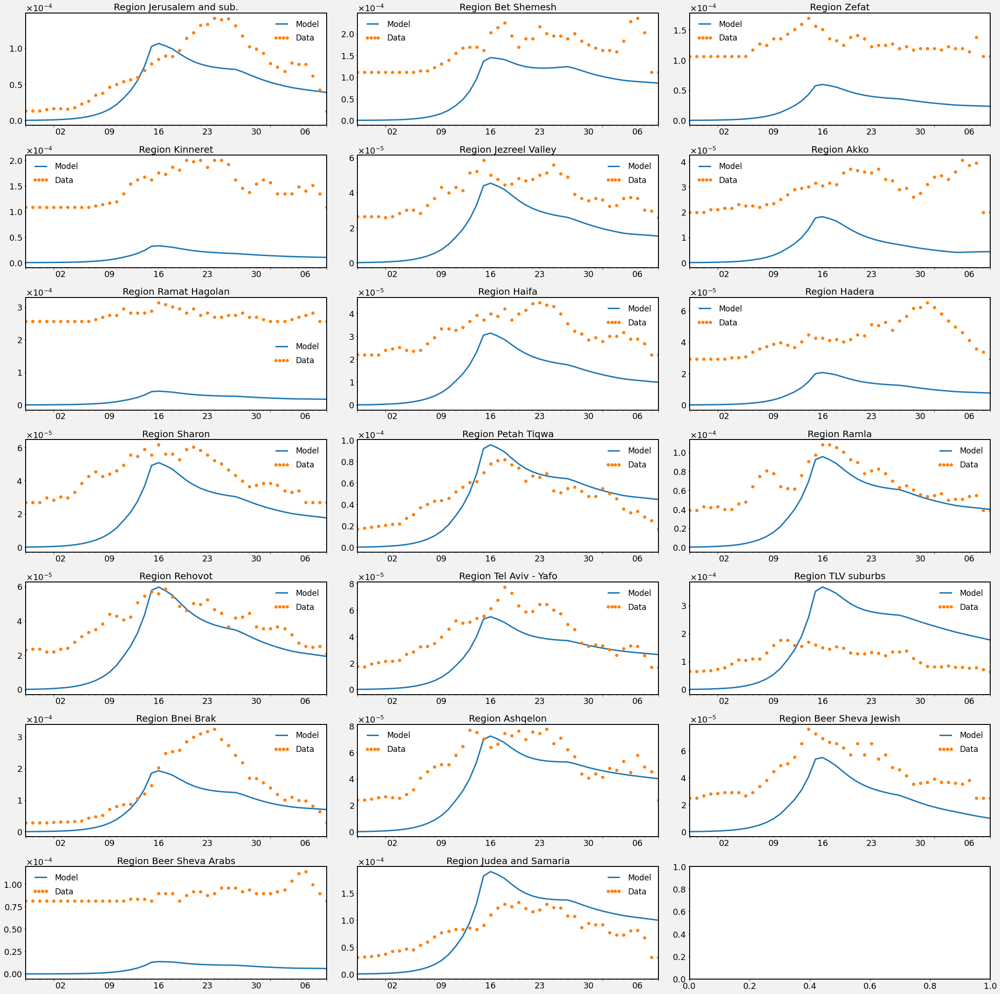

======checking CI 85.0%=======
iter:  50  loss:  -25.011617833326248
iter:  100  loss:  -25.024237689787753
iter:  150  loss:  -25.026960738725663
iter:  200  loss:  -25.0277171292371
iter:  250  loss:  -25.027128339356377
iter:  300  loss:  -25.02852424371825
iter:  350  loss:  -25.028846118644854
iter:  400  loss:  -25.028891336139754
iter:  450  loss:  -25.029459439470212
iter:  500  loss:  -25.029734374892996
iter:  550  loss:  -25.030424462436134
iter:  600  loss:  -25.035136348309532
iter:  650  loss:  -25.03726312341383
iter:  700  loss:  -25.037716819756625
iter:  750  loss:  -25.037967988718684
iter:  800  loss:  -25.03885236890102
iter:  850  loss:  -25.041132198949875
iter:  900  loss:  -25.04144344335839
iter:  950  loss:  -25.041598113539568
iter:  1000  loss:  -25.041771800114184
iter:  1050  loss:  -25.041824100317505
iter:  1100  loss:  -25.041820579944826
iter:  1150  loss:  -25.04183104130905
iter:  1200  loss:  -25.04183564304977
minimized value: -25.041835781765347


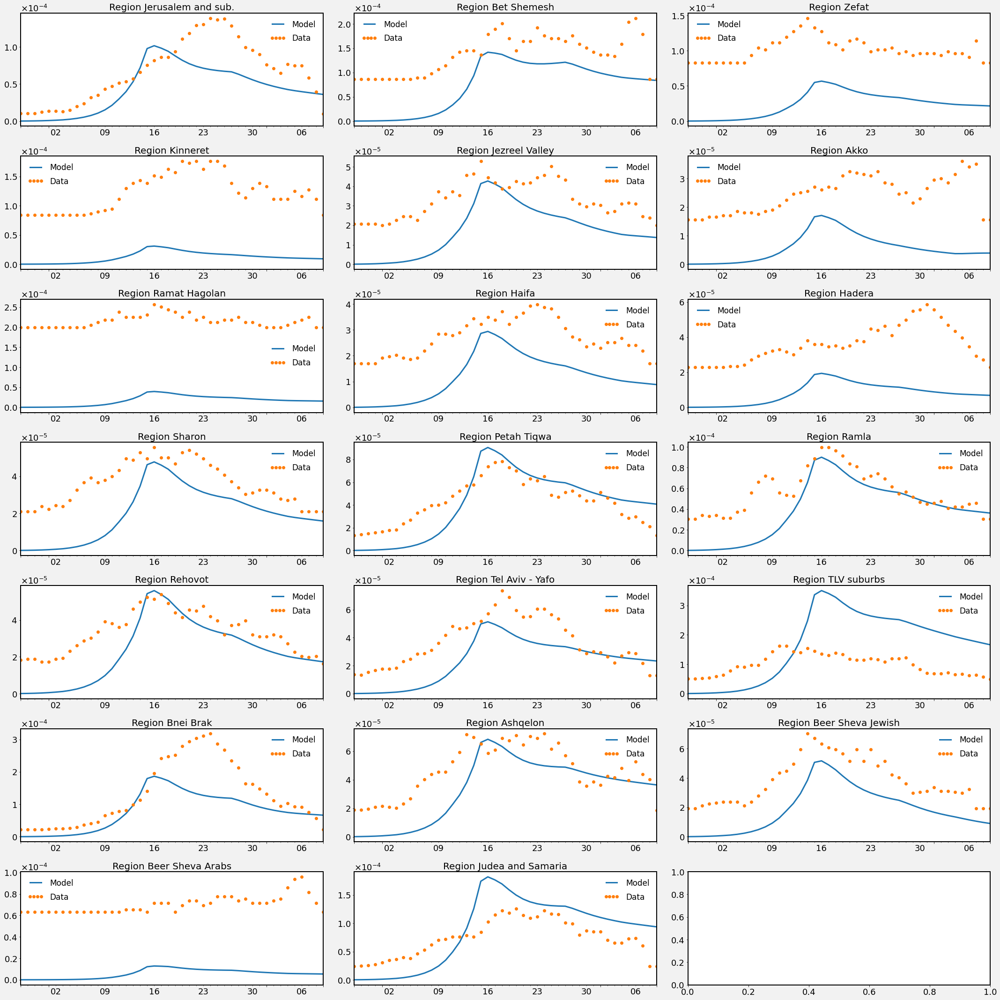

In [138]:
all_calibrations = {}
for percent,z in [('80%',0.842), ('75%',0.674), ('70%',0.524)]:
    res_model = {}
    print('======checking CI {}%======='.format(100 - (100-float(percent[:-1]))/2))
    # calculate new data:
    new_data = data.copy()
    new_data[1] = ((data[1]/isr_pop) + z*model_std)*isr_pop
    
    # initializing model:
    curr_mdl = mdl.Model_behave(
    beta_j=np.array([0.02927922 ,0.02927922 ,0.02927922 ,0.04655266,0.04655266,0.05775265,0.05775265,0.18444245,0.18444245]),
    theta=2.826729434860104,
    beta_behave=0.5552998605894367,
    eps=mdl.eps_sector['Scenario2'],
    f=mdl.f0_full['Scenario2'],
    sigma=1/4.4,
    nu=0.1
    )
#      Model Fitting
    days_in_season=70
    p0=(0.0981001,0.05305112,0.05157651,0.3,2.103427546494595, 0.23785134529029744) # initial guess
    bnds = ((0,0.15),(0,0.15),(0,0.15),(0,0.54),(1.5,3),(0,0.7))# boundries for variables
    
    res_fit_curr = curr_mdl.fit(
        p0=p0,
        bnds=bnds,
        data=new_data,
        date_lst = date_lst,
        days_in_season=days_in_season,
        start='2020-02-26',
        end='2020-04-09',
        loss_func='MSE',
        maxiter=300,
        factor=1,
    )
    mdl.print_stat_fit_behave(res_fit_curr)
    
    curr_mdl.reset()
    res_mdl_curr = curr_mdl.predict(
        C=mdl.C_calibration,
        days_in_season=200,
        stay_home_idx=mdl.stay_home_idx,
        not_routine=mdl.not_routine,
    )
        
        # plotting the data and model
    fig,ax = mdl.plot_calibrated_model_region(data=new_data, 
                                              mdl_data = res_mdl_curr['new_Is'],
                                              date_list = date_lst,
                                              start='2020-02-26',
                                              end='2020-04-09',
                                              region_name = mdl.cell,
                                              loss_func = 'MSE')
    fig.set_size_inches((30,30))
    plt.tight_layout()
    plt.show()
    
    all_calibrations[percent] = {'beta_j':curr_mdl.beta_j, 'beta_behave':curr_mdl.beta_behave, 'theta':curr_mdl.theta}
    
    

In [139]:
# Save calibrated params
with open('calibrattion_dict.pickle', 'wb') as handle:
    pickle.dump(all_calibrations, handle, protocol=pickle.HIGHEST_PROTOCOL)

### Fit UB

In [33]:
# UB data:
data_ub = data.copy()
data_ub[1] = ((data[1]/isr_pop) + 1.96*model_std)*isr_pop

In [52]:
model_ub = mdl.Model_behave(
    beta_j=np.array([0.02927922 ,0.02927922 ,0.02927922 ,0.04655266,0.04655266,0.05775265,0.05775265,0.18444245,0.18444245]),
    theta=2.826729434860104,
    beta_behave=0.5552998605894367,
    eps=mdl.eps_sector['Scenario2'],
    f=mdl.f0_full['Scenario2'],
    sigma=1/4.4,
    nu=0.1
)

In [55]:
# Model Fitting
days_in_season=70
p0=(0.0981001,0.05305112,0.05157651,0.3,2.103427546494595, 0.23785134529029744) # initial guess
bnds = ((0,0.15),(0,0.15),(0,0.15),(0,0.54),(1.5,3),(0,0.7))# boundries for variables

In [56]:
res_fit_ub = model_ub.fit(
        p0=p0,
        bnds=bnds,
        data=data_ub,
        date_lst = date_lst,
        days_in_season=days_in_season,
        start='2020-02-26',
        end='2020-04-09',
        loss_func='MSE',
        maxiter=300,
        factor=1,
    )

iter:  50  loss:  -23.793345006101166
iter:  100  loss:  -23.86128625082176
iter:  150  loss:  -23.768825783679986
iter:  200  loss:  -23.88384295629578
iter:  250  loss:  -23.886894936283092
iter:  300  loss:  -23.907348717584682
iter:  350  loss:  -23.907833587727158
iter:  400  loss:  -23.909010010332608
iter:  450  loss:  -23.89580259747962
iter:  500  loss:  -23.91205589824108
iter:  550  loss:  -23.912890593031143
iter:  600  loss:  -23.912891241032373
iter:  650  loss:  -23.91289801421874
iter:  700  loss:  -23.91287388603845
iter:  750  loss:  -23.91290333038493
iter:  800  loss:  -23.912905636562158
iter:  850  loss:  -23.913014375138143
iter:  900  loss:  -23.91315943154877
iter:  950  loss:  -23.9131852399209
iter:  1000  loss:  -23.91341588456315
iter:  1050  loss:  -23.91055015605241
iter:  1100  loss:  -23.913447224459752
iter:  1150  loss:  -23.91349153729363
iter:  1200  loss:  -23.913874193355788
iter:  1250  loss:  -23.91293506585285
iter:  1300  loss:  -23.9141791686

In [57]:
mdl.print_stat_fit_behave(res_fit_ub)

minimized value: -23.91582570963037
Fitted parameters:
 Beta=[0.12501922 0.07354475 0.09657314 0.48909651]
 Theta=1.5,
 Beta_behave=0.2280608311545828
num of sampling the target function: 218


In [58]:
model_ub.reset()
res_mdl_ub = model_ub.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

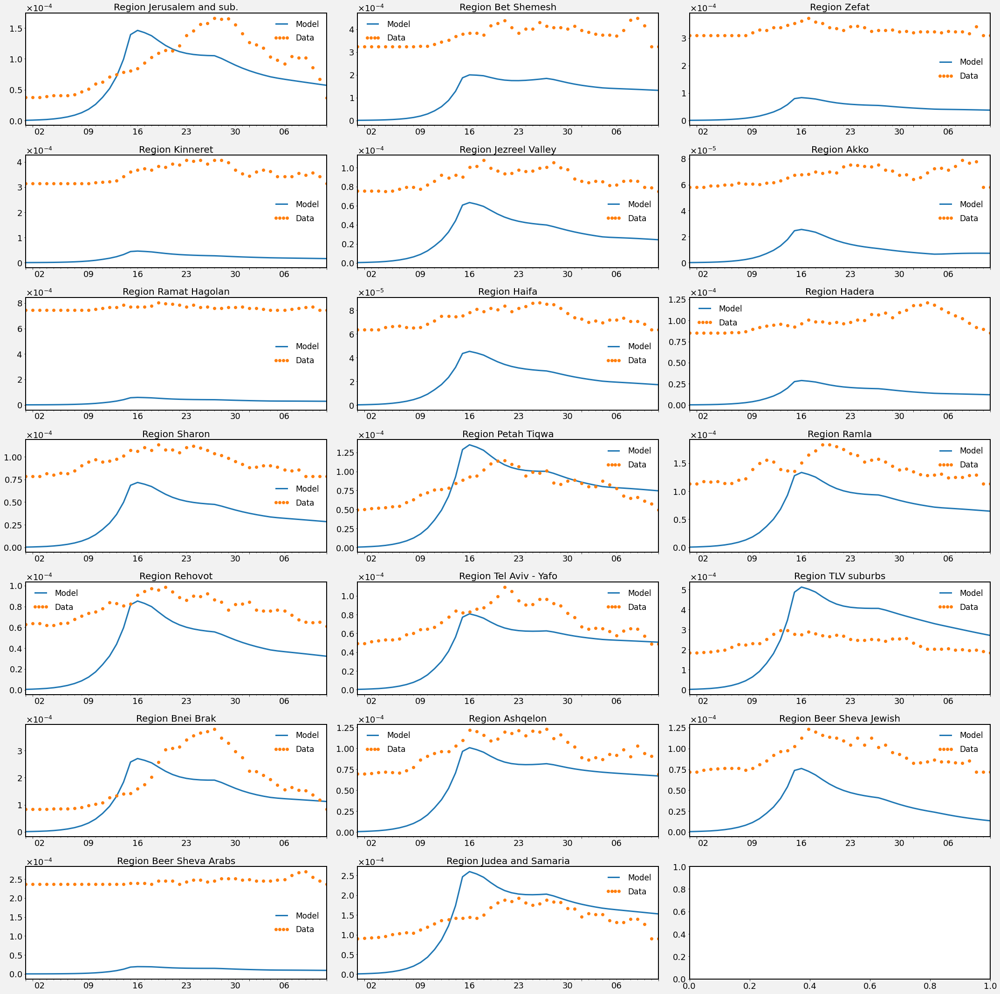

In [59]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=data_ub, 
                                          mdl_data = res_mdl_ub['new_Is'],
                                          date_list = date_lst,
                                          start='2020-02-29',
                                          end='2020-04-12',
                                          region_name = mdl.cell,
                                          loss_func = 'MSE')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

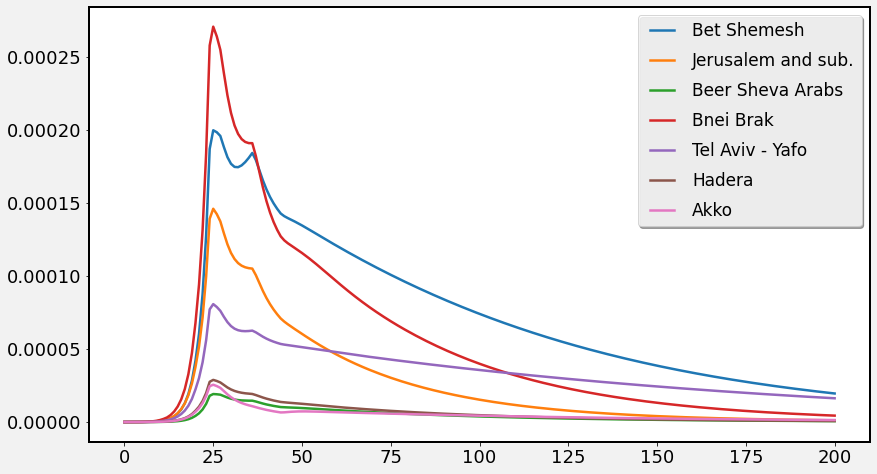

In [60]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.cell[region]] = (res_mdl_ub['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

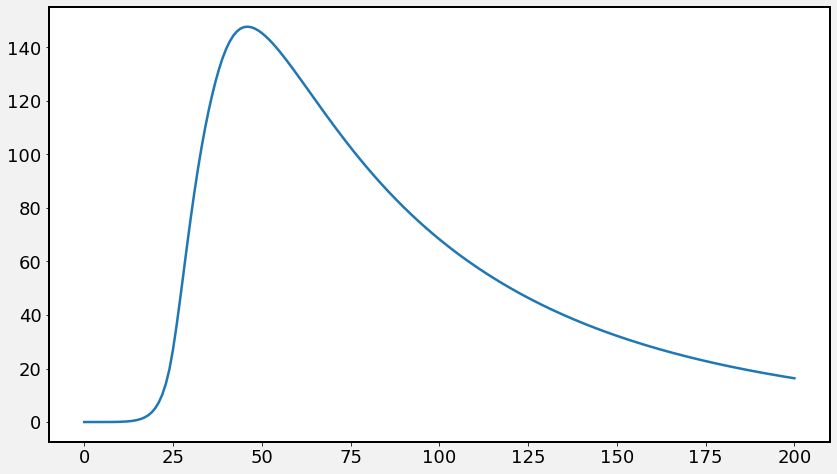

In [61]:
plt.plot(res_mdl_ub['H'].sum(axis=1)*9136000)

In [62]:
res_mdl_ub['new_Is'].sum()

0.005584832177592786

In [63]:
res_mdl['new_Is'][:55].sum(axis=1).sum()*9136000

11422.462861304366

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x28ee28b47c8>)

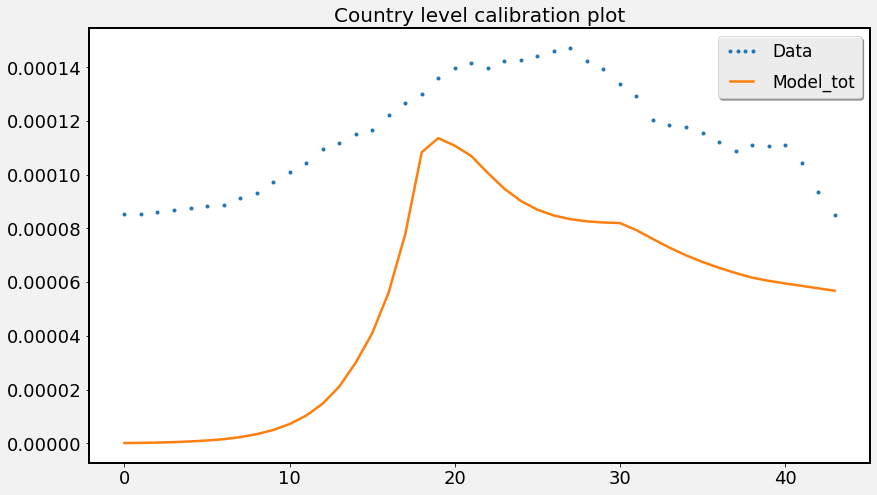

In [69]:
mdl.plot_calibrated_total_model(pd.DataFrame(data_ub[1])/9136000,res_mdl_ub,date_lst,start='2020-02-26',end='2020-04-09')

### Fit LB

In [67]:
# LB data:
data_lb = data.copy()
data_lb[1] = ((data[1]/9136000)*(1/3.))*isr_pop # beacuse the data_ub is 3 times bigger than data (on average)

In [71]:
model_lb = mdl.Model_behave(
    beta_j=np.array([0.02927922 ,0.02927922 ,0.02927922 ,0.04655266,0.04655266,0.05775265,0.05775265,0.18444245,0.18444245]),
    theta=2.826729434860104,
    beta_behave=0.5552998605894367,
    eps=mdl.eps_sector['Scenario2'],
    f=mdl.f0_full['Scenario2'],
    sigma=1/4.4,
    nu = 0.1
)

In [72]:
# Model Fitting
days_in_season=70
p0=(0.0981001,0.05305112,0.05157651,0.3,2.103427546494595, 0.23785134529029744) # initial guess
bnds = ((0,0.15),(0,0.15),(0,0.15),(0,0.54),(1.5,3),(0,0.7))# boundries for variables

In [73]:
res_fit_lb = model_lb.fit(
        p0=p0,
        bnds=bnds,
        data=data_lb,
        date_lst = date_lst,
        days_in_season=days_in_season,
        start='2020-02-26',
        end='2020-04-09',
        loss_func='MSE',
        maxiter=300,
        factor=1,
    )

iter:  50  loss:  -27.181030403365632
iter:  100  loss:  -27.324005094863548
iter:  150  loss:  -27.417889748892193
iter:  200  loss:  -27.452283765212307
iter:  250  loss:  -27.49589854121468
iter:  300  loss:  -27.03173309774277
iter:  350  loss:  -27.50822747279203
iter:  400  loss:  -27.5082782293353
iter:  450  loss:  -27.508957219664442
iter:  500  loss:  -27.509046834169368
iter:  550  loss:  -27.509182819102385
iter:  600  loss:  -27.509185786333546
iter:  650  loss:  -27.50918760527744
iter:  700  loss:  -27.509188734289065
iter:  750  loss:  -27.509189261310294
iter:  800  loss:  -27.509189977173456
iter:  850  loss:  -27.509155259072585
iter:  900  loss:  -27.50919363380787
iter:  950  loss:  -27.50917881555753
iter:  1000  loss:  -27.509196094579124
iter:  1050  loss:  -27.509192847682876
iter:  1100  loss:  -27.509196678626083
iter:  1150  loss:  -27.484799518613286
iter:  1200  loss:  -27.509669911238706
iter:  1250  loss:  -27.51009349570677
iter:  1300  loss:  -27.51010

In [74]:
mdl.print_stat_fit_behave(res_fit_lb)

minimized value: -27.53311302804272
Fitted parameters:
 Beta=[0.04909444 0.02292042 0.01912638 0.1331989 ]
 Theta=2.839846134144761,
 Beta_behave=0.4244872199315455
num of sampling the target function: 300


In [78]:
model_lb.reset()
res_mdl_lb = model_lb.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

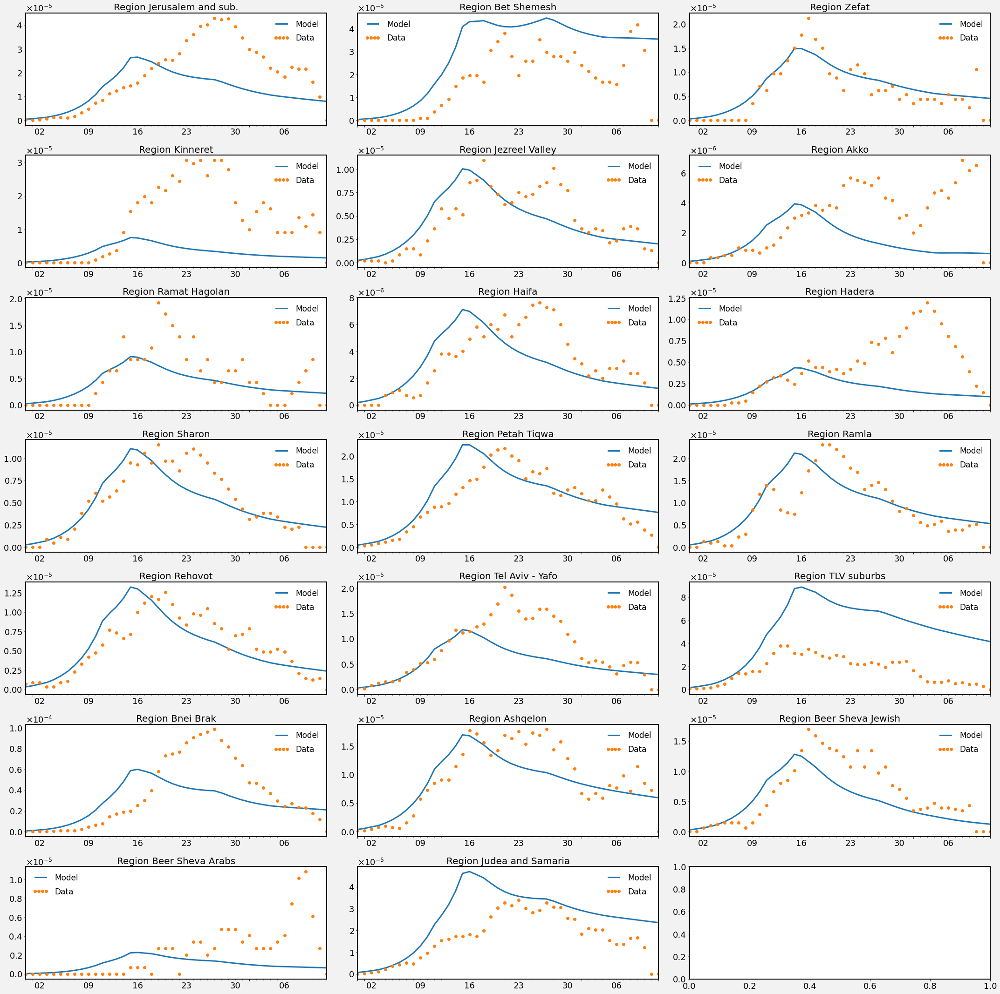

In [76]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=data_lb, 
                                          mdl_data = res_mdl_ub_lb['new_Is'],
                                          date_list = date_lst,
                                          start='2020-02-29',
                                          end='2020-04-12',
                                          region_name = mdl.cell,
                                          loss_func = 'MSE')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

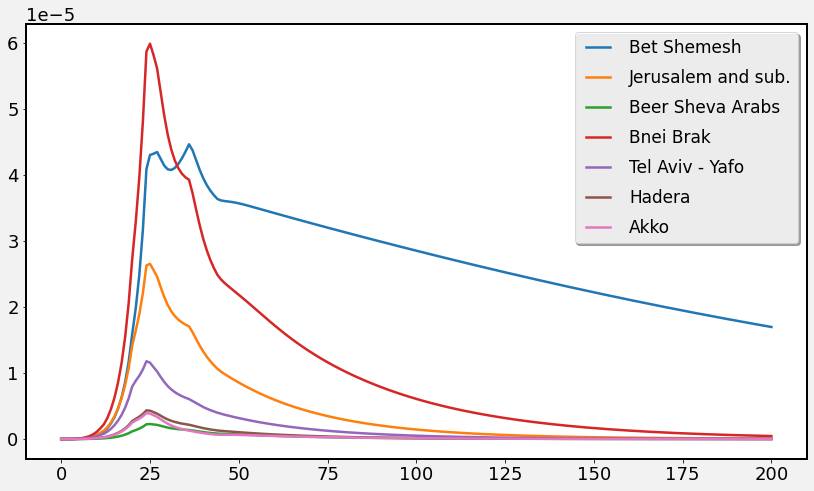

In [79]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.cell[region]] = (res_mdl_lb['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

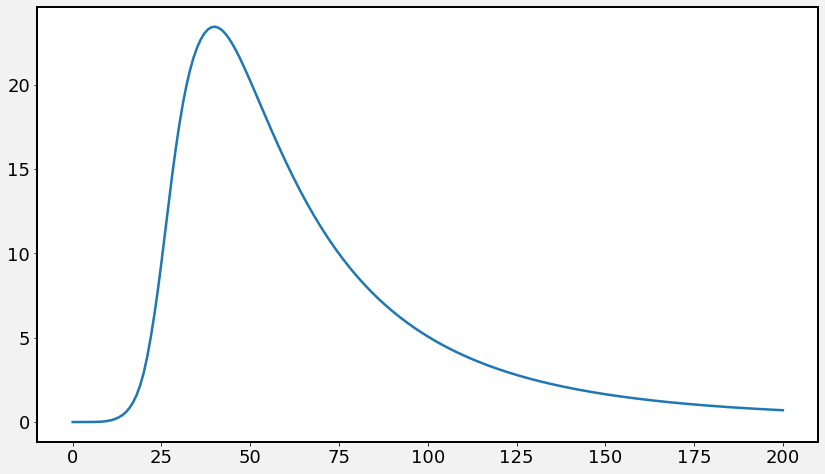

In [80]:
plt.plot(res_mdl_lb['H'].sum(axis=1)*9136000)

In [81]:
res_mdl_lb['new_Is'][:55].sum(axis=1).sum()

0.00044320859930587045

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x28ee24a5a08>)

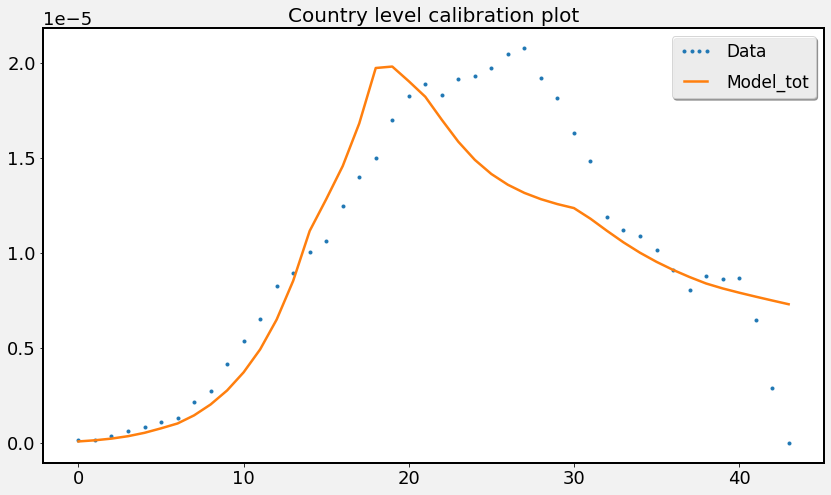

In [82]:
mdl.plot_calibrated_total_model(pd.DataFrame(data_lb[1])/9136000,res_mdl_lb,date_lst,start='2020-02-26',end='2020-04-09')

## Scenario 1

In [25]:
scen = 'Scenario1'
sc1_res_dict = {}

In [22]:
model_1_ml = mdl.Model_behave(
    ind,
    beta_j=np.array([0.02184738 ,0.02184738 ,0.02184738 ,0.00211441,0.00211441,0.0,0.0,0.0,0.0]),
    theta=3.0,
    beta_behave=0.6,
    eps=mdl.eps_sector[scen],
    f=mdl.f0_full[scen],
    seasonality=True
                              
)

In [26]:
# fit params
start = pos_0303.index[0]
end = pos_0303.index[-1]
date_lst = pd.date_range('2020-02-21',end)
len(date_lst)

69

In [24]:
# Model Fitting
p0=(0.0981001,0.05305112,0.05157651,0.3,2.103427546494595, 0.23785134529029744) # initial guess
bnds = ((0,0.3),(0,0.2),(0,0.2),(0,0.6),(1.5,3),(0,0.6))# boundries for variables


In [25]:
model_1_ml.reset()

In [26]:
res_fit_1_ml = model_1_ml.fit(
        mapper=region_age_250_to_30,
        p0=p0,
        bnds=bnds,
        data=data,
        date_lst = date_lst,
        start=start,
        end=end,
        loss_func='MSE',
        maxiter=85,
        factor=1,
    )

KeyboardInterrupt: 

In [47]:
res_fit_1_ml.x[5]

2.103427546494595

In [48]:
print('minimized value:', res_fit_1_ml.fun)
print('Fitted parameters:\n Beta={0}\n Theta={1},\n,Beta_behave={2}'.format(res_fit_1_ml.x[:4],
                                                                                  res_fit_1_ml.x[4],
                                                                                  res_fit_1_ml.x[5],))

print('num of sampling the target function:', res_fit_1_ml.nfev)

minimized value: -25.650313562191922
Fitted parameters:
 Beta=[0.04725047 0.02563524 0.0174036  0.09459708]
 Theta=1.6647892207308315,
,Beta_behave=2.103427546494595
num of sampling the target function: 85


In [38]:
mdl.print_stat_fit_behave(res_fit_1_ml)

minimized value: -25.650313562191922


IndexError: tuple index out of range

In [56]:
# model_1_ml.reset()
model_1_ml.update({'beta_behave': 0.01})
res_mdl_1_ml = model_1_ml.predict(
    C=mdl.C_calibration,
    days_in_season=100,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

In [57]:

print(model_1_ml.theta)
print(model_1_ml.beta_behave)
model_1_ml.beta_j

1.6647892207308315
0.01


array([0.04725047, 0.04725047, 0.04725047, 0.02563524, 0.02563524,
       0.0174036 , 0.0174036 , 0.09459708, 0.09459708])

In [71]:
model_1_ml.sigma

0.6666666666666666

In [88]:
model_1_ml.update({'seasonality':0.0,'noise':0.0, 'beta_j':np.array([0.10167117, 0.10167117, 0.10167117, 0.05606748, 0.05606748,
       0.04709613, 0.04709613, 0.25676354, 0.25676354])*0.95,'beta_behave':0.18876288297385702*1.45,'theta':2.0684200685446243,
                  'theta_arab':1})

In [27]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(mdl_mapper=region_250_to_30,
                                          data=data, 
                                          mdl_data = res_mdl['new_Is'],
                                          date_list = date_lst,
                                          start=start,
                                          end=end,
                                          region_name = {k:k for k in region_250_to_30.keys()},
                                          loss_func = 'MSE',
                                         ind=ind,
                                         data_mapper=region_ga_250_to_30)
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

NameError: name 'res_mdl' is not defined

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0xaae26d8>)

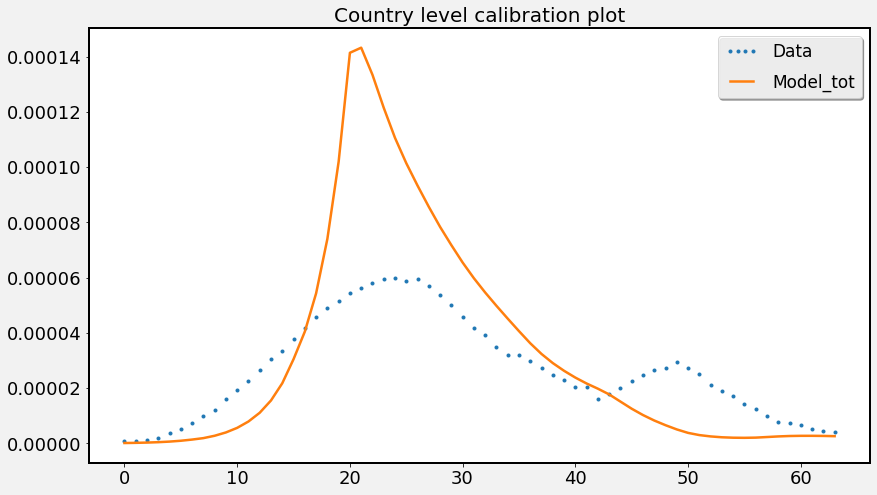

In [33]:
mdl.plot_calibrated_total_model(pd.DataFrame(data[1])/mdl.pop_israel, res_mdl, date_lst, start=start,end=end)
# plt.vlines(x=14,ymin=0, ymax=0.0001)
# plt.vlines(x=23-6,ymin=0, ymax=0.0001, color='r')

In [71]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(mdl_mapper=region_250_to_30,
                                          data=data, 
                                          mdl_data = res_mdl_1_ml['new_Is'],
                                          date_list = date_lst,
                                          start=start,
                                          end=end,
                                          region_name = {k:k for k in region_250_to_30.keys()},
                                          loss_func = 'MSE',
                                         ind=ind,
                                         data_mapper=region_ga_250_to_30)
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

NameError: name 'res_mdl_1_ml' is not defined

In [ ]:
pos['11_haredi'].sum(axis=1).sum()

In [34]:
data[1].shape

(58, 270)

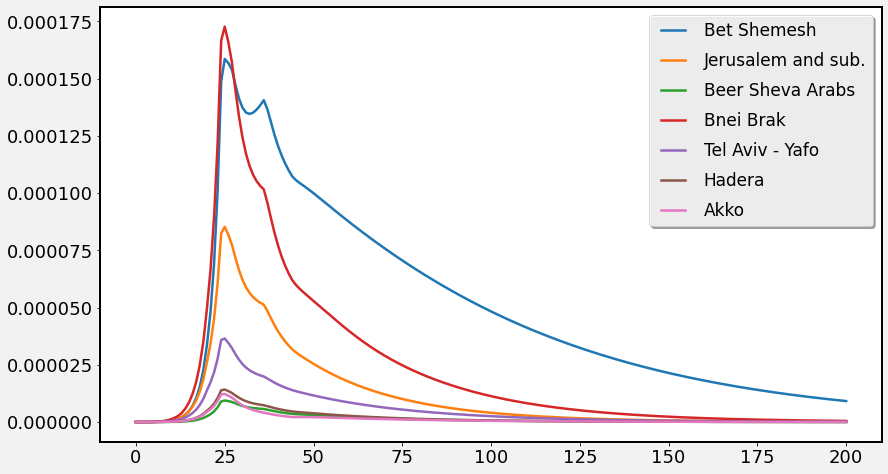

In [43]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.cell[region]] = (res_mdl_1_ml['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

In [44]:
(res_mdl_1_ml['new_Is']).sum()

0.0019663445007443684

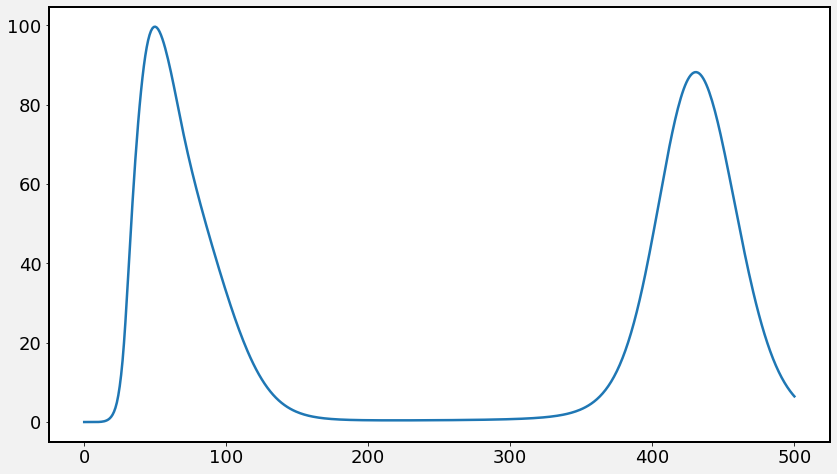

In [57]:
plt.plot(res_mdl_1_ml['Vents'].sum(axis=1)*9136000)

In [29]:
date_lst[-1]

Timestamp('2020-04-18 00:00:00', freq='D')

In [51]:
res_fit_1_ml

     fun: -25.51330176523653
     jac: array([-0.16147439, -0.18413466, -0.05365699, -0.05221992, -0.02340173,
        0.02914931,  0.04739604])
 message: 'Max. number of function evaluations reached'
    nfev: 85
     nit: 14
  status: 3
 success: False
       x: array([0.05538291, 0.03094061, 0.02608565, 0.12411311, 2.24557618,
       2.01235806, 0.24470738])

In [47]:
check = res_mdl_1_ml['S']+res_mdl_1_ml['E']+res_mdl_1_ml['Ia']+res_mdl_1_ml['Ie']+res_mdl_1_ml['Is']+res_mdl_1_ml['R']

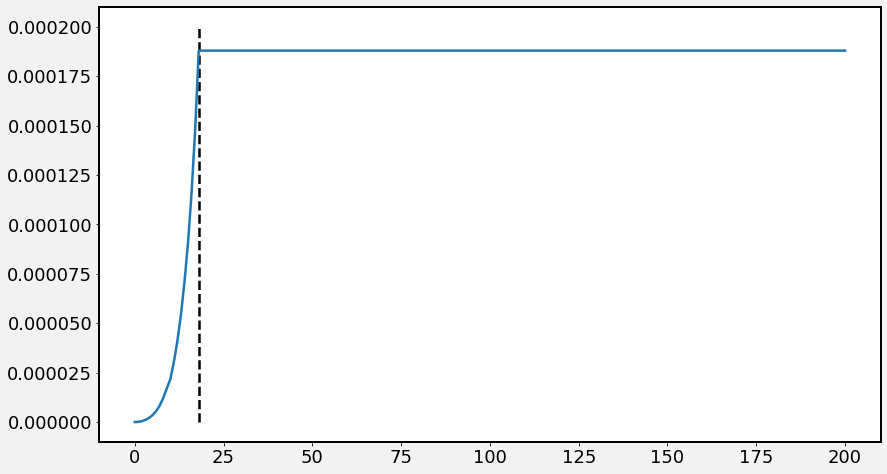

In [57]:
plt.plot(check.sum(axis=1)-1)
plt.vlines(x=18, ymin=-0.0,ymax=0.0002, linestyles='dashed')

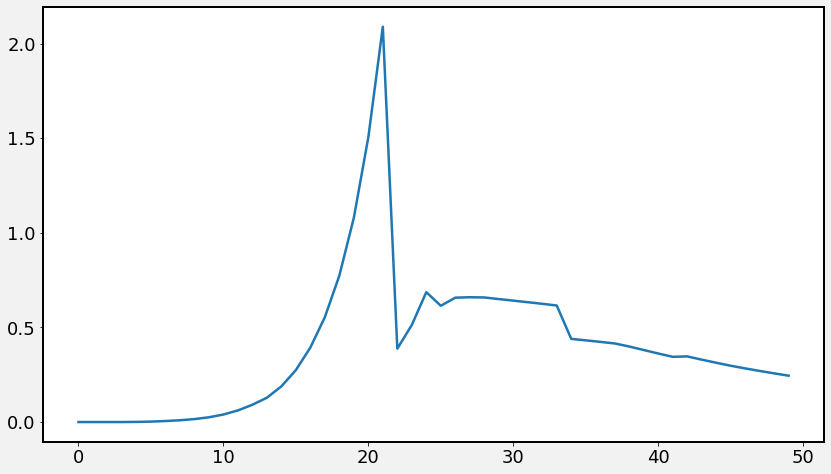

In [53]:
check2=res_mdl_1_ml['L'][:]# + res_mdl_1_ml['E'][:]
plt.plot(check2.sum(axis=1)[:50])
# plt.vlines(x=18, ymin=-0.0,ymax=0.0007, linestyles='dashed')

In [113]:
count = 0
for a in model_1_ml.eps[:18]:
    count += a.sum()


In [115]:
model_1_ml.eps

26075.717490872827

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1eeb7816d48>)

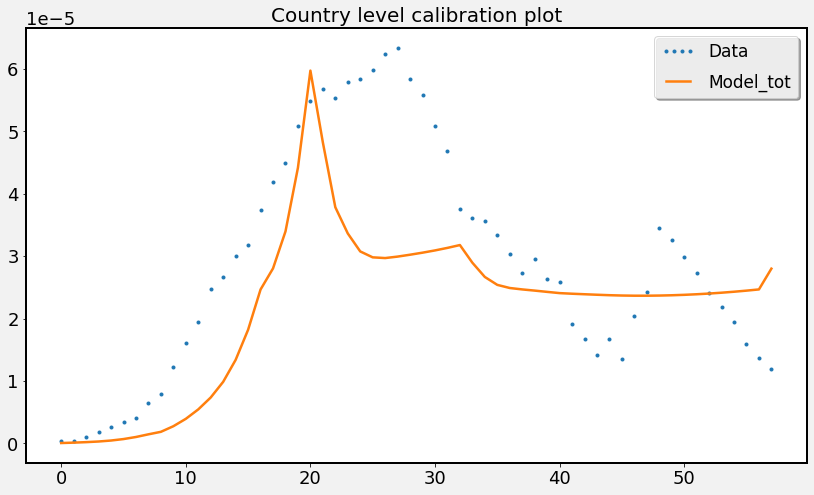

In [90]:
mdl.plot_calibrated_total_model(pd.DataFrame(data[1])/mdl.pop_israel,res_mdl_1_ml,date_lst,start='2020-02-26',end='2020-04-23')
# plt.vlines(x=14,ymin=0, ymax=0.0001)
# plt.vlines(x=23-6,ymin=0, ymax=0.0001, color='r')

In [49]:
# Saving new params:
sc1_res_dict['ml'] = {'beta_j':model_1_ml.beta_j,
                  'theta': model_1_ml.theta,
                  'beta_behave': model_1_ml.beta_behave}

In [85]:
int(np.where(date_lst == '2020-03-14')[0])

23

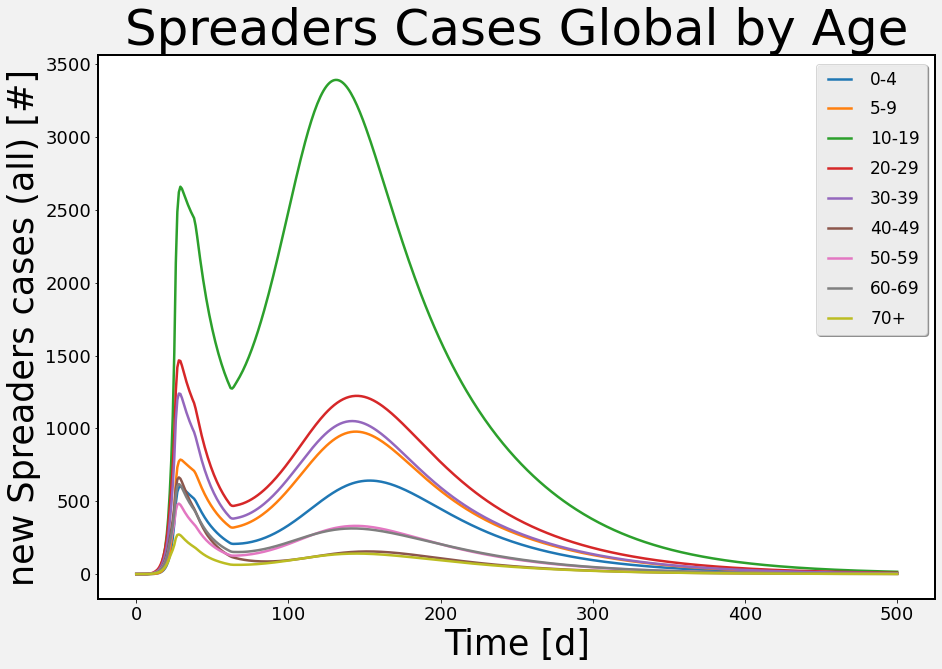

(<Figure size 1080x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1eebe585408>)

In [66]:
mdl.plot_I_by_age(cell_250,res_mdl_1_ml)

In [59]:
res_mdl_1_ml['R'][-1,:].sum()

0.020507597171341894

In [70]:
mdl_1_ml.sigma

NameError: name 'mdl_1_ml' is not defined

### Model Variance

In [51]:
model_start_idx = int(np.where(date_lst == '2020-02-26')[0])
model_end_idx = int(np.where(date_lst == '2020-04-09')[0])

In [52]:
# Calculation of variance:
# model results array based on region and age:
model_by_age_region = {}
for i, key in enumerate(mdl.region_age_dict.keys()):
    model_by_age_region[key[0] + '_' + key[1] + '_mdl'] = res_mdl_1_ml['new_Is'][model_start_idx:model_end_idx+1, mdl.region_age_dict[key]].sum(axis=1)
model_by_age_region = pd.DataFrame.from_dict(model_by_age_region)

In [54]:
model_std = (np.sqrt((np.power((data[1]/mdl.pop_israel - model_by_age_region.values),2).sum())/data[1].size))

In [55]:
model_std

2.38470757985708e-07

### Fit UB

In [57]:
# UB data:
data_ub = data.copy()
data_ub[1] = ((data[1]/mdl.pop_israel) + 1.96*model_std)*mdl.pop_israel

In [58]:
model_sc1_ub = mdl.Model_behave(
    beta_j=np.array([0.02927922 ,0.02927922 ,0.02927922 ,0.04655266,0.04655266,0.05775265,0.05775265,0.18444245,0.18444245]),
    theta=2.826729434860104,
    beta_behave=0.5552998605894367,
    eps=mdl.eps_sector['Scenario1'],
    f=mdl.f0_full['Scenario1'],
)

In [62]:
# Model Fitting
days_in_season=70
p0=(0.15,0.07317271 ,0.09578334 ,0.21491134,1.5, 0.34196516) # initial guess
bnds = ((0,0.2),(0,0.15),(0,0.15),(0,0.54),(1.0,3),(0,0.7))# boundries for variables

In [63]:
res_fit_sc1_ub = model_sc1_ub.fit(
        p0=p0,
        bnds=bnds,
        data=data_ub,
        date_lst = date_lst,
        days_in_season=days_in_season,
        start='2020-02-26',
        end='2020-04-09',
        loss_func='MSE',
        maxiter=400,
        factor=1,
    )

iter:  50  loss:  -23.89842939452973
iter:  100  loss:  -23.931588106209762
iter:  150  loss:  -23.939134736175387
iter:  200  loss:  -23.942157876932825
iter:  250  loss:  -23.942262938692647
iter:  300  loss:  -23.942309103922796
iter:  350  loss:  -23.94231916553848


In [64]:
mdl.print_stat_fit_behave(res_fit_sc1_ub)

minimized value: -23.942319166028202
Fitted parameters:
 Beta=[0.15559057 0.07505887 0.09156761 0.34091583]
 Theta=1.450842152574775,
 Beta_behave=0.21213702659889408
num of sampling the target function: 45


In [65]:
model_sc1_ub.reset()
res_mdl_sc1_ub = model_sc1_ub.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

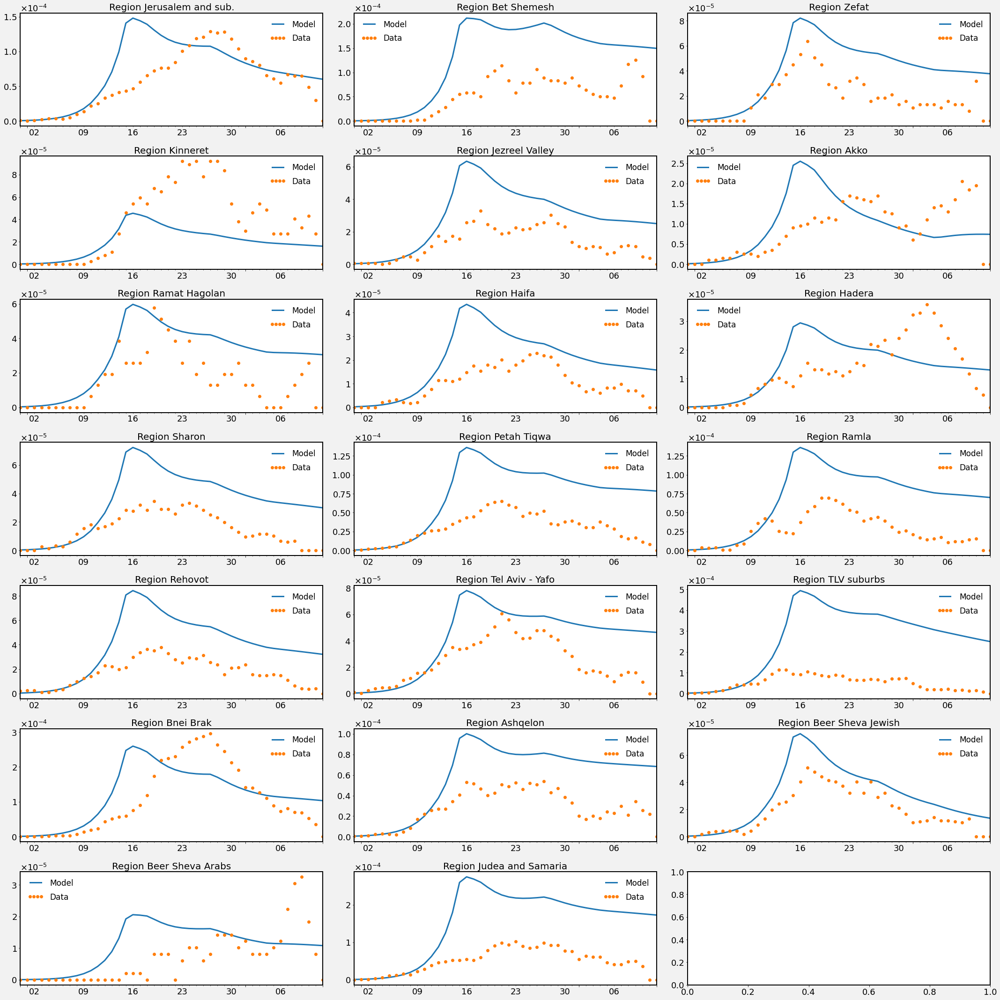

In [96]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=data, 
                                          mdl_data = res_mdl_sc1_ub['new_Is'],
                                          date_list = date_lst,
                                          start='2020-02-29',
                                          end='2020-04-12',
                                          region_name = mdl.cell,
                                          loss_func = 'MSE')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

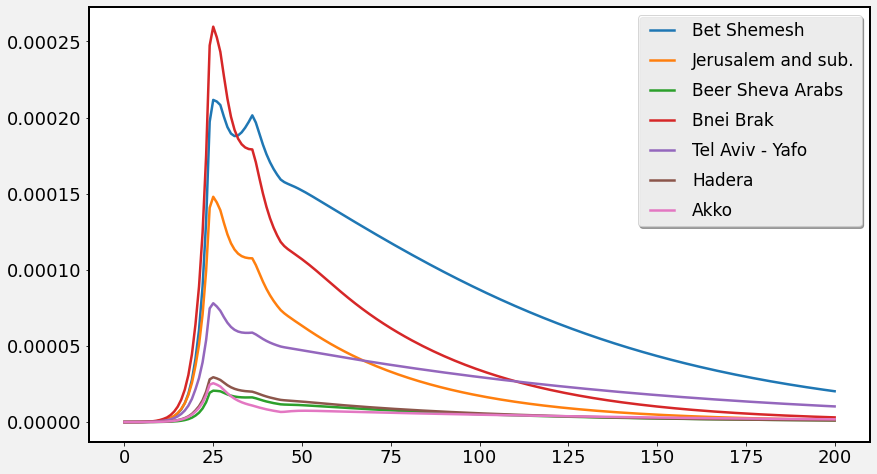

In [67]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.cell[region]] = (res_mdl_sc1_ub['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

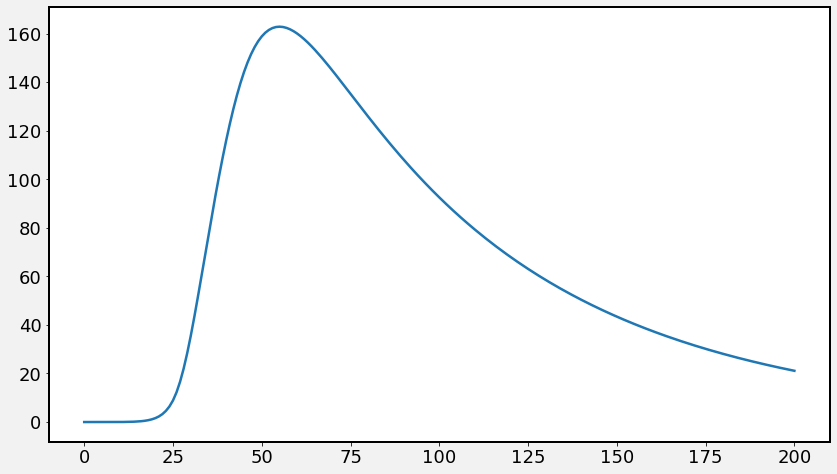

In [69]:
plt.plot(res_mdl_sc1_ub['Vents'].sum(axis=1)*mdl.pop_israel)

In [70]:
res_mdl_sc1_ub['new_Is'].sum()

0.005674515808737207

In [63]:
res_mdl['new_Is'][:55].sum(axis=1).sum()*9136000

11422.462861304366

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1b583fe7a48>)

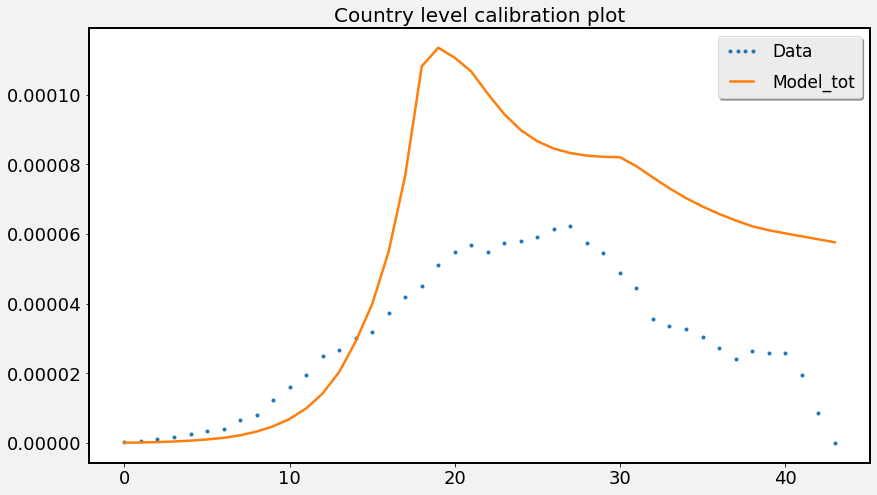

In [97]:
mdl.plot_calibrated_total_model(pd.DataFrame(data[1])/mdl.pop_israel,res_mdl_sc1_ub,date_lst,start='2020-02-26',end='2020-04-09')

In [79]:
# Saving new params:
sc1_res_dict['ub'] = {'beta_j':model_sc1_ub.beta_j,
                  'theta': model_sc1_ub.theta,
                  'beta_behave': model_sc1_ub.beta_behave}

### Fit LB

In [73]:
# LB data:
data_lb = data.copy()
data_lb[1] = ((data[1]/mdl.pop_israel)*(1/3.))*mdl.pop_israel # beacuse the data_ub is 3 times bigger than data (on average)

In [74]:
model_sc1_lb = mdl.Model_behave(
    beta_j=np.array([0.02927922 ,0.02927922 ,0.02927922 ,0.04655266,0.04655266,0.05775265,0.05775265,0.18444245,0.18444245]),
    theta=2.826729434860104,
    beta_behave=0.5552998605894367,
    eps=mdl.eps_sector['Scenario1'],
    f=mdl.f0_full['Scenario1'],
)

In [75]:
# Model Fitting
days_in_season=70
p0=(0.15,0.07317271 ,0.09578334 ,0.21491134,1.5, 0.34196516) # initial guess
bnds = ((0,0.2),(0,0.15),(0,0.15),(0,0.54),(1.0,3),(0,0.7))# boundries for variables

In [76]:
res_fit_sc1_lb = model_sc1_lb.fit(
        p0=p0,
        bnds=bnds,
        data=data_lb,
        date_lst = date_lst,
        days_in_season=days_in_season,
        start='2020-02-26',
        end='2020-04-09',
        loss_func='MSE',
        maxiter=400,
        factor=1,
    )

iter:  50  loss:  -26.982234464725085
iter:  100  loss:  -27.392829259804724
iter:  150  loss:  -27.40976439400809
iter:  200  loss:  -27.471938159358025
iter:  250  loss:  -27.478942019096873
iter:  300  loss:  -27.49974518657389
iter:  350  loss:  -27.525993609135607
iter:  400  loss:  -27.539104515818302
iter:  450  loss:  -27.540571874701428
iter:  500  loss:  -27.540527499172764
iter:  550  loss:  -27.541133122821858
iter:  600  loss:  -27.541645041597558
iter:  650  loss:  -27.541696027972918
iter:  700  loss:  -27.541602624470165
iter:  750  loss:  -27.541908241219097
iter:  800  loss:  -27.54193097885751
iter:  850  loss:  -27.54193333365858
iter:  900  loss:  -27.541935284347204
iter:  950  loss:  -27.541920270962013
iter:  1000  loss:  -27.541940784408293
iter:  1050  loss:  -27.541886905063144
iter:  1100  loss:  -27.540559607969367
iter:  1150  loss:  -27.541941640525113
iter:  1200  loss:  -27.541941799316984


In [77]:
mdl.print_stat_fit_behave(res_fit_sc1_lb)

minimized value: -27.54194203313532
Fitted parameters:
 Beta=[0.06825481 0.02477477 0.02173894 0.09063173]
 Theta=2.6101521960945213,
 Beta_behave=0.36055692423711205
num of sampling the target function: 153


In [80]:
model_sc1_lb.reset()
res_mdl_sc1_lb = model_sc1_lb.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

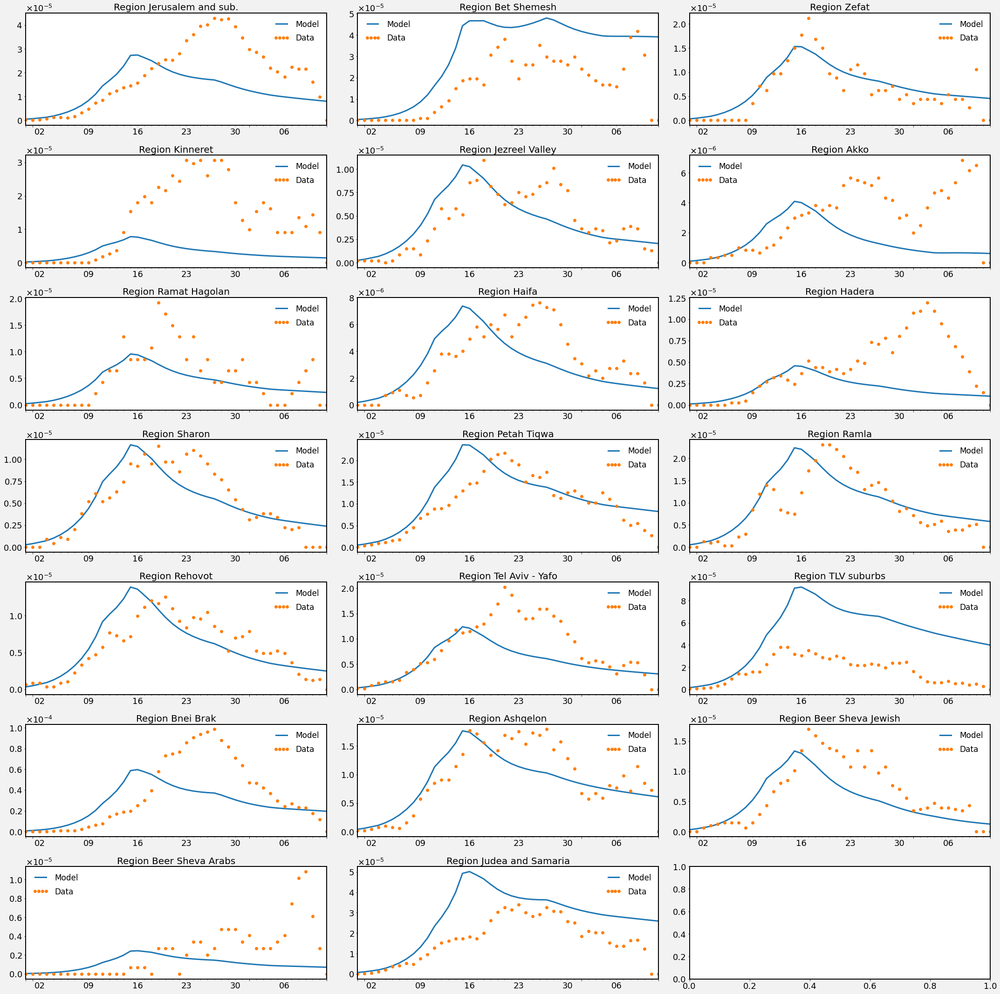

In [81]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=data_lb, 
                                          mdl_data = res_mdl_sc1_lb['new_Is'],
                                          date_list = date_lst,
                                          start='2020-02-29',
                                          end='2020-04-12',
                                          region_name = mdl.cell,
                                          loss_func = 'MSE')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

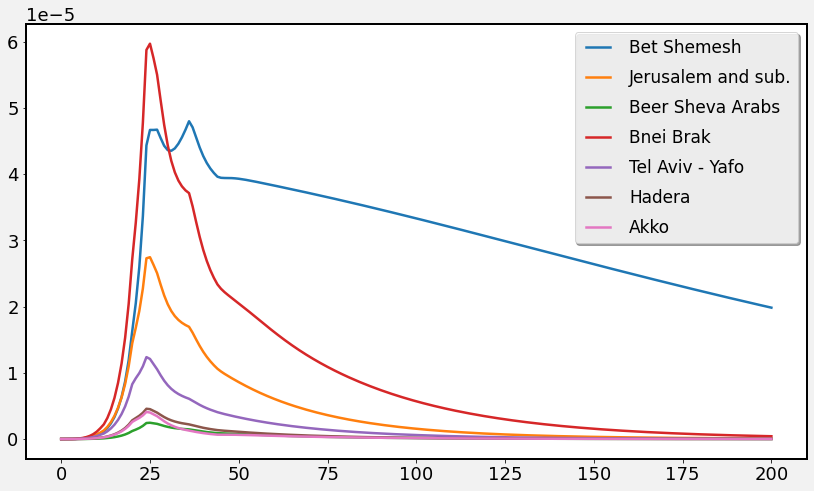

In [82]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.cell[region]] = (res_mdl_sc1_lb['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

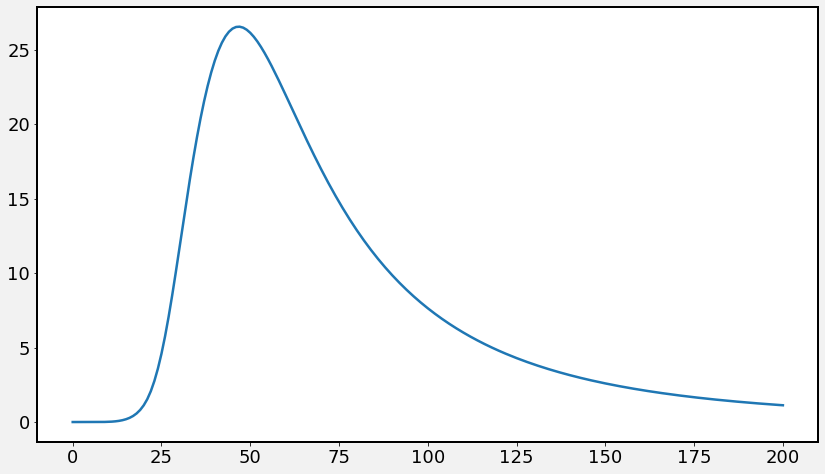

In [83]:
plt.plot(res_mdl_sc1_lb['Vents'].sum(axis=1)*9136000)

In [84]:
res_mdl_sc1_lb['new_Is'].sum()

0.000742525103480433

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1b58767a908>)

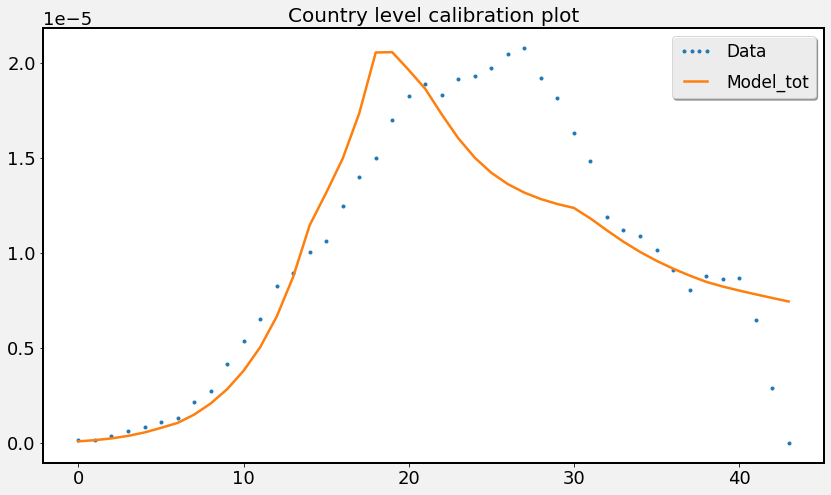

In [85]:
mdl.plot_calibrated_total_model(pd.DataFrame(data_lb[1])/mdl.pop_israel,res_mdl_sc1_lb,date_lst,start='2020-02-26',end='2020-04-09')

In [87]:
# Saving new params:
sc1_res_dict['lb'] = {'beta_j':model_sc1_lb.beta_j,
                  'theta': model_sc1_lb.theta,
                  'beta_behave': model_sc1_lb.beta_behave}

### Fit UB for different CIs

======checking CI 90.0%=======
iter:  50  loss:  -24.780784766221117
iter:  100  loss:  -24.81500129230952
iter:  150  loss:  -24.820716651498714
iter:  200  loss:  -24.822054796215838
iter:  250  loss:  -24.82211332207377
iter:  300  loss:  -24.821417235420803
iter:  350  loss:  -24.822217709345495
iter:  400  loss:  -24.822249654146038
iter:  450  loss:  -24.822320446614416
iter:  500  loss:  -24.8230806510109
iter:  550  loss:  -24.823569363693757
iter:  600  loss:  -24.82367145726903
iter:  650  loss:  -24.800520409594213
iter:  700  loss:  -24.824136201314758
iter:  750  loss:  -24.785058572109854
iter:  800  loss:  -24.821705413566935
iter:  850  loss:  -24.829479110190558
iter:  900  loss:  -24.829833242946926
iter:  950  loss:  -24.828911867835288
iter:  1000  loss:  -24.8262179535917
iter:  1050  loss:  -24.829856831506014
iter:  1100  loss:  -24.82985924663741
iter:  1150  loss:  -24.82986040146283
iter:  1200  loss:  -24.829860539157075
iter:  1250  loss:  -24.82986057050343

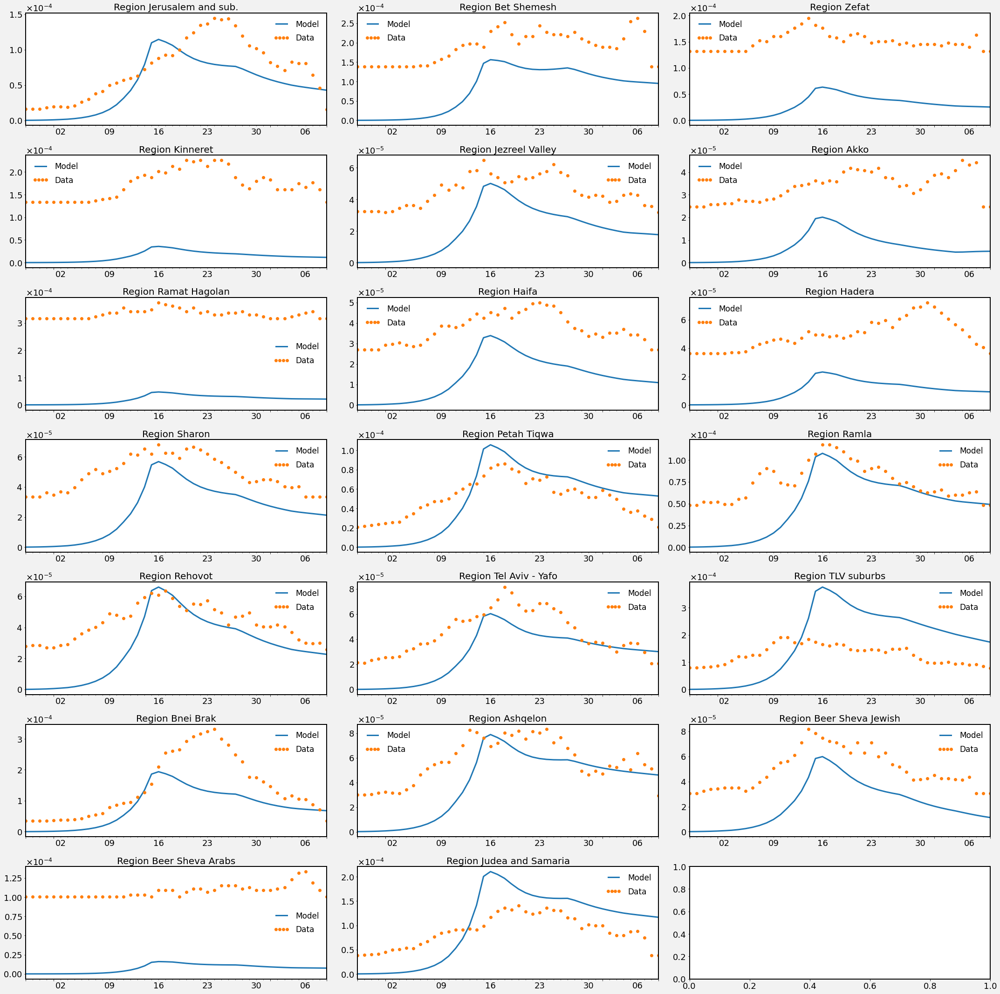

======checking CI 87.5%=======
iter:  50  loss:  -24.91686819415043
iter:  100  loss:  -24.94964018802996
iter:  150  loss:  -24.850947241557616
iter:  200  loss:  -24.609888762662152
iter:  250  loss:  -24.955674032388682
iter:  300  loss:  -24.95582355436978
iter:  350  loss:  -24.955953578694693
iter:  400  loss:  -24.956031686085137
iter:  450  loss:  -24.956030347022875
iter:  500  loss:  -24.938657679416895
iter:  550  loss:  -24.95707570410049
iter:  600  loss:  -24.957963009250943
iter:  650  loss:  -24.95827877835421
iter:  700  loss:  -24.957600861526096
iter:  750  loss:  -24.958913029800115
iter:  800  loss:  -24.958930263804334
iter:  850  loss:  -24.959243672304382
iter:  900  loss:  -24.959354660099134
iter:  950  loss:  -24.959439080983632
iter:  1000  loss:  -24.834414890540064
iter:  1050  loss:  -24.9594599744092
iter:  1100  loss:  -24.957789316288537
iter:  1150  loss:  -24.03470788777674
iter:  1200  loss:  -24.959343896959624
iter:  1250  loss:  -24.8601048817535

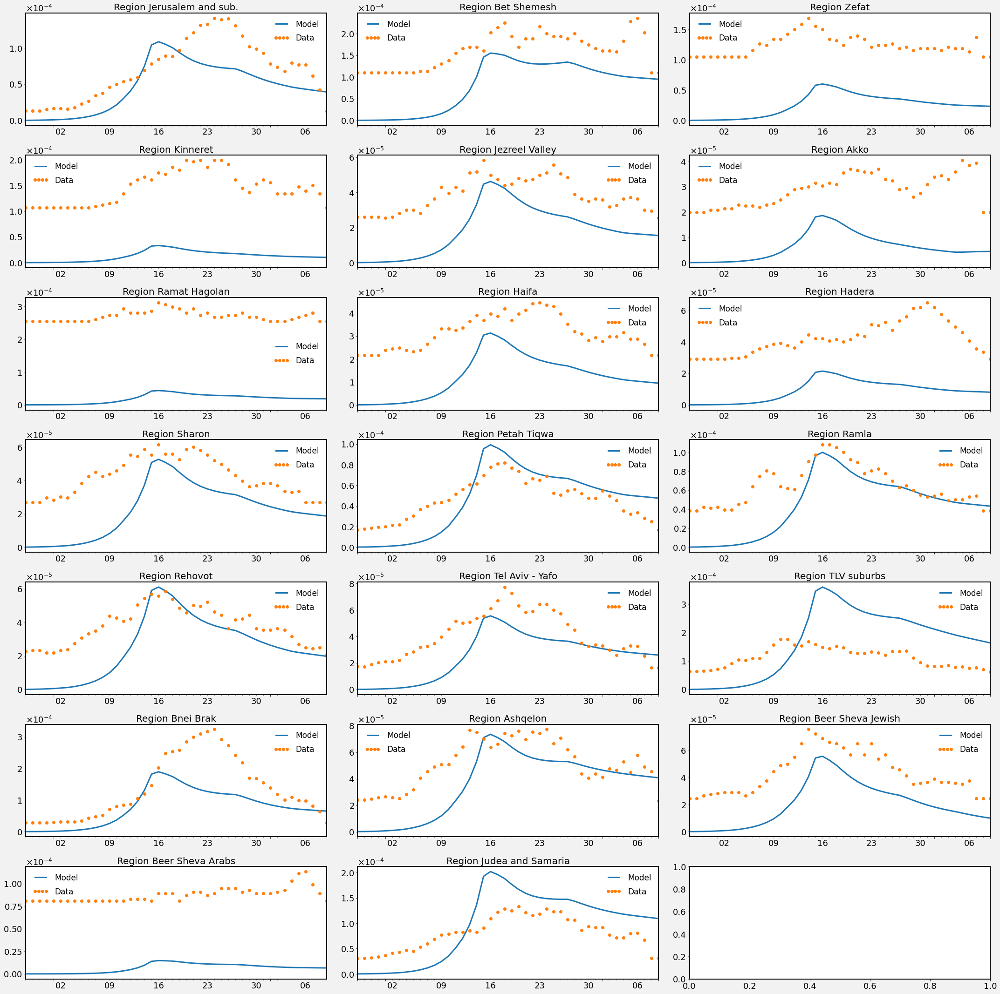

======checking CI 85.0%=======
iter:  50  loss:  -24.999168308970006
iter:  100  loss:  -25.061214811817077
iter:  150  loss:  -24.91820758041395
iter:  200  loss:  -25.06373356116666
iter:  250  loss:  -25.051315195579612
iter:  300  loss:  -25.06434214384088
iter:  350  loss:  -25.06484665744744
iter:  400  loss:  -25.065354737459433
iter:  450  loss:  -25.06621384331331
iter:  500  loss:  -25.0657083741356
iter:  550  loss:  -25.065422721716466
iter:  600  loss:  -25.06617779541513
iter:  650  loss:  -25.06657574511895
iter:  700  loss:  -25.066585710929772
iter:  750  loss:  -25.064529802085524
iter:  800  loss:  -25.06659039396978
iter:  850  loss:  -25.06658676398075
iter:  900  loss:  -25.06645410689363
iter:  950  loss:  -25.066600159431044
iter:  1000  loss:  -25.066600219472527
iter:  1050  loss:  -25.066600273933137
iter:  1100  loss:  -25.066572625694754
iter:  1150  loss:  -25.066600295275382
iter:  1200  loss:  -25.066600333827488
iter:  1250  loss:  -25.066600501967777
m

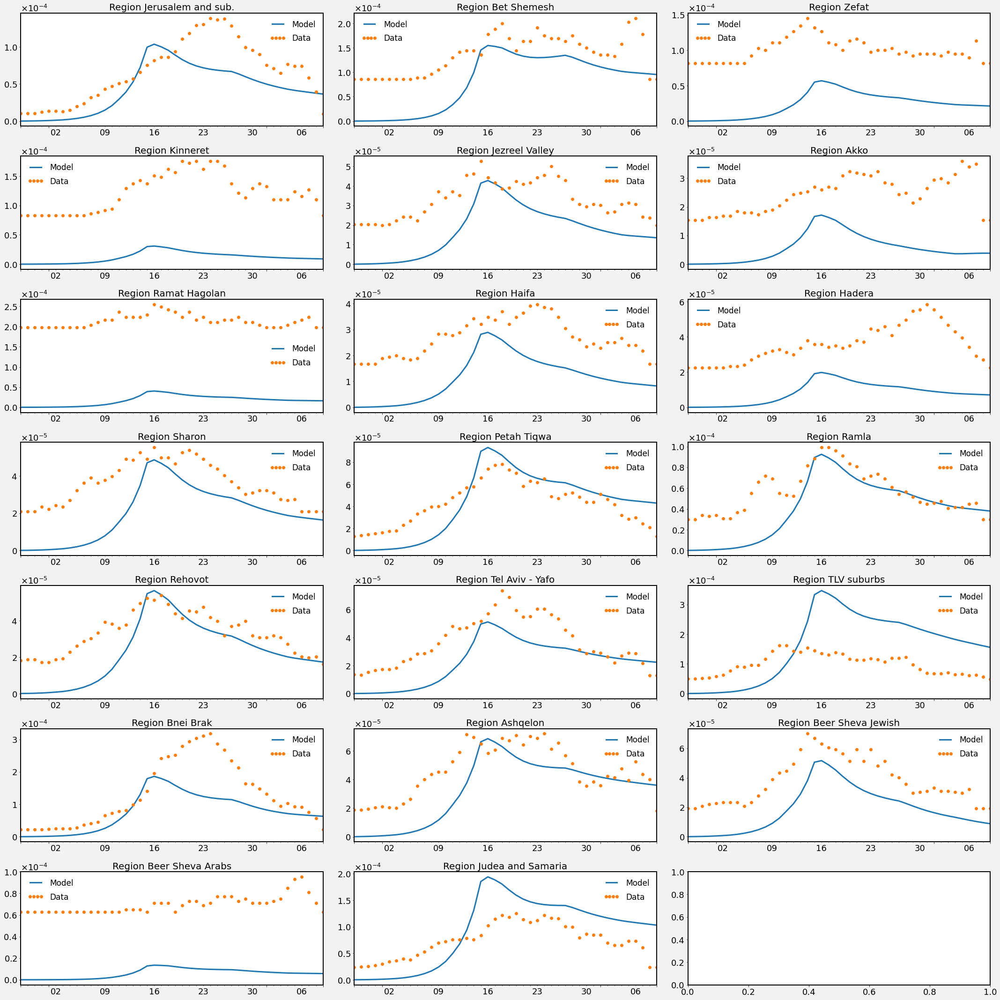

In [88]:
all_calibrations = {}
for percent,z in [('80%',0.842), ('75%',0.674), ('70%',0.524)]:
    res_model = {}
    print('======checking CI {}%======='.format(100 - (100-float(percent[:-1]))/2))
    # calculate new data:
    new_data = data.copy()
    new_data[1] = ((data[1]/mdl.pop_israel) + z*model_std)*mdl.pop_israel
    
    # initializing model:
    curr_mdl = mdl.Model_behave(
    beta_j=np.array([0.02927922 ,0.02927922 ,0.02927922 ,0.04655266,0.04655266,0.05775265,0.05775265,0.18444245,0.18444245]),
    theta=2.826729434860104,
    beta_behave=0.5552998605894367,
    eps=mdl.eps_sector['Scenario1'],
    f=mdl.f0_full['Scenario1'],
    sigma=1/4.4,
    nu=0.1
    )
#      Model Fitting
    days_in_season=70
    p0=(0.15,0.07317271 ,0.09578334 ,0.21491134,1.5, 0.34196516) # initial guess
    bnds = ((0,0.2),(0,0.15),(0,0.15),(0,0.54),(1.0,3),(0,0.7))# boundries for variabless
    
    res_fit_curr = curr_mdl.fit(
        p0=p0,
        bnds=bnds,
        data=new_data,
        date_lst = date_lst,
        days_in_season=days_in_season,
        start='2020-02-26',
        end='2020-04-09',
        loss_func='MSE',
        maxiter=300,
        factor=1,
    )
    mdl.print_stat_fit_behave(res_fit_curr)
    
    curr_mdl.reset()
    res_mdl_curr = curr_mdl.predict(
        C=mdl.C_calibration,
        days_in_season=200,
        stay_home_idx=mdl.stay_home_idx,
        not_routine=mdl.not_routine,
    )
        
        # plotting the data and model
    fig,ax = mdl.plot_calibrated_model_region(data=new_data, 
                                              mdl_data = res_mdl_curr['new_Is'],
                                              date_list = date_lst,
                                              start='2020-02-26',
                                              end='2020-04-09',
                                              region_name = mdl.cell,
                                              loss_func = 'MSE')
    fig.set_size_inches((30,30))
    plt.tight_layout()
    plt.show()
    
    all_calibrations[percent] = {'beta_j':curr_mdl.beta_j, 'beta_behave':curr_mdl.beta_behave, 'theta':curr_mdl.theta}
    
    

In [92]:
sc1_res_dict.update(all_calibrations)

In [93]:
sc1_res_dict

{'ml': {'beta_j': array([0.12613143, 0.12613143, 0.12613143, 0.05380238, 0.05380238,
         0.05308456, 0.05308456, 0.21491134, 0.21491134]),
  'theta': 1.9795018496068204,
  'beta_behave': 0.21101978133981572},
 'ub': {'beta_j': array([0.15559057, 0.15559057, 0.15559057, 0.07505887, 0.07505887,
         0.09156761, 0.09156761, 0.34091583, 0.34091583]),
  'theta': 1.450842152574775,
  'beta_behave': 0.21213702659889408},
 'lb': {'beta_j': array([0.06825481, 0.06825481, 0.06825481, 0.02477477, 0.02477477,
         0.02173894, 0.02173894, 0.09063173, 0.09063173]),
  'theta': 2.6101521960945213,
  'beta_behave': 0.36055692423711205},
 '80%': {'beta_j': array([0.14665115, 0.14665115, 0.14665115, 0.06811326, 0.06811326,
         0.07776952, 0.07776952, 0.29529   , 0.29529   ]),
  'beta_behave': 0.21249821254490886,
  'theta': 1.4047213405317138},
 '75%': {'beta_j': array([0.14349232, 0.14349232, 0.14349232, 0.06567107, 0.06567107,
         0.07359085, 0.07359085, 0.28074984, 0.28074984]),

In [95]:
# Save calibrated params
with open('../Data/calibration/calibration_sc1_dict.pickle', 'wb') as handle:
    pickle.dump(sc1_res_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

# Amit's fit

## Data old

In [24]:
# data = pd.read_csv('../Data/sick/old_data2003_1304.csv', index_col=0)
# data.head()

## Scenario 2

In [25]:
# fit params
days_in_season=70
date_lst = pd.date_range('2020-02-20',last)
len(date_lst)

54

In [96]:
# Model Fitting
p0=(0.03574392,0.0680812,0.07149694,0.24919698,1.8512674898217287, 0.40194272460656777) # initial guess
bnds = ((0,0.1),(0,0.15),(0,0.15),(0,0.3),(1.5,3),(0,0.6))# boundries for variables
res_fit = []
fitted_params = []
fitted_beta = []
theta = []
######## Doind Exp:
######## checking shift, different losses, and factors:
for i, (factor, shift, loss) in enumerate(itertools.product(
    [1 ,10 ,100, 500, 1000],
    np.arange(-7, 7, 1),
    ['MSE', 'BIN', 'POIS', 'POIS_NAIV'],
)):
    print('Checking combination: ', (factor, shift, loss))
    #defining shift
    pos_shift = pos.copy()
    tot_shift = tot.copy()
    pos_shift.index = pd.DatetimeIndex(pos.index + pd.DateOffset(shift))
    tot_shift.index = pd.DatetimeIndex(tot.index + pd.DateOffset(shift))
    pos_shift.index = pd.to_datetime(pos_shift.index)
    tot_shift.index = pd.to_datetime(tot_shift.index)
    min_d = max([pos_shift.index.values.min(), first])
    max_d = min([pos_shift.index.values.max(), last])
    pos_shift = pos_shift.loc[pd.date_range(min_d,max_d)]
    tot_shift = tot_shift.loc[pd.date_range(min_d,max_d)]
    
    data = np.ndarray((2,len(pos_shift), len(mdl.GA.values())))
    data[0] = tot_shift
    data[1] = pos_shift
    
    res_fit.append(model.fit(
        p0=p0,
        bnds=bnds,
        data=data,
        date_lst = date_lst,
        days_in_season=days_in_season,
        start=min_d,
        end=max_d,
        loss_func=loss,
        maxiter=300,
        factor=factor,
    ))
    # errorfunc(tpl,data,f,season_length, eps, alpha)


    fitted_params.append(res_fit.x)

    # run the fitted model:
    fitted_beta.append(np.array([fitted_params[0], fitted_params[0], fitted_params[0], fitted_params[1], fitted_params[1],\
                            fitted_params[2], fitted_params[2], fitted_params[3], fitted_params[3]]))
    theta.append(fitted_params[4])
    beta_behave.append(fitted_params[5])
                        
# print data stat
mdl.print_stat_fit_behave(res_fit)


Checking combination:  (1, -7, 'MSE')
iter:  50  loss:  -24.417526001936896
iter:  100  loss:  -24.78465318081429
iter:  150  loss:  -24.7954446019401
iter:  200  loss:  -24.801256059212246
iter:  250  loss:  -24.81054238018346
iter:  300  loss:  -24.813893869109652
iter:  350  loss:  -24.81374899234063
iter:  400  loss:  -24.80498127858645


KeyboardInterrupt: 

In [13]:
# # last
# fitted_beta = [0.08401885, 0.0498636, 0.04742293, 0.29044575]
# fitted_beta = np.array([fitted_beta[0], fitted_beta[0], fitted_beta[0], 
#                    fitted_beta[1], fitted_beta[1], 
#                    fitted_beta[2], fitted_beta[2], 
#                    fitted_beta[3], fitted_beta[3]])
# theta = 1.7884756534064268
# beta_behave = 0.3114150965784499

In [14]:
# model.update({
#     'beta_j': fitted_beta,
#     'theta': theta,
#     'beta_behave': beta_behave,
# })

In [15]:
model.reset()
res_mdl = model.predict(
    C=mdl.C_calibration,
    days_in_season=200,
    stay_home_idx=mdl.stay_home_idx,
    not_routine=mdl.not_routine,
)

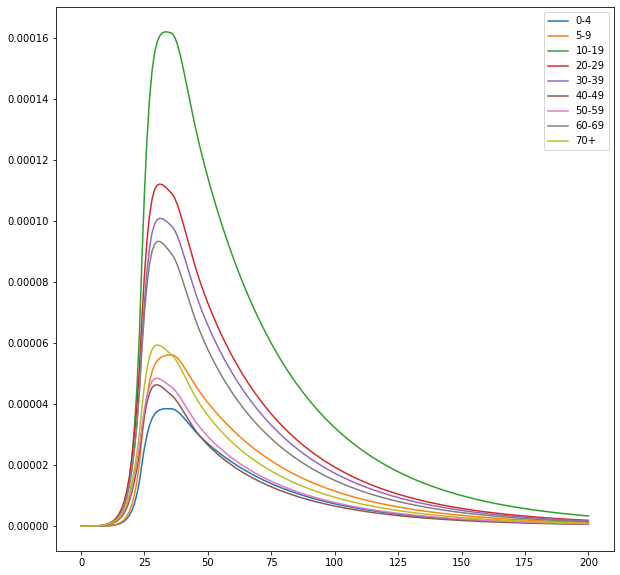

(<Figure size 720x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x9b476a0>)

In [16]:
mdl.plot_I_by_age(res_mdl)

In [17]:
res_mdl['new_Is'].sum()

0.002522545709324517

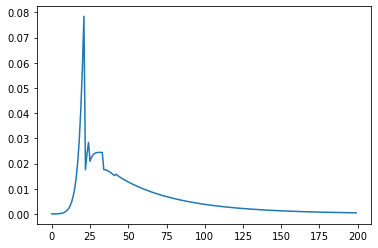

In [18]:
plt.plot((res_mdl['L'].sum(axis=1)))

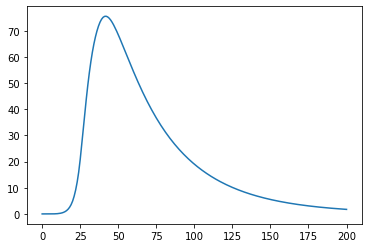

In [19]:
plt.plot((res_mdl['H'].sum(axis=1))*9136000)

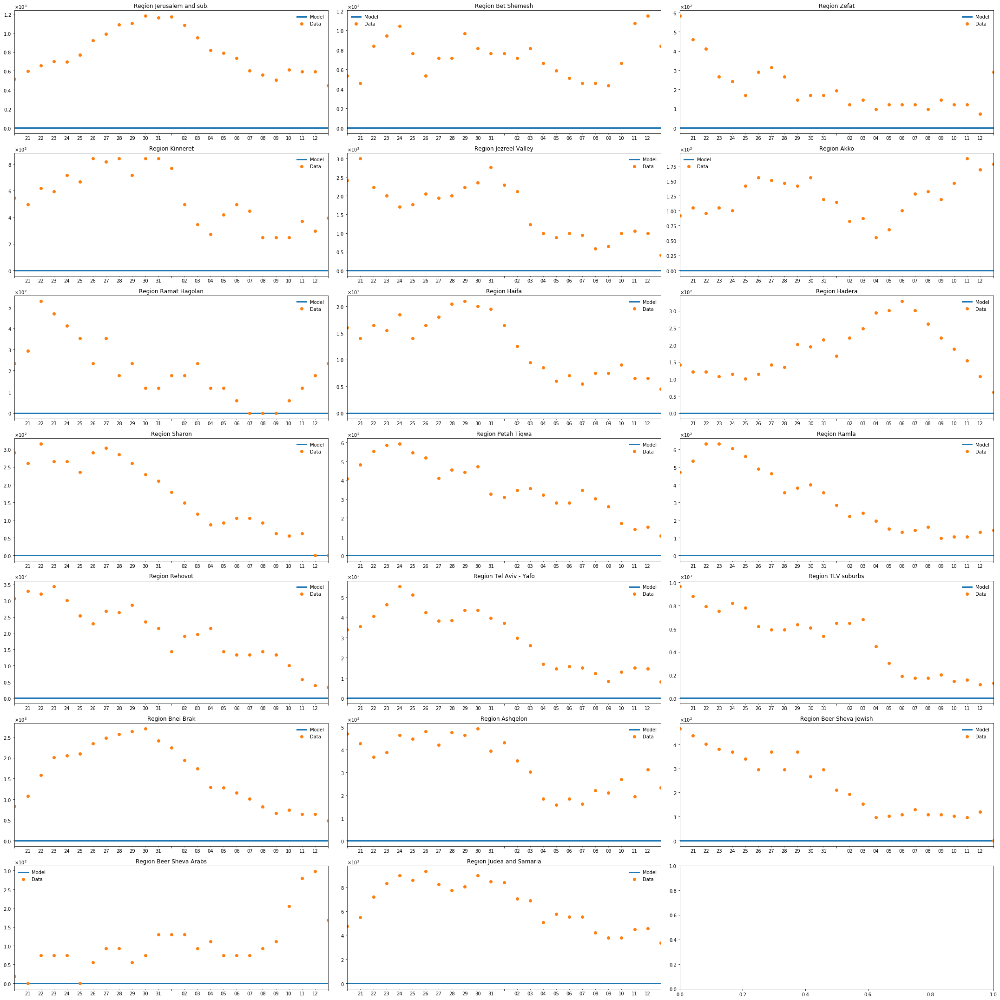

In [21]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=data, 
                                          mdl_data = res_mdl['new_Is'],
                                          date_list = date_lst,
                                          start=first,
                                          end=last,
                                          region_name = mdl.cell,
                                          loss_func = 'Pois_Naiv')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

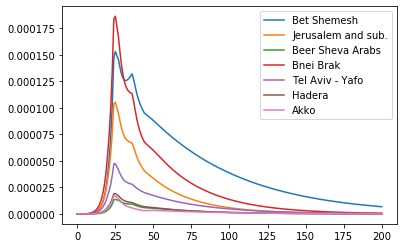

In [22]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.cell[region]] = (res_mdl['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

## old fit results

In [16]:
# best old fit results:
# alpha=1
# beta_j=np.array([0.02927922 ,0.02927922 ,0.02927922 ,0.04655266,0.04655266,0.05775265,0.05775265,0.18444245,0.18444245])
# theta=2.826729434860104
# beta_behave=0.5552998605894367
fitted_beta = [0.08401885, 0.0498636, 0.04742293, 0.29044575]
fitted_beta = np.array([beta_j[0], beta_j[0], beta_j[0], 
                   beta_j[1], beta_j[1], 
                   beta_j[2], beta_j[2], 
                   beta_j[3], beta_j[3]])
theta = 1.7884756534064268
beta_behave = 0.3114150965784499

In [3]:
res_mdl = mdl.run_sector_model_behave(beta_home=0.38/9., theta=theta, beta_j=beta_j, beta_behave=beta_behave,
                                        eps=mdl.eps_sector['Scenario2'], f=mdl.f0_full['Scenario2'], alpha=alpha, 
                                        days_in_season=175, nu=1/10.)

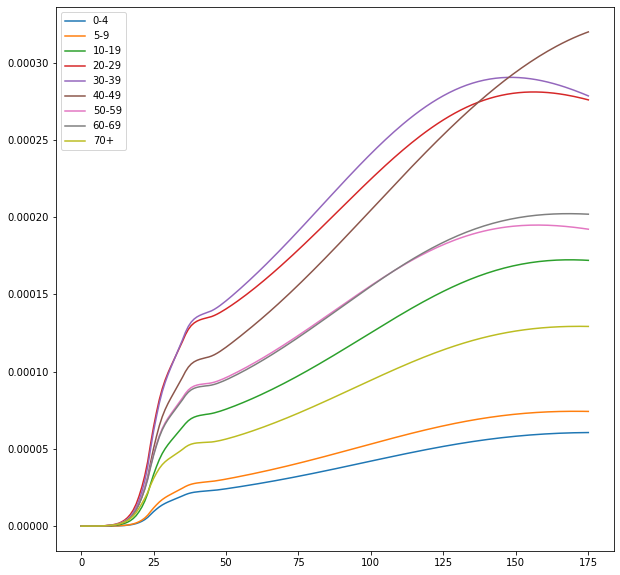

(<Figure size 720x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x4cc2c50>)

In [4]:
mdl.plot_I_by_age(res_mdl)

In [5]:
res_mdl['new_Is'].sum()

0.014201607353994087

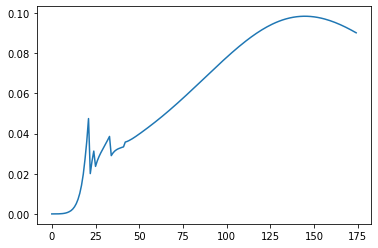

In [6]:
plt.plot((res_mdl['L'].sum(axis=1)))

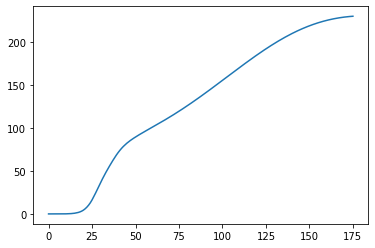

In [7]:
plt.plot((res_mdl['H'].sum(axis=1))*9136000)

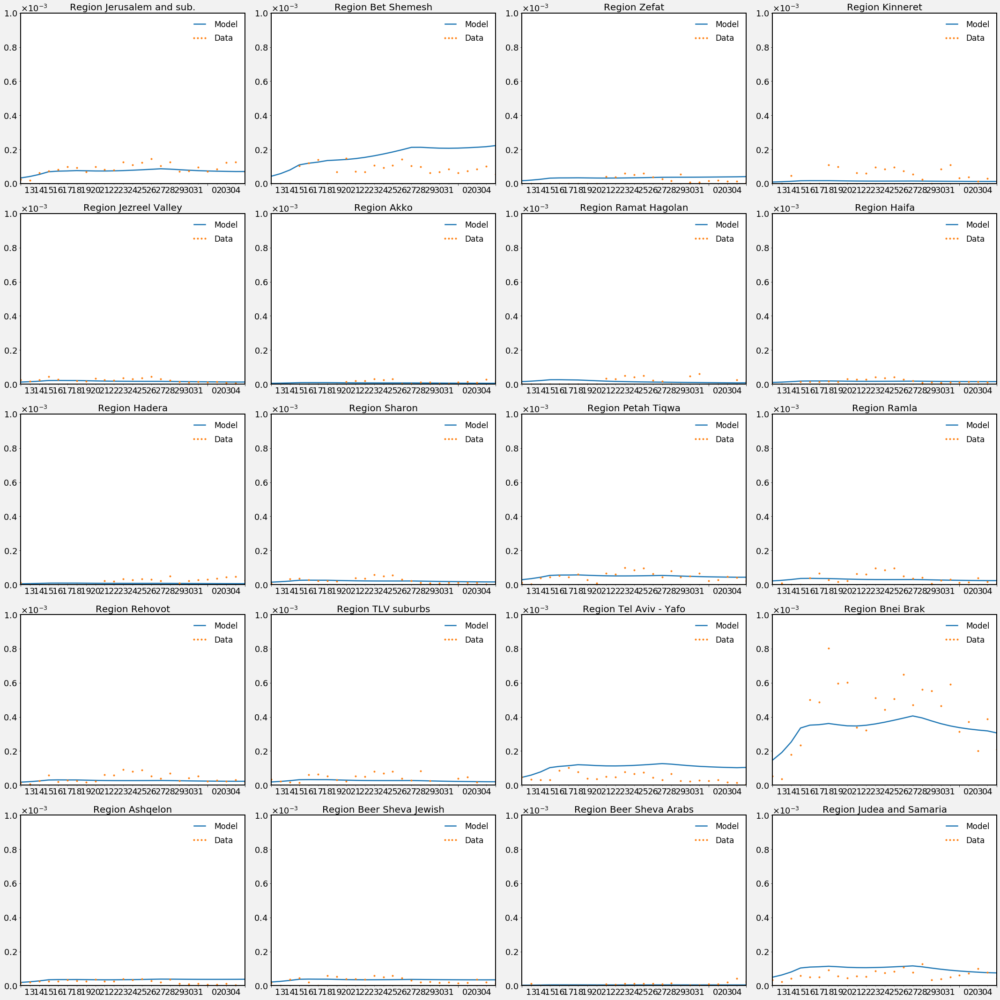

In [9]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=data.values, mdl_data = res_mdl['new_Is'],date_list = date_lst,
                                         start='2020-03-12',end='2020-04-05')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1434480fa20>)

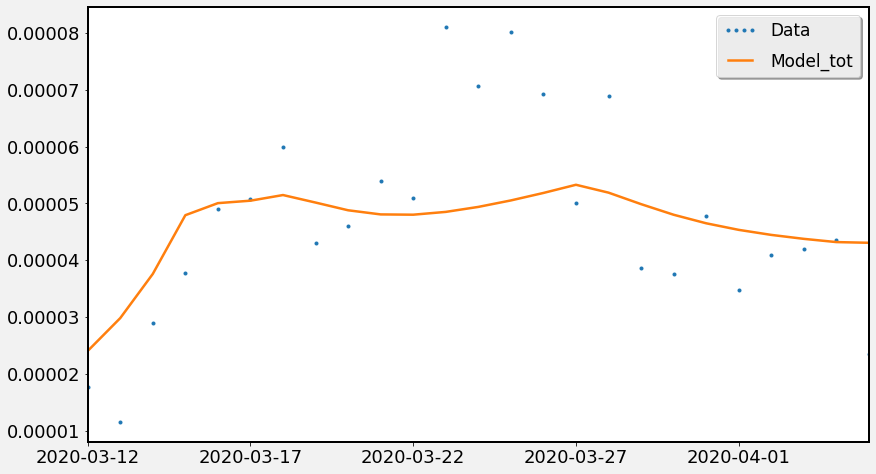

In [10]:
mdl.plot_calibrated_total_model(data=data, mdl_data=res_mdl, date_list=date_lst, 
                            start='2020-03-12', end='2020-04-05')

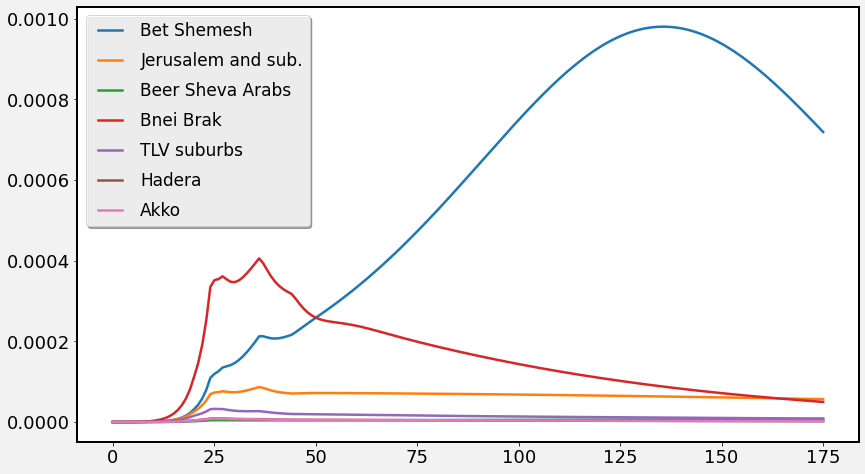

In [19]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.region_name[region]] = (res_mdl['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

In [15]:
res_mdl['new_Is'].sum()

0.015901764064386696

In [ ]:
ven_proba = pd.read_csv('Data/vent_proba.csv')
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.region_name[region]] = (res_mdl['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

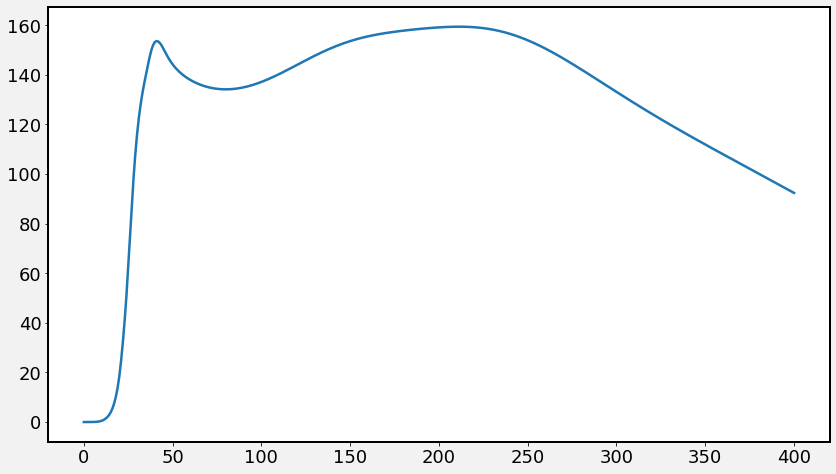

In [14]:
plt.plot((res_mdl['H'].sum(axis=1))*9136000)

In [16]:
(res_mdl['H'].sum(axis=1))[56]*9136000

139.85616268520099

In [17]:
((res_mdl['Is'][:, mdl.age_dict['70+']].sum(axis=1))[56]+(res_mdl['Is'][:, mdl.age_dict['60-69']].sum(axis=1))[56])/(res_mdl['Is'][:].sum(axis=1))[56]

0.19352028004453542

In [18]:
(res_mdl['R'].sum(axis=1))[56]*9136000*0.3

8920.626073952297

### Data with variance

In [19]:
start_idx = int(np.where(date_lst == '2020-03-12')[0])
end_idx = int(np.where(date_lst == '2020-04-05')[0])

In [26]:
model_by_age_region = {}
for i, key in enumerate(mdl.region_age_dict.keys()):
    model_by_age_region[key[0] + '_' + key[1] + '_mdl'] = res_mdl['new_Is'][start_idx:end_idx+1, mdl.region_age_dict[key]].sum(axis=1)
model_by_age_region = pd.DataFrame.from_dict(model_by_age_region)

In [27]:
# Calculating model variance:
std = np.sqrt((np.power(data.values - model_by_age_region.values,2).sum())/(data.values.size - 1))

In [28]:
std

2.542541093307999e-07

### Upper bound calibration

In [ ]:
# minimized value: -25.112767900678186
# Fitted parameters:
#  Beta=[0.03030602 0.05262323 0.06149524 0.2050433 ]
#  Theta=2.328913039368483,
#  Beta_behave=0.5297713948054046
# num of sampling the target function: 173

In [29]:
# Calculating data with adding std
ub_data = data + 2*std

In [3]:
# fit params
days_in_season_ub=70
alpha_ub=1
date_lst = pd.date_range('2020-02-20','2020-04-13')

In [31]:
# Model Fitting
p0=(0.06862921,0.07089788,0.08567678,0.3,1.5103006972556037, 0.4293725726208387) # initial guess
bnds = ((0,0.1),(0,0.15),(0,0.15),(0,0.6),(1,3),(0,1))# boundries for variables
# errorfunc(tpl,data,f,season_length, eps, alpha)
res_fit_ub= optimize.minimize(mdl.errorfunc_by_sector_behavior,p0,bounds=bnds,method='TNC',args=(ub_data.values,mdl.f0_full['Scenario2'],
                                                                           days_in_season_ub,mdl.eps_sector['Scenario2'],alpha_ub,date_lst,
                                                                                    '2020-03-12-','2020-04-05')
                           ,options={'maxiter':1000})

fitted_params_ub = res_fit_ub.x

# run the fitted model:
fitted_beta_ub = np.array([fitted_params_ub[0], fitted_params_ub[0], fitted_params_ub[0], fitted_params_ub[1], fitted_params_ub[1],\
                        fitted_params_ub[2], fitted_params_ub[2], fitted_params_ub[3], fitted_params_ub[3]])
theta_ub = fitted_params_ub[4]
beta_behave_ub = fitted_params_ub[5]
                        
# print data stat
mdl.print_stat_fit_behave(res_fit_ub)

minimized value: -24.050377053060725
Fitted parameters:
 Beta=[0.06872524 0.07058089 0.0849962  0.35823708]
 Theta=1.5147969877267358,
 Beta_behave=0.4195811609779443
num of sampling the target function: 156


In [4]:
# best fit results:
beta_j_ub=np.array([0.06872524,0.06872524,0.06872524,0.07058089,0.07058089,0.0849962,0.0849962,0.35823708,0.35823708])
theta_ub=1.5147969877267358
beta_behave_ub=0.4195811609779443

In [5]:
res_mdl_ub = mdl.run_sector_model_behavior(beta_home=0.38/9., theta=theta_ub, beta_j=beta_j_ub, beta_behave=beta_behave_ub,
                                        eps=mdl.eps_sector['Scenario2'], f=mdl.f0_full['Scenario2'], alpha=alpha_ub, 
                                        days_in_season=175,new=1./10.)

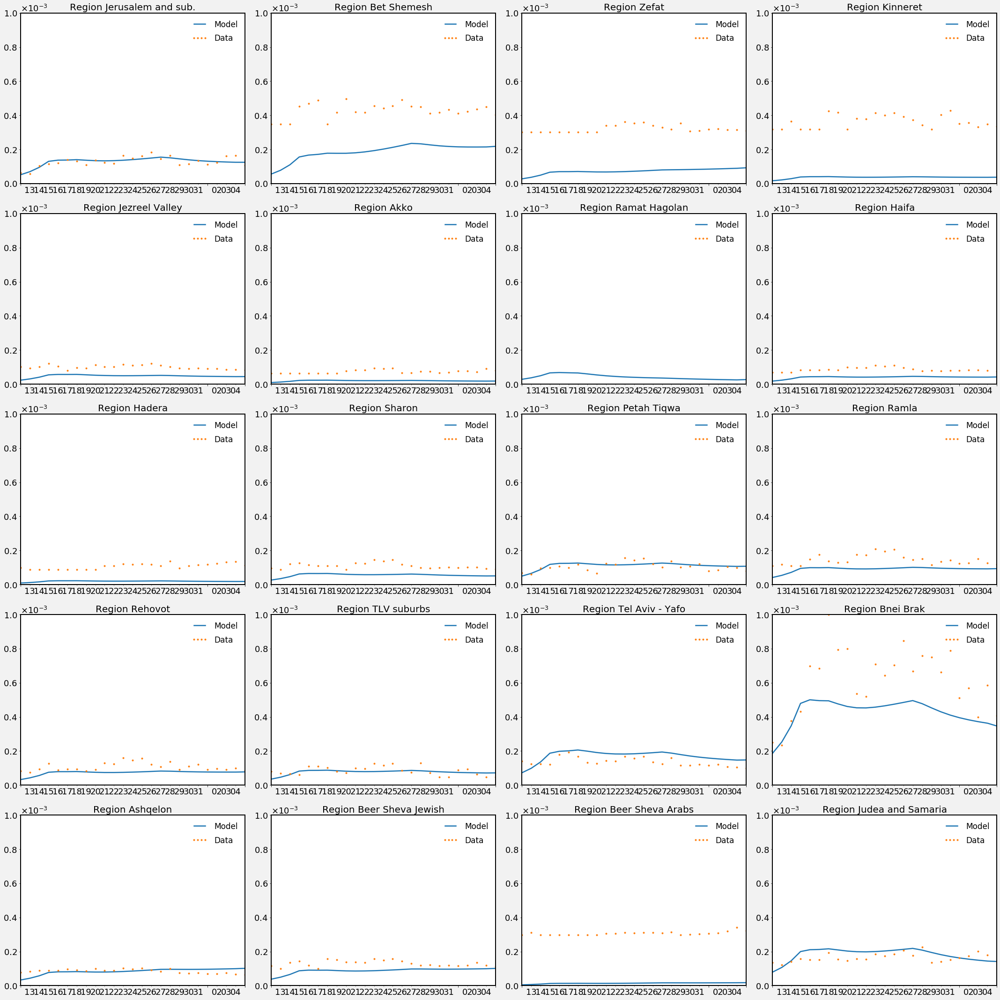

In [33]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=ub_data.values, mdl_data = res_mdl_ub['new_Is'],date_list = date_lst,
                                         start='2020-03-12',end='2020-04-05')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

In [11]:
mdl.plot_calibrated_total_model(data=ub_data, mdl_data=res_mdl_ub, date_list=date_lst, 
                            start='2020-03-12', end='2020-04-05')

NameError: name 'ub_data' is not defined

In [35]:
res_mdl_ub['new_Is'].sum()

0.04792615860434173

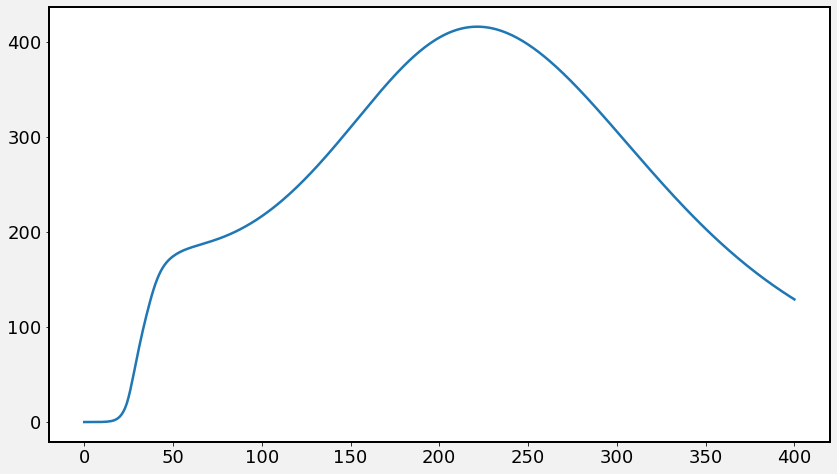

In [6]:
plt.plot((res_mdl_ub['H'].sum(axis=1))*9136000)

### Lower bound

In [47]:
# Calculating data with adding std
lb_data = data*0.5

In [3]:
# fit params
days_in_season_lb=70
alpha_lb=1
date_lst = pd.date_range('2020-02-20','2020-04-13')

In [48]:
# Model Fitting
p0=(0.06862921,0.07089788,0.08567678,0.3,1.5103006972556037, 0.4293725726208387) # initial guess
bnds = ((0,0.1),(0,0.15),(0,0.15),(0,0.6),(1,3),(0,1))# boundries for variables
# errorfunc(tpl,data,f,season_length, eps, alpha)
res_fit_lb= optimize.minimize(mdl.errorfunc_by_sector_behavior,p0,bounds=bnds,method='TNC',args=(lb_data.values,mdl.f0_full['Scenario2'],
                                                                           days_in_season_ub,mdl.eps_sector['Scenario2'],alpha_ub,date_lst,
                                                                                    '2020-03-12-','2020-04-05')
                           ,options={'maxiter':1000})

fitted_params_lb = res_fit_lb.x

# run the fitted model:
fitted_beta_lb = np.array([fitted_params_lb[0], fitted_params_lb[0], fitted_params_lb[0], fitted_params_lb[1], fitted_params_lb[1],\
                        fitted_params_lb[2], fitted_params_lb[2], fitted_params_lb[3], fitted_params_lb[3]])
theta_lb = fitted_params_lb[4]
beta_behave_lb = fitted_params_lb[5]
                        
# print data stat
mdl.print_stat_fit_behave(res_fit_lb)

minimized value: -26.594874666871632
Fitted parameters:
 Beta=[0.01684003 0.03004164 0.03680587 0.11561031]
 Theta=3.0,
 Beta_behave=0.8029761250996457
num of sampling the target function: 426


In [4]:
# best fit results:
beta_j_lb=np.array([0.01684003,0.01684003,0.01684003,0.03004164,0.03004164,0.03680587,0.03680587,0.11561031,0.11561031])
theta_lb=3.0
beta_behave_lb=0.8029761250996457

In [5]:
res_mdl_lb = mdl.run_sector_model_behavior(beta_home=0.38/9., theta=theta_lb, beta_j=beta_j_lb, beta_behave=beta_behave_lb,
                                        eps=mdl.eps_sector['Scenario2'], f=mdl.f0_full['Scenario2'], alpha=alpha_lb, 
                                        days_in_season=175,new=1./10.)

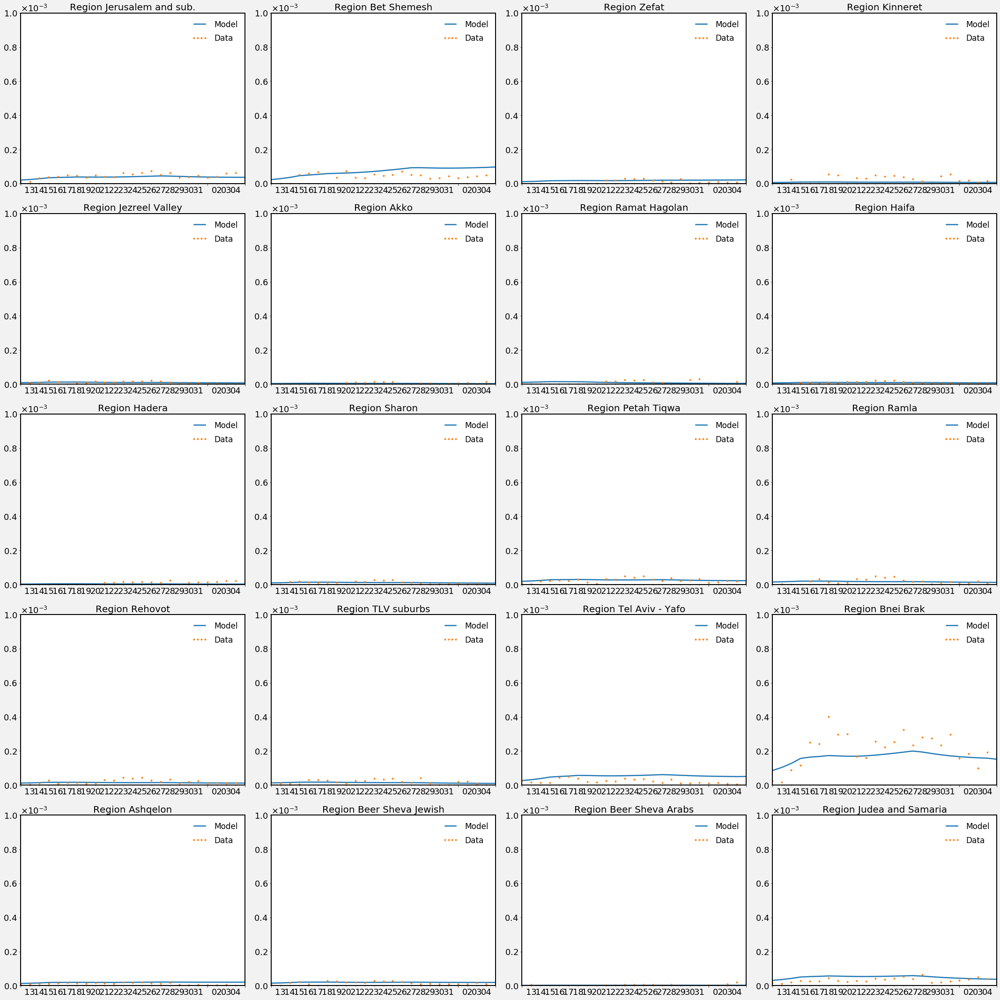

In [50]:
# plotting the data and model
fig,ax = mdl.plot_calibrated_model_region(data=lb_data.values, mdl_data = res_mdl_lb['new_Is'],date_list = date_lst,
                                         start='2020-03-12',end='2020-04-05')
fig.set_size_inches((30,30))
plt.tight_layout()
plt.show()

(<Figure size 1008x576 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1434be59f28>)

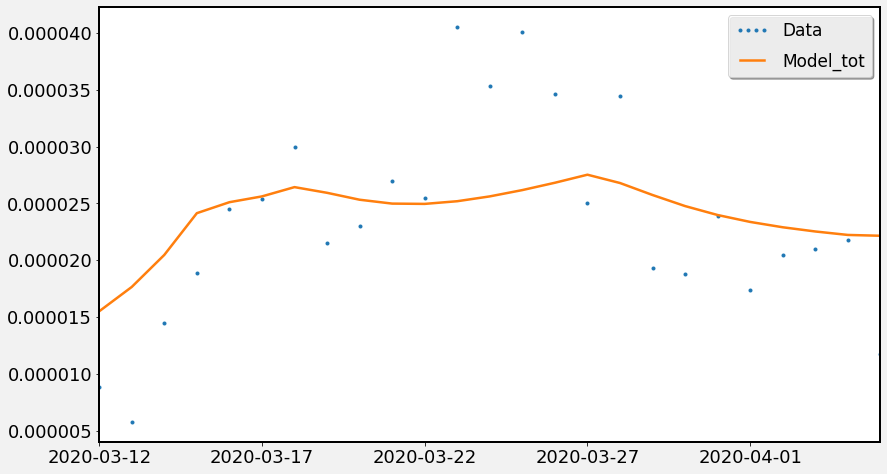

In [51]:
mdl.plot_calibrated_total_model(data=lb_data, mdl_data=res_mdl_lb, date_list=date_lst, 
                            start='2020-03-12', end='2020-04-05')

In [35]:
res_mdl_ub['new_Is'].sum()

0.04792615860434173

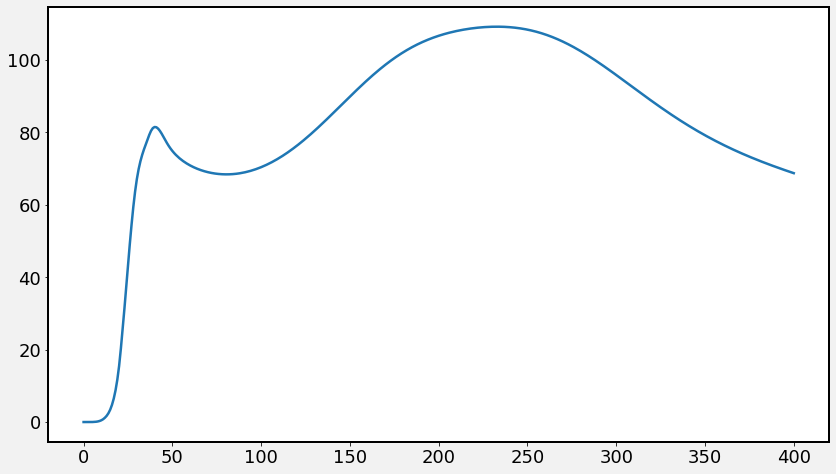

In [16]:
plt.plot((res_mdl_lb['H'].sum(axis=1))*9136000)

# 60+ in Quarantine

In [6]:
inter_age = mdl.get_opposite_dict(mdl.N,list(itertools.product(mdl.M.values(), mdl.A.values())))

In [7]:
inter_age.keys()

dict_keys([('Intervention', '0-4'), ('Intervention', '5-9'), ('Intervention', '10-19'), ('Intervention', '20-29'), ('Intervention', '30-39'), ('Intervention', '40-49'), ('Intervention', '50-59'), ('Intervention', '60-69'), ('Intervention', '70+'), ('Non-intervention', '0-4'), ('Non-intervention', '5-9'), ('Non-intervention', '10-19'), ('Non-intervention', '20-29'), ('Non-intervention', '30-39'), ('Non-intervention', '40-49'), ('Non-intervention', '50-59'), ('Non-intervention', '60-69'), ('Non-intervention', '70+')])

In [7]:
# age_lst = ['0-4']
age_lst = ['0-4','5-9','10-19','20-29','30-39','40-49','50-59']

In [8]:
# new S
init_pop = res_mdl_lb['S'][56,:].copy()
for age in mdl.A.values():
#     if age not in ['60-69','70+']:
    if age  in age_lst:
        init_pop[inter_age['Intervention',age]] = init_pop[inter_age['Non-intervention',age]]
        init_pop[inter_age['Non-intervention',age]] = 0

In [9]:
# new E
init_E = res_mdl_lb['E'][56,:].copy()
for age in mdl.A.values():
#     if age not in ['60-69','70+']:
    if age  in age_lst:
        init_E[inter_age['Intervention',age]] = init_E[inter_age['Non-intervention',age]]
        init_E[inter_age['Non-intervention',age]] = 0

In [10]:
# new Ie
init_Ie = res_mdl_lb['Ie'][56,:].copy()
for age in mdl.A.values():
#     if age not in ['60-69','70+']:
    if age  in age_lst:
        init_Ie[inter_age['Intervention',age]] = init_Ie[inter_age['Non-intervention',age]]
        init_Ie[inter_age['Non-intervention',age]] = 0

In [11]:
#new Is
init_Is = res_mdl_lb['Is'][56,:].copy()
for age in mdl.A.values():
#     if age not in ['60-69','70+']:
    if age  in age_lst:
        init_Is[inter_age['Intervention',age]] = init_Is[inter_age['Non-intervention',age]]
        init_Is[inter_age['Non-intervention',age]] = 0

In [12]:
#new Ia
init_Ia = res_mdl_lb['Ia'][56,:].copy()
for age in mdl.A.values():
#     if age not in ['60-69','70+']:
    if age  in age_lst:
        init_Ia[inter_age['Intervention',age]] = init_Ia[inter_age['Non-intervention',age]]
        init_Ia[inter_age['Non-intervention',age]] = 0

In [13]:
with open('Data/parameters/C_quarantine_60_70.pickle', 'rb') as pickle_in:
    C = pickle.load(pickle_in)

In [14]:
res_mdl_60_70 = mdl.continue_run_sector_model_behavior(model_res=res_mdl_lb,t_start=56,intervention=True,C=C,
                                  beta_home=0.38/9., theta=1.0, beta_j=beta_j_lb, beta_behave=beta_behave_lb,
                                        eps=mdl.eps_sector['Scenario2'], f=mdl.f0_full['Scenario2'], alpha=alpha_lb, 
                                        days_in_season=120, new=1/10., new_pop_dist=init_pop, new_E=init_E, new_I_e=init_Ie,
                                                      new_I_s=init_Is, new_I_a=init_Ia)

In [15]:
res_mdl_60_70['new_Is'].sum()

0.3216035651029858

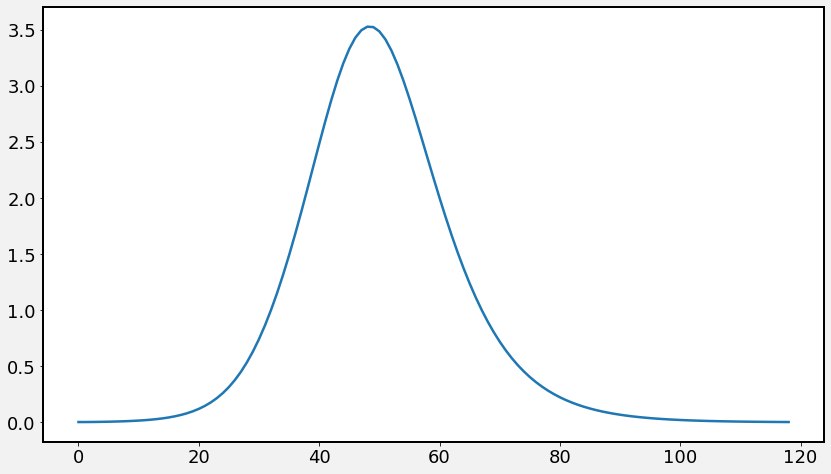

In [24]:
plt.plot(res_mdl_60_70['L'][:,mdl.age_ga_dict['50-59']].sum(axis=1))

In [46]:
res_mdl_60_70['L'][:,mdl.age_ga_dict['70+']].sum(axis=0)

array([2.7822938057688567, 10.090682276505333, 2.3630754192621497,
       2.0758851984796114, 2.022659989724443, 2.1463613489194797,
       1.9562127270101466, 1.0547903837229198, 1.9094703818715446,
       1.480017136347956, 1.6545384143004904, 1.945172818461262,
       1.3708231864985674, 0.9558232479351321, 0.6031561584801624,
       11.05951949352481, 1.678195159857887, 1.618420243526544,
       10.338985332775621, 6.650471081271031], dtype=object)

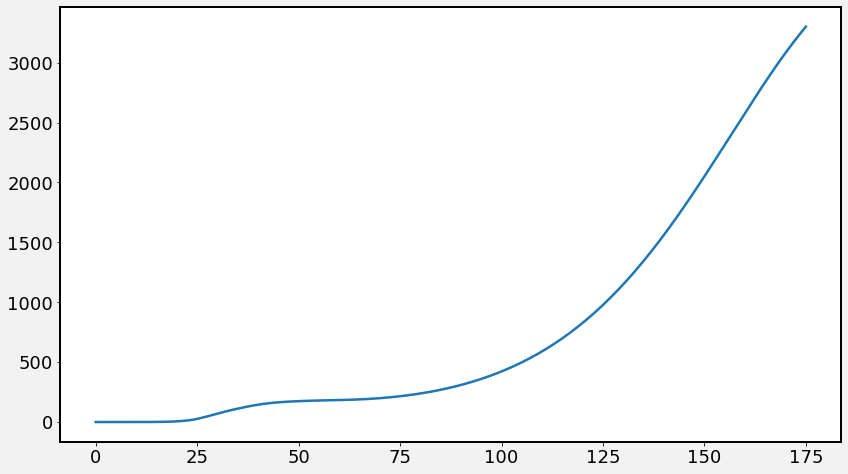

In [15]:
plt.plot((res_mdl_60_70['H'].sum(axis=1)[:])*9136000)

In [16]:
# Save
with open('Data/parameters/low_60_70.pickle', 'wb') as handle:
    pickle.dump(res_mdl_60_70, handle, protocol=pickle.HIGHEST_PROTOCOL)

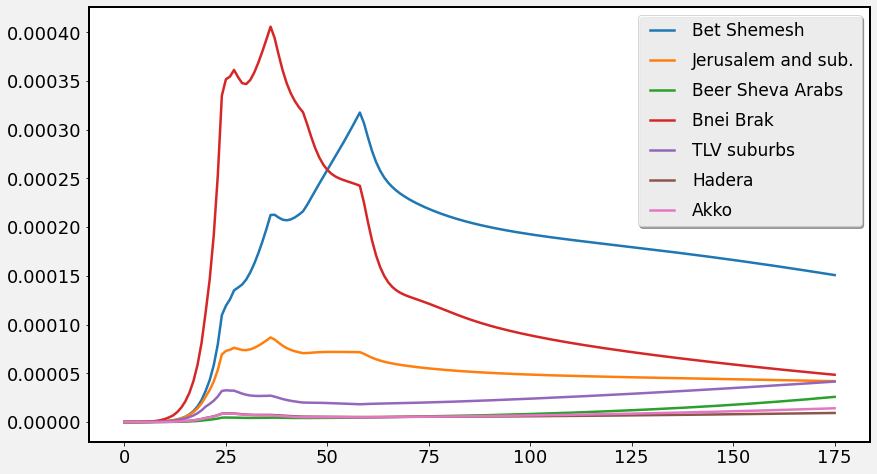

In [18]:
# Creating table 1, by region:
tabel_1_dict = {}
for region in ['11_betshemesh','11','62_arab','51_bb','51','32','24']:
    tabel_1_dict[mdl.region_name[region]] = (res_mdl_60_70['new_Is'][:, mdl.region_dict[region]].sum(axis=1))/mdl.population_size[mdl.region_dict[region]].sum()
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

tabel1_df.iloc[:].plot()

# Data for dashboard

In [27]:
with open('Data/parameters/low_60_70.pickle', 'rb') as pickle_in:
    res_low = pickle.load(pickle_in)

with open('Data/parameters/high_60_70.pickle', 'rb') as pickle_in:
    res_high = pickle.load(pickle_in)
    
with open('Data/parameters/normal_60_70.pickle', 'rb') as pickle_in:
    res_normal = pickle.load(pickle_in)

In [28]:
date_rang = pd.date_range('2020-02-20', periods=176, freq='d')

In [29]:
age_dist_area = pd.read_csv('../Data/demograph/age_dist_area.csv',index_col=0).iloc[0:20][['0-4', '5-9', '10-19', '20-29', '30-39', '40-49', '50-59', '60-69', '70+']].copy()
age_dist_area = age_dist_area.sum(axis=1)

In [30]:
tot_I = res_normal['Is'] + res_normal['Ia']
tot_I_ub = res_high['Is'] + res_high['Ia']
tot_I_lb = res_low['Is'] + res_low['Ia']

In [31]:
# tabel 1, coloring the map
# Creating table 1, by region:
tabel_1_dict = {}
tabel_1_dict['date'] = date_rang
for region in mdl.region_dict.keys():
    tabel_1_dict[mdl.region_name[region]] = (tot_I[:, mdl.region_dict[region]].sum(axis=1))/age_dist_area[region]
tabel1_df = pd.DataFrame.from_dict(tabel_1_dict)

In [32]:
# 'daysoffset' will container the weekday, as integers
tabel1_df['daysoffset'] = tabel1_df['date'].apply(lambda x: x.weekday())
# We apply, row by row (axis=1) a timedelta operation
tabel1_df['week_start'] = tabel1_df.apply(lambda x: x['date'] - dt.timedelta(days=x['daysoffset']), axis=1)

In [33]:
tab1_groupped = tabel1_df.groupby('week_start')[list(mdl.region_name.values())]
tab1_groupped = tab1_groupped.apply(lambda x: (x.max() + x.min())/2)

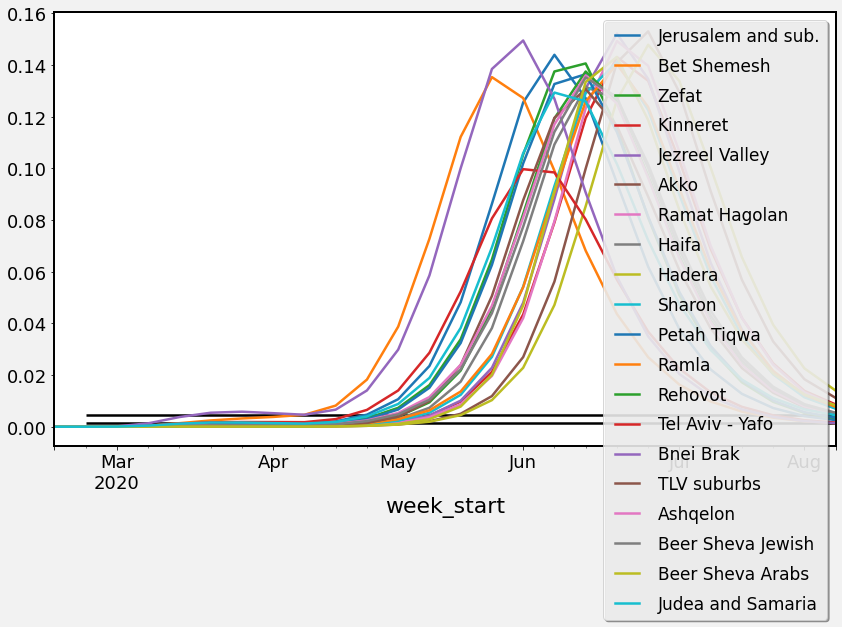

In [34]:
tab1_groupped[list(mdl.region_name.values())].plot()
plt.hlines(xmin='2020-02-20',xmax='2020-09-30', y=0.0045)
plt.hlines(xmin='2020-02-20',xmax='2020-09-30', y=0.0013)

In [35]:
tab1_groupped.loc['2020-04-17':'2020-06-17'].stack()

week_start                    
2020-04-20  Jerusalem and sub.    0.002043
            Bet Shemesh           0.008170
            Zefat                 0.001444
            Kinneret              0.000369
            Jezreel Valley        0.000326
                                    ...   
2020-06-15  TLV suburbs           0.130734
            Ashqelon              0.135986
            Beer Sheva Jewish     0.135187
            Beer Sheva Arabs      0.133438
            Judea and Samaria     0.125941
Length: 180, dtype: float64

In [36]:
# Saving table_1:
tab1_groupped.loc['2020-04-17':'2020-06-17'].stack().to_csv('Incidence_per_region_60_70.csv')

In [35]:
# Age groups

In [37]:
tabel_2 = pd.DataFrame(index = pd.MultiIndex.from_tuples(itertools.product(date_rang, mdl.A.values()),names=['date','age']), 
                                     columns=['mean','UB','LB'])

In [38]:
# fill the matrix:
for index in list(tabel_2.index):
#     print(int(np.where(date_rang == index[0])[0]))
    tabel_2.loc[index,'mean'] = tot_I[int(np.where(date_rang == index[0])[0]),mdl.age_dict[index[1]]].sum()
    tabel_2.loc[index,'UB'] = tot_I_ub[int(np.where(date_rang == index[0])[0]),mdl.age_dict[index[1]]].sum()
    tabel_2.loc[index,'LB'] = tot_I_lb[int(np.where(date_rang == index[0])[0]),mdl.age_dict[index[1]]].sum()

In [39]:
# 'daysoffset' will container the weekday, as integers
tabel_2['daysoffset'] = tabel_2.apply(lambda x: x.name[0].weekday(),axis=1)
# We apply, row by row (axis=1) a timedelta operation
tabel_2['week_start'] = tabel_2.apply(lambda x: x.name[0] - dt.timedelta(days=x['daysoffset']), axis=1)

In [40]:
tabel_2.reset_index(inplace=True)

In [41]:
tabel_2_groupped = tabel_2.groupby(['week_start','age'])[['mean','UB','LB']]
tabel_2_groupped = tabel_2_groupped.apply(lambda x: (x.max() + x.min())/2) * 9136000

In [42]:
tabel_2_groupped['mean'] = tabel_2_groupped['mean'].apply(np.ceil)
tabel_2_groupped['UB'] = tabel_2_groupped['UB'].apply(np.ceil)
tabel_2_groupped['LB'] = tabel_2_groupped['LB'].apply(np.ceil)

In [43]:
tabel_2_groupped.reset_index(inplace=True)